In [1]:
# %load defaults.ipy
from numpy import *
import matplotlib
matplotlib.rcParams['savefig.dpi'] = 600
%matplotlib inline

import matplotlib.pyplot as plt

import sys
import os
import os.path
sys.path.append('../python')
import plot_info
from plot_info import showAndSave
import netCDF4
from IPython.core.display import display, HTML
import matplotlib2tikz
import copy
import json

with open('structure_function_configs.json') as f:
    configurations = json.load(f)

def for_each_config(f):
    oldPrefix = copy.deepcopy(showAndSave.prefix)
    for conf in configurations.keys():
        
        plot_info.console_log(conf)
        headline(configurations[conf]['name'])
        showAndSave.prefix = oldPrefix + conf
        try:
            f(configurations[conf])
        except Exception as e:
            plot_info.console_log("Skipping {fname} on {conf} ({confname})\n\tReason: {reason}".format(fname=str(f),
                                                                                                       conf=conf, 
                                                                                                       confname=configurations[conf]['name'],
                                                                                                       reason=str(e)))
    showAndSave.prefix=oldPrefix

plot_info.set_notebook_name("StructureAlsvinn.ipynb")

print("STATISTICAL_STRUCTURE={}".format(plot_info.get_environment("STATISTICAL_STRUCTURE", [])))

STATISTICAL_STRUCTURE=/cluster/project/sam/klye/systemspaperdata/


In [2]:
def headline(text):
    display(HTML("<h1>%s</h1>"%text))
def h2(text):
    display(HTML("<h2>%s</h2>"%text))
def h3(text):
    display(HTML("<h3>%s</h3>"%text))
def h4(text):
    display(HTML("<h4>%s</h4>"%text))
def h5(text):
    display(HTML("<h4>%s</h4>"%text))

In [3]:
def readnetcdf4(filename, variable):
    basepath = plot_info.get_environment("STATISTICAL_STRUCTURE", [filename])
    with netCDF4.Dataset(os.path.join(basepath, filename)) as f:
        return f.variables[variable][:,0,0]

def upscale(d, r):

    while d.shape[0] < r:
       
        d = repeat(d,2,0)
    return d

def plotscalings_perturbation(d,pert, title,plot_nonlog=True,name=''):
    N = len(d)
    H = linspace(0, 64./2048,N)
   
    poly = polyfit(log(H[1:]),log(d[1:]),1)
  
  
        
    fig = plt.figure(0,figsize=2*plt.figaspect(0.9))
    plt.title(title)
    ax = plt.gca()
    ax.loglog(H[1:],d[1:],label='%s $\\epsilon=%.4f$'%(name, pert))
    ax.loglog(H[1:], exp(poly[1])*H[1:]**(poly[0]), '--',label='$\\mathcal{O}(h^{%.2f})$' % poly[0])
    box = ax.get_position()
    #ax.set_position([box.x0, box.y0 + box.height * 0.1,
    #                 box.width, box.height * 0.9])
    #
    ## Put a legend below current axis
    #ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
    #      fancybox=True, shadow=True, ncol=5)
    ax.legend(loc='center right', bbox_to_anchor=(1, 0.5))
    ax.grid('on')



def plotscalings(d,r,title,plot_nonlog=True):
    N = len(d)
    H = linspace(0, 64./2048,N)
   
    poly = polyfit(log(H[1:]),log(d[1:]),1)
    if plot_nonlog:
        fig = plt.figure(0, figsize=2*plt.figaspect(0.5))
        fig.suptitle(title)
        ax = fig.add_subplot(1,2,1)
        
        ax.plot(H,d,label='r=%d'%r)
        ax.plot(H, exp(poly[1])*H**(poly[0]), '--',label='$\\mathcal{O}(h^{%.2f})$' % poly[0])
        ax.grid('on')
        box = ax.get_position()
        ax.set_position([box.x0, box.y0 + box.height * 0.1,
                         box.width, box.height * 0.9])
        
        # Put a legend below current axis
        #ax.legend(pos='upper center', bbox_to_anchor=(0.5, -0.05),
        #     fancybox=True, shadow=True, ncol=5)
        
        ax.legend(bbox_to_anchor=(0.5, -0.05),
             fancybox=True, shadow=True, ncol=5)
        
    
          

        ax = fig.add_subplot(1,2,2)
    else:
        
        fig = plt.figure(0,figsize=2*plt.figaspect(0.9))
        plt.title(title)
        ax = plt.gca()
    ax.loglog(H[1:],d[1:],label='$N=%d$'%r)
    ax.loglog(H[1:], exp(poly[1])*H[1:]**(poly[0]), '--',label='$\\mathcal{O}(h^{%.2f})$' % poly[0])
    box = ax.get_position()
    #ax.set_position([box.x0, box.y0 + box.height * 0.1,
    #                 box.width, box.height * 0.9])
    #
    ## Put a legend below current axis
    #ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
    #      fancybox=True, shadow=True, ncol=5)
    ax.legend(loc='center right', bbox_to_anchor=(1, 0.5))
    ax.grid('on')




def getlineintegral(filename, variable,resolution):
    d = readnetcdf4(filename, variable)
    dx = 1.0/resolution
    
    for h in range(1,len(d)):
        d[h] += d[h-1]
    for h in range(1,len(d)):
        d[h] /=(2*h+1)**2
        #d[h] /= 4*(2*h+1)
        
    return d
    

# Mean and variance

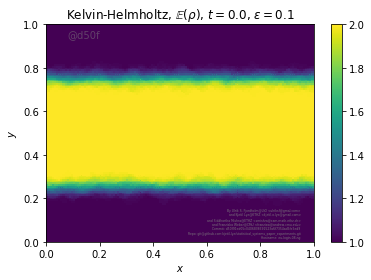

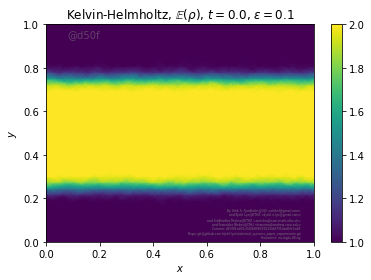

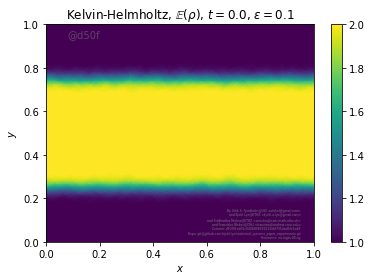

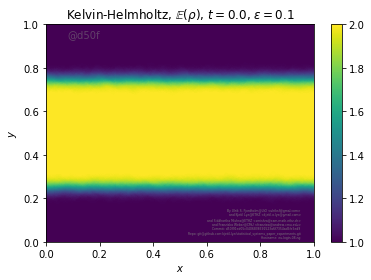

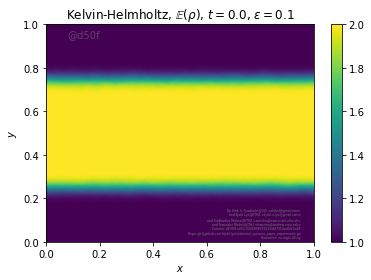

[0.01389087 0.00899896 0.00613367 0.00409449]


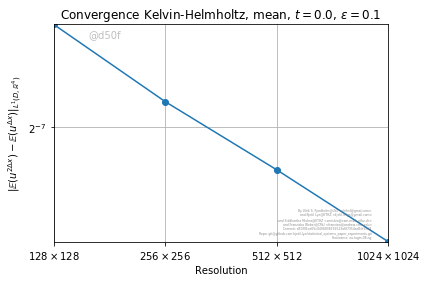

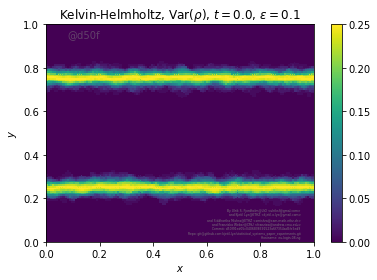

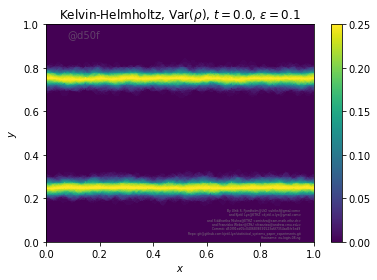

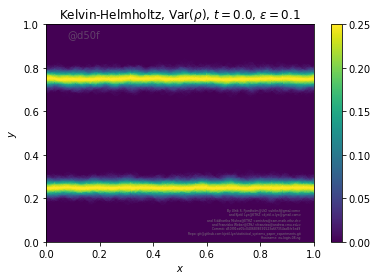

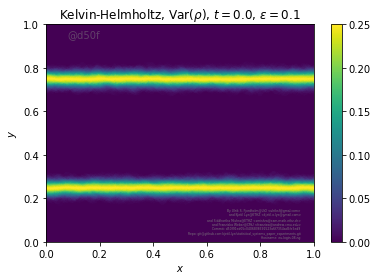

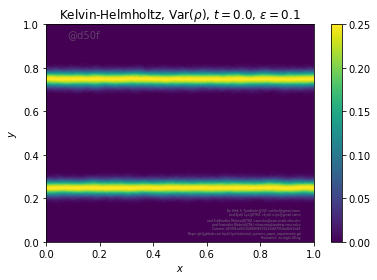

[0.00943069 0.00614611 0.00411095 0.00279859]


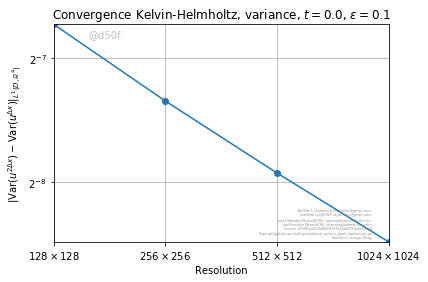

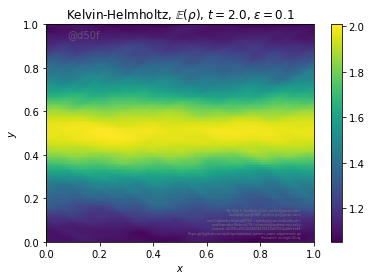

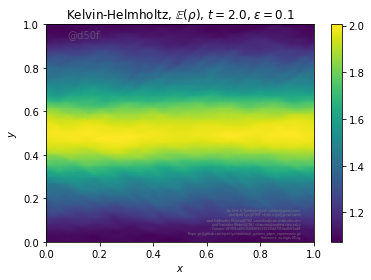

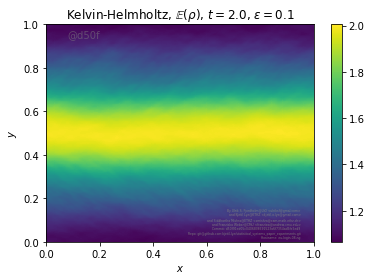

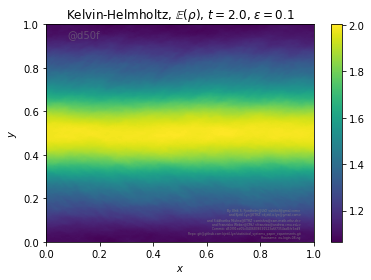

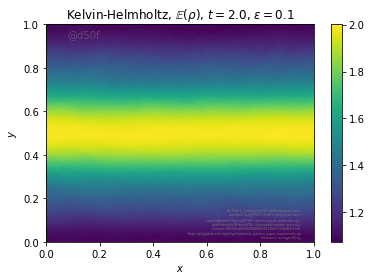

[0.08395572 0.04363692 0.03571335 0.03307321]


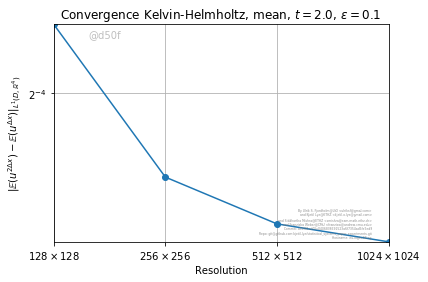

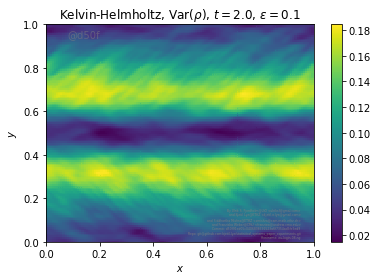

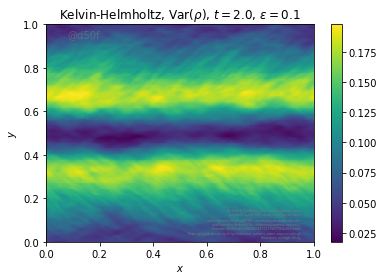

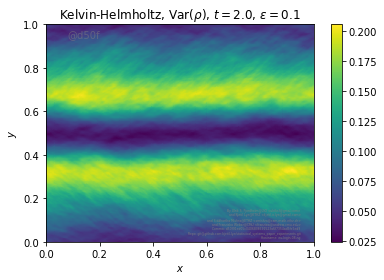

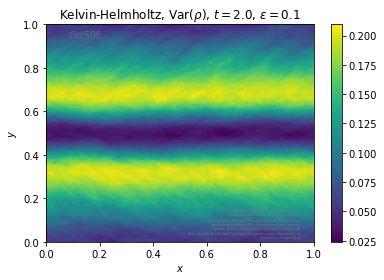

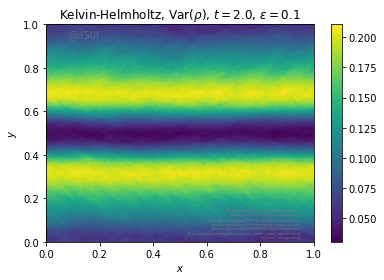

[0.05558443 0.03581982 0.02803874 0.0229946 ]


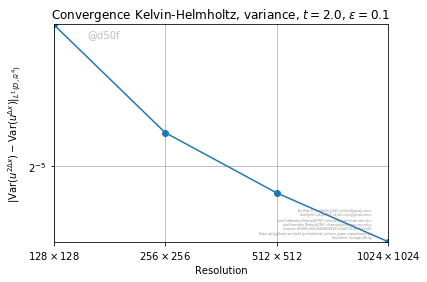

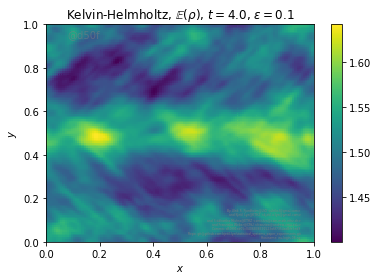

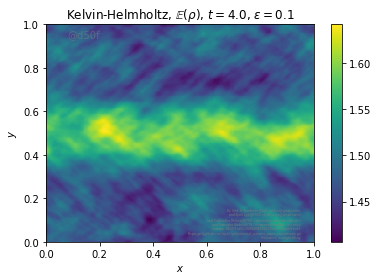

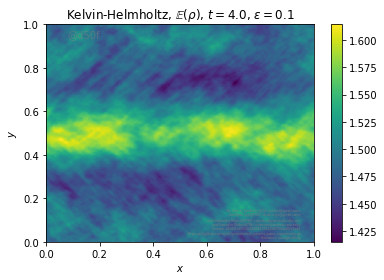

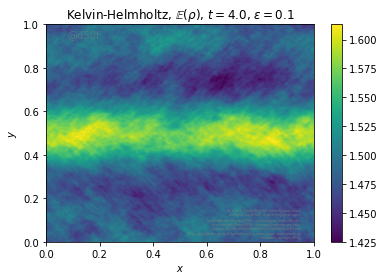

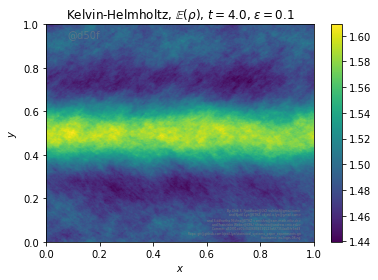

[0.11602194 0.06685322 0.04454328 0.03210294]


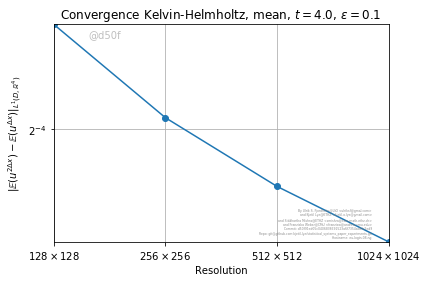

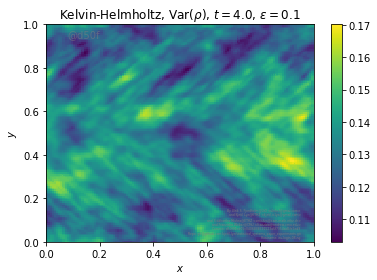

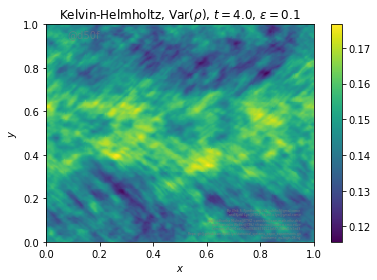

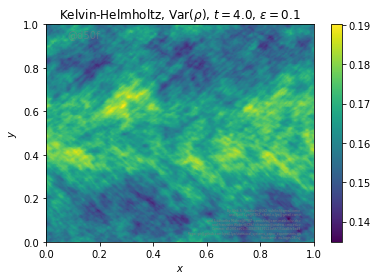

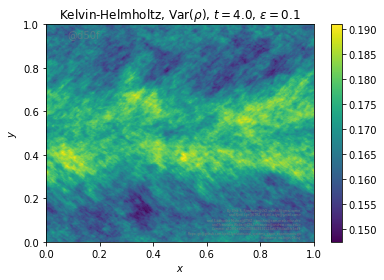

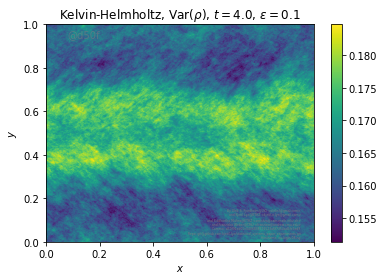

[0.07781854 0.06198207 0.03864326 0.02991175]


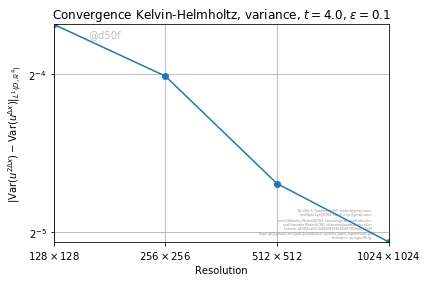

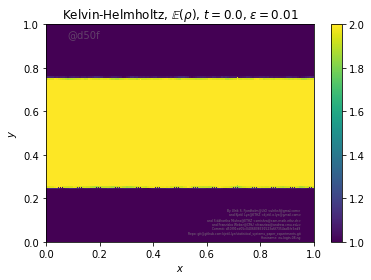

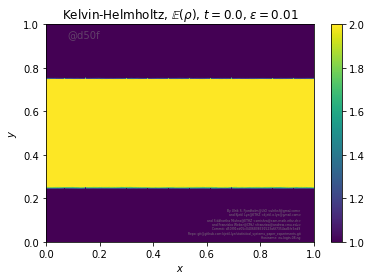

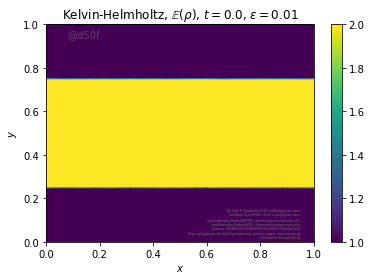

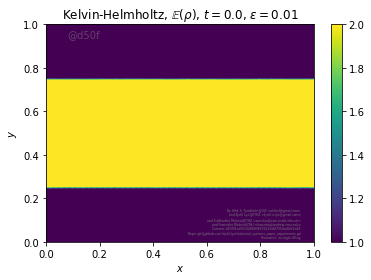

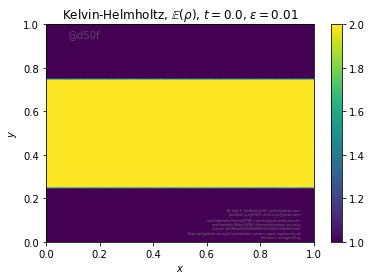

[0.00901081 0.00512883 0.00256245 0.00129388]


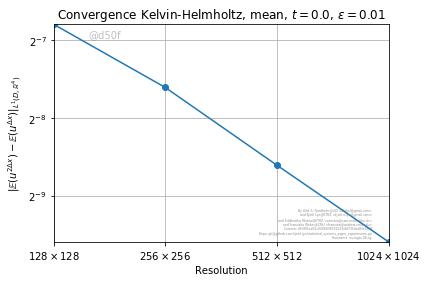

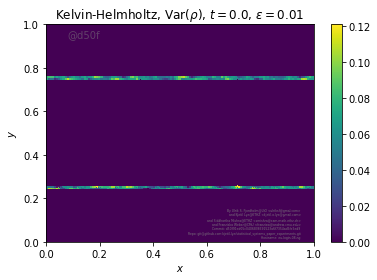

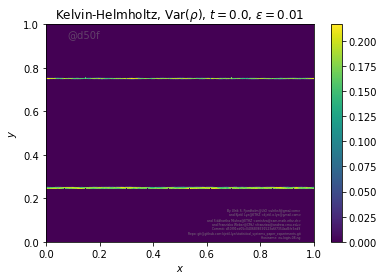

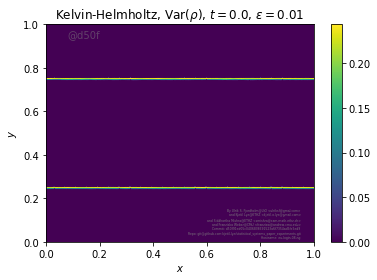

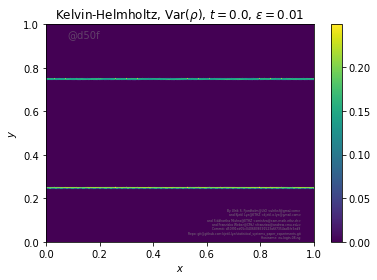

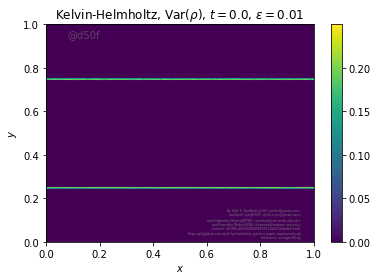

[0.00850155 0.00355981 0.00163244 0.00081559]


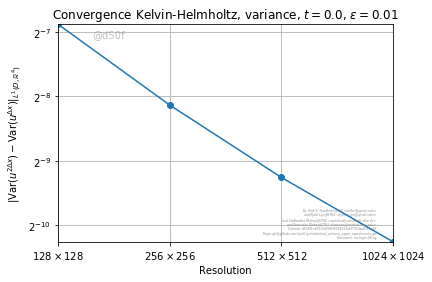

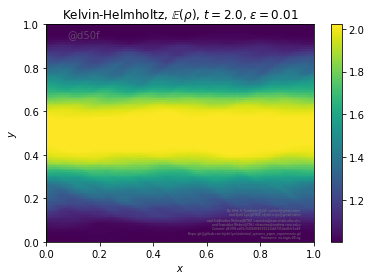

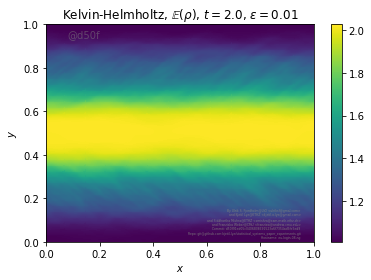

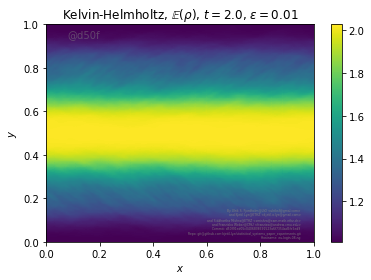

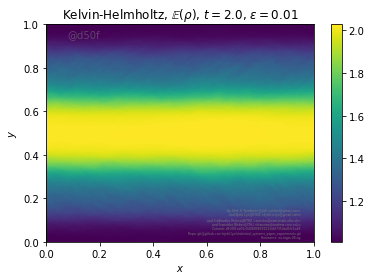

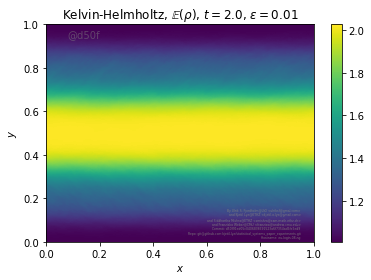

[0.08989209 0.04979644 0.03668484 0.03052329]


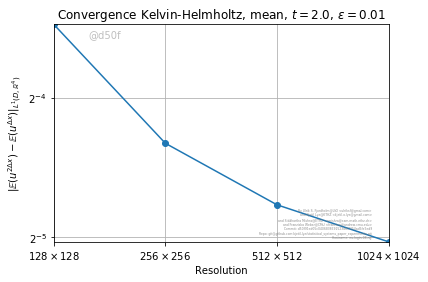

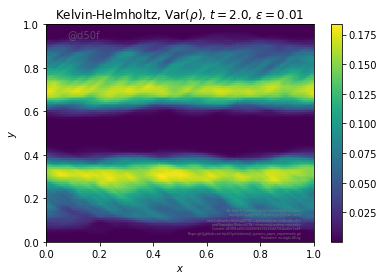

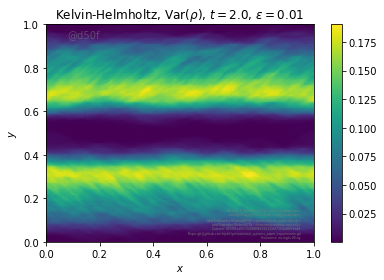

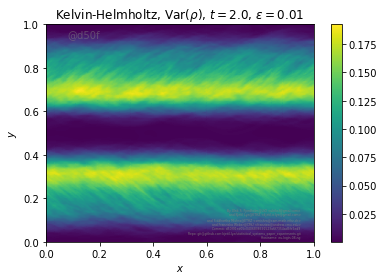

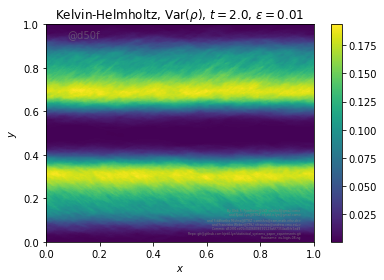

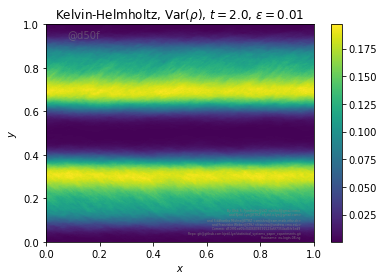

[0.08636302 0.03700881 0.02717747 0.02299001]


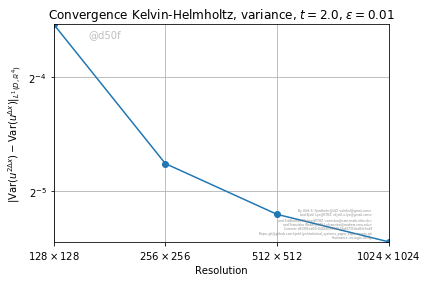

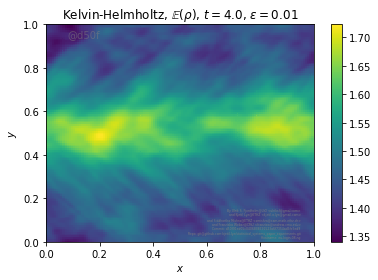

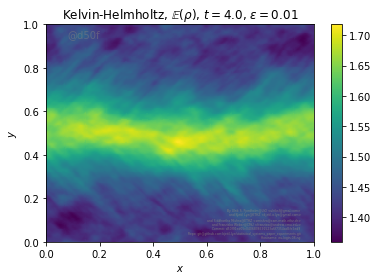

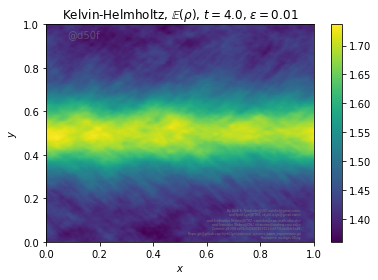

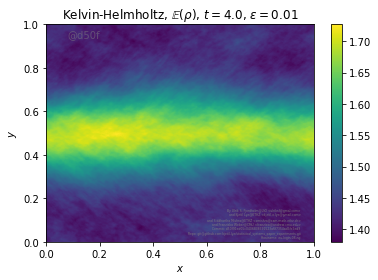

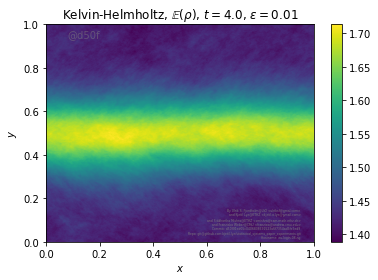

[0.12715952 0.09159804 0.06381929 0.05314289]


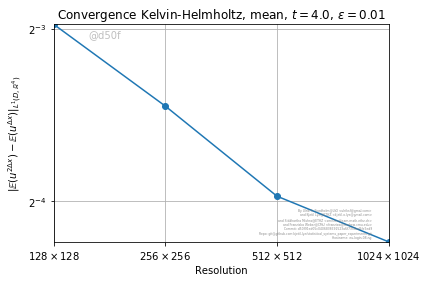

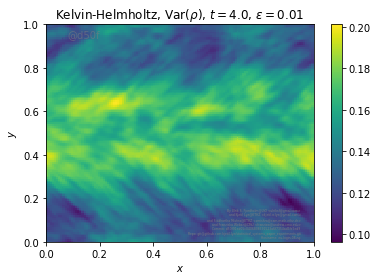

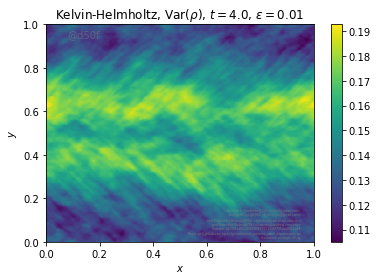

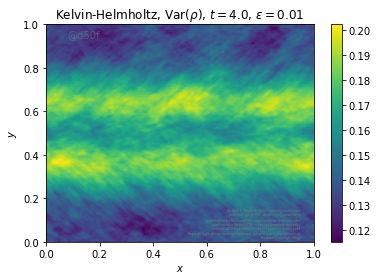

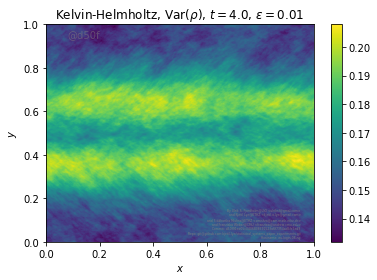

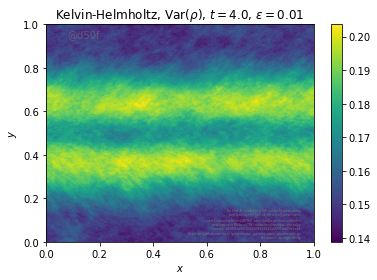

[0.10239551 0.06617072 0.05514325 0.04153706]


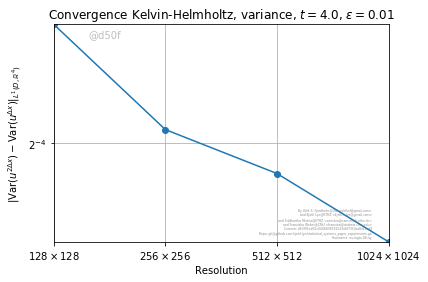

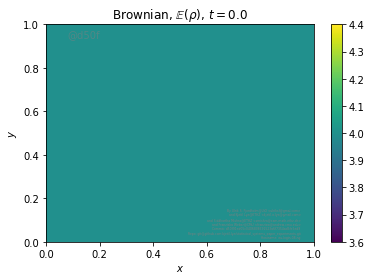

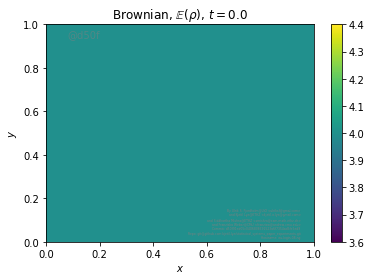

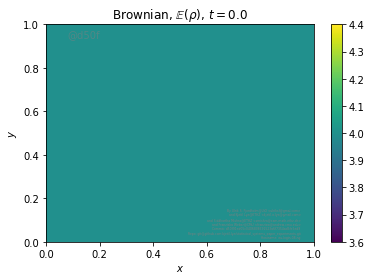

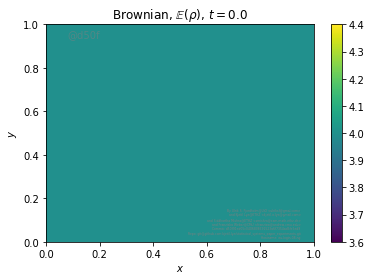

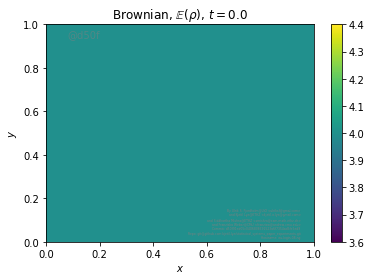

[0.26309945 0.22084207 0.10680397 0.0827431 ]


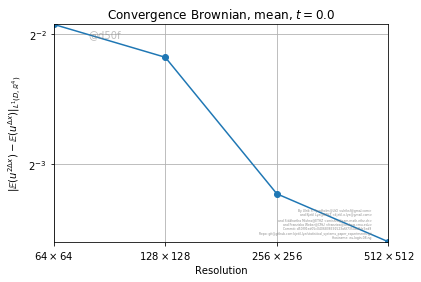

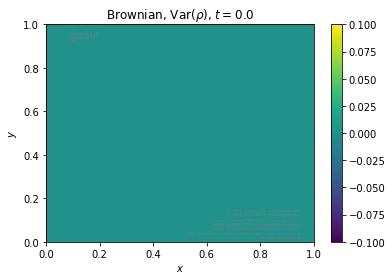

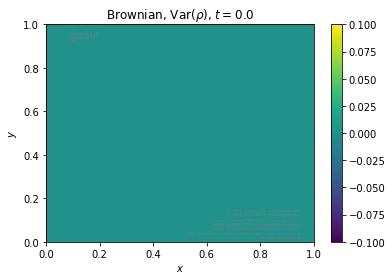

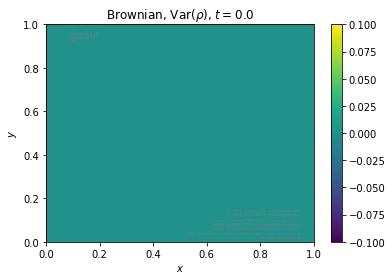

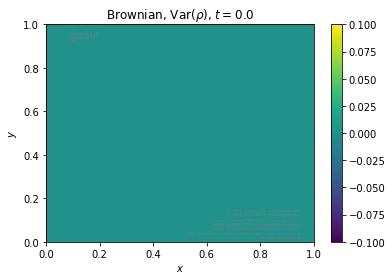

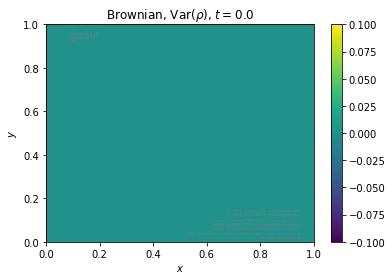

[0.60640158 0.41551218 0.26990778 0.17401985]


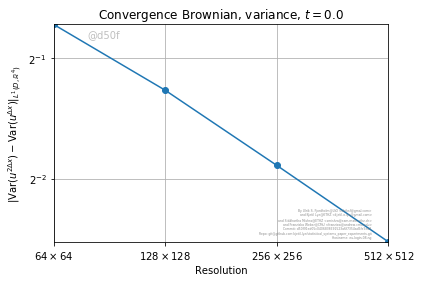

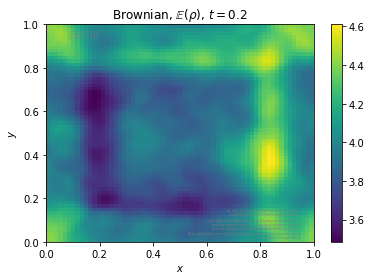

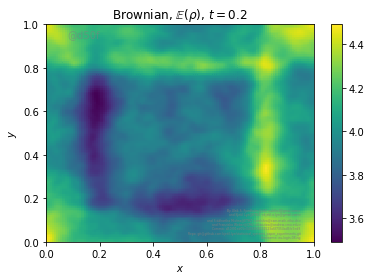

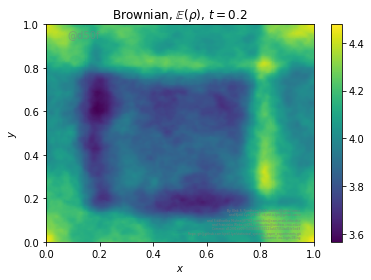

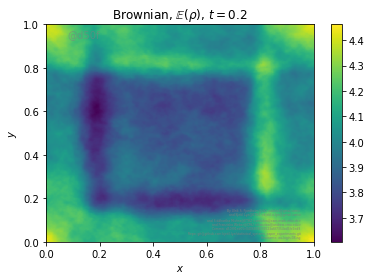

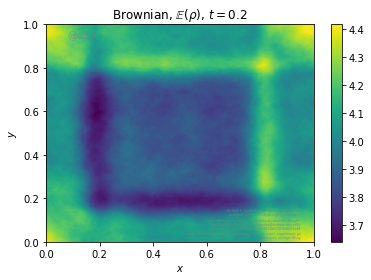

[0.37758272 0.38317659 0.17117445 0.15056439]


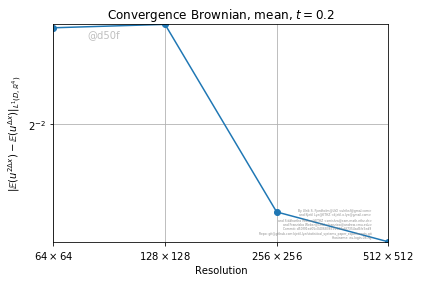

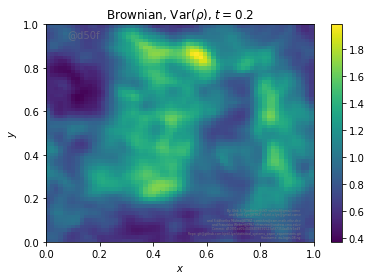

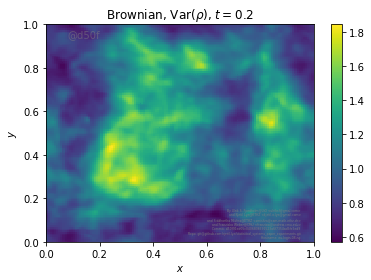

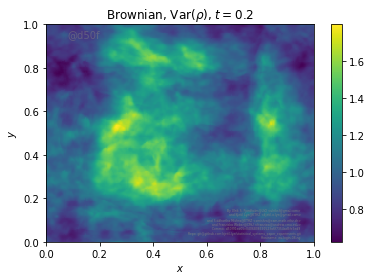

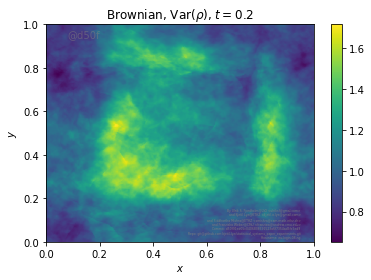

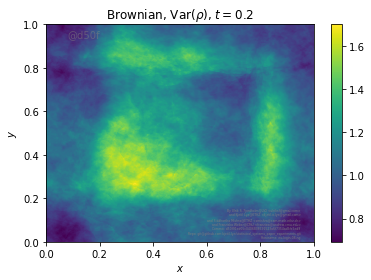

[1.47574791 1.06539435 0.67850946 0.47662108]


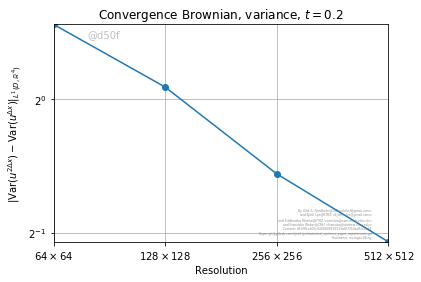

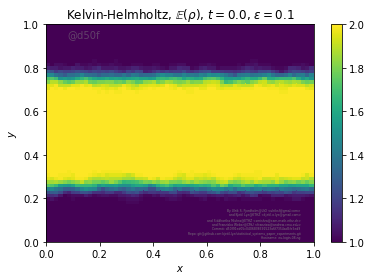

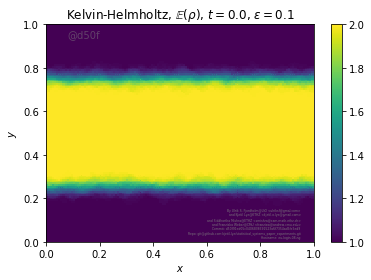

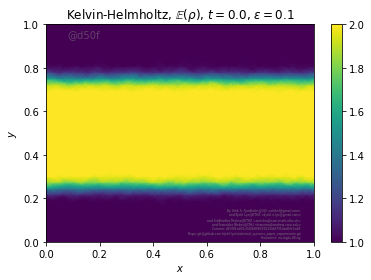

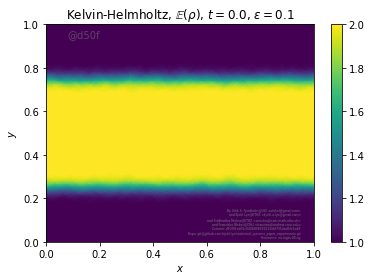

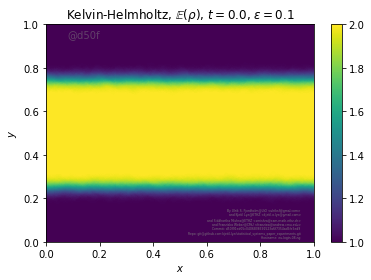

[0.02449697 0.01389087 0.00899896 0.00613367]


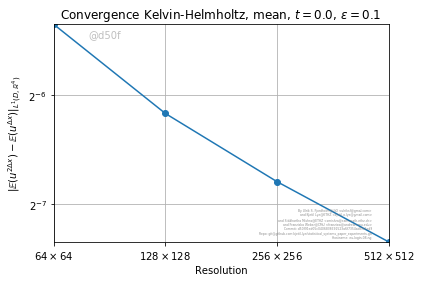

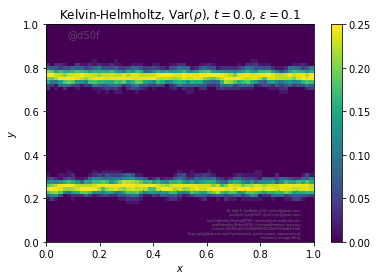

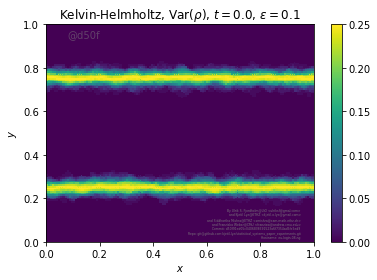

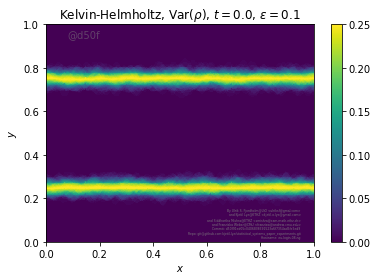

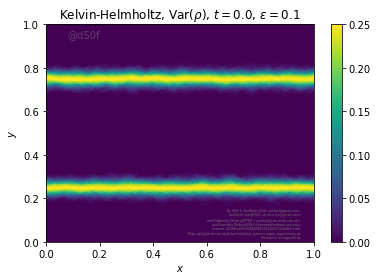

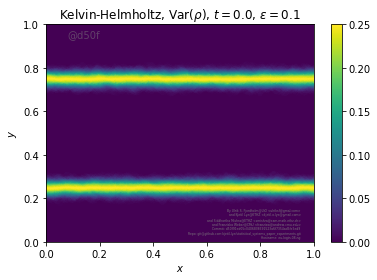

[0.01625489 0.00943069 0.00614611 0.00411095]


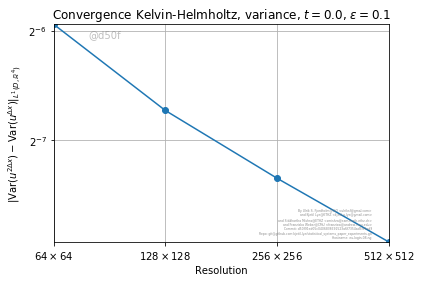

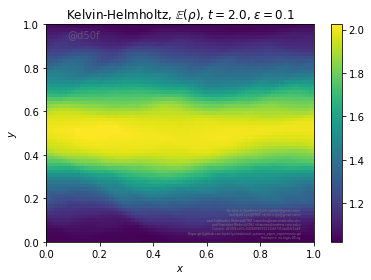

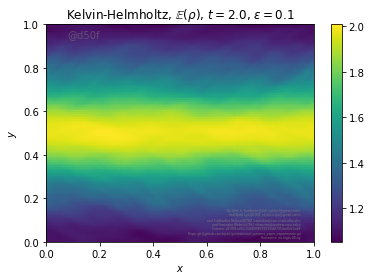

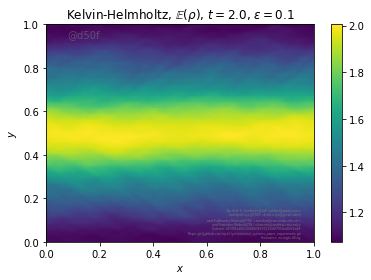

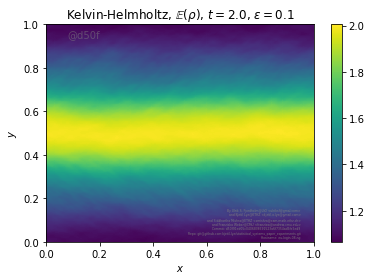

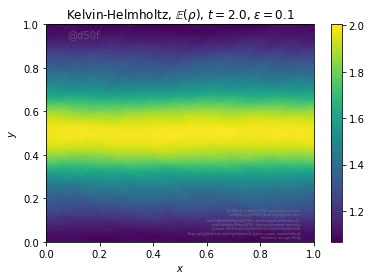

[0.12664221 0.0839608  0.04361889 0.03566689]


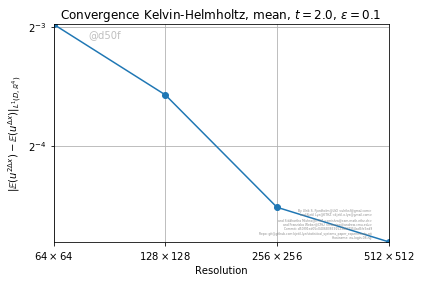

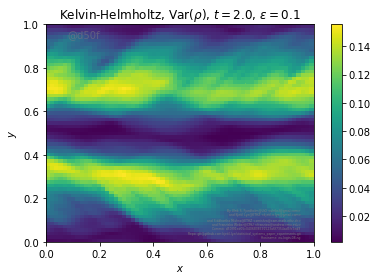

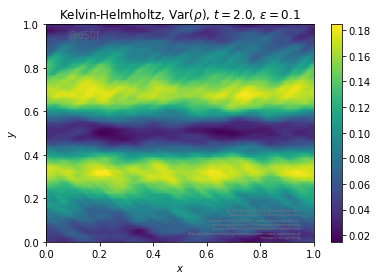

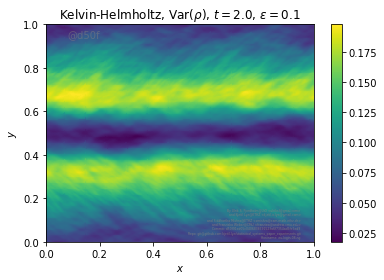

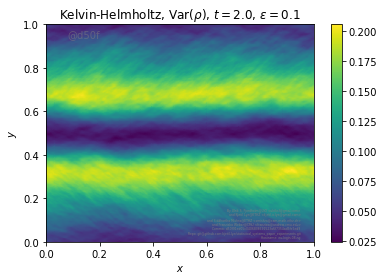

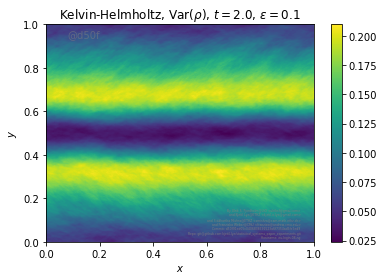

[0.1332765  0.05558427 0.03582267 0.02807927]


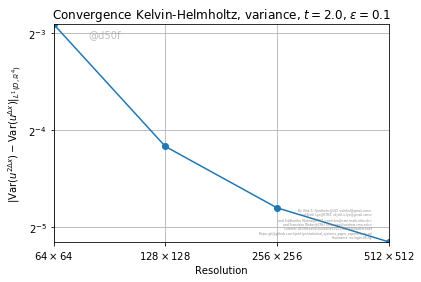

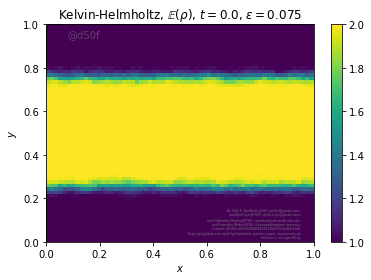

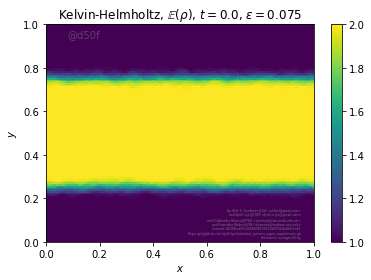

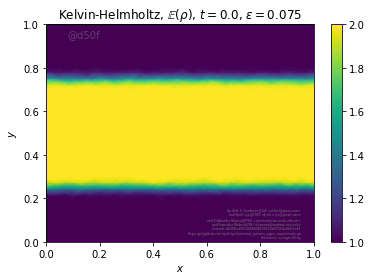

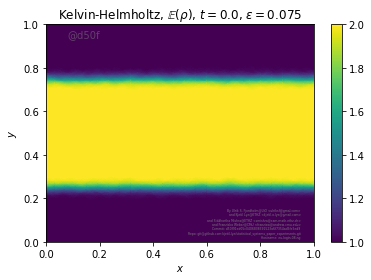

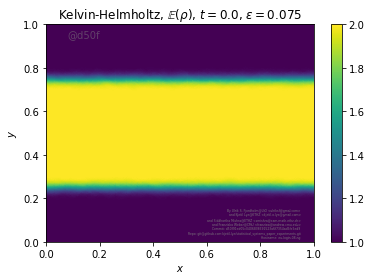

[0.02240038 0.0121133  0.00740555 0.00482046]


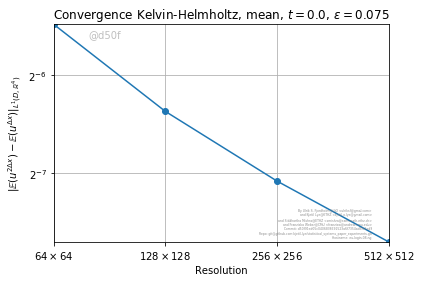

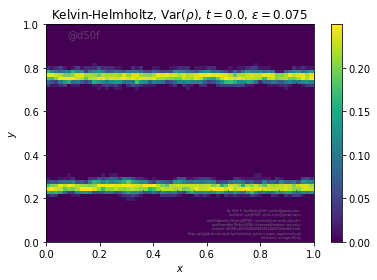

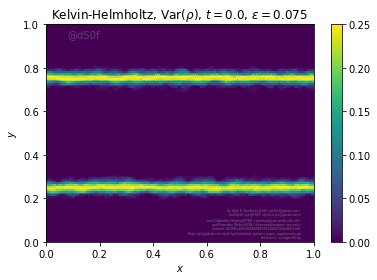

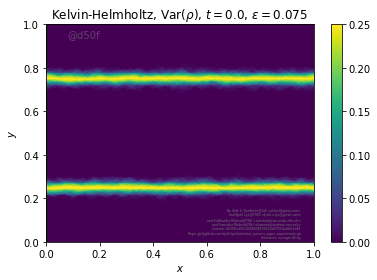

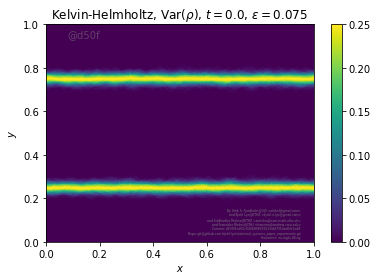

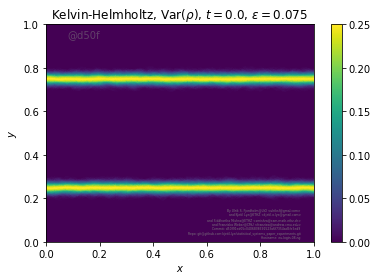

[0.01476529 0.00804001 0.00498965 0.00321842]


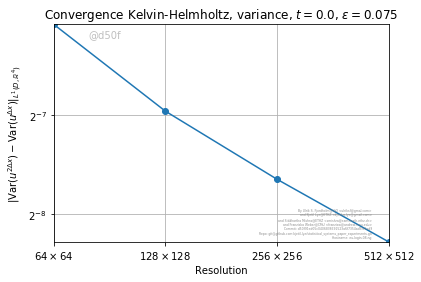

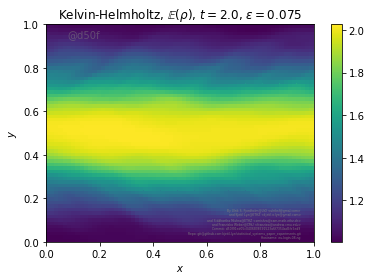

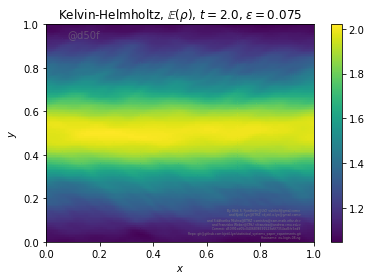

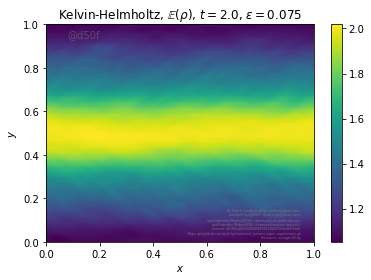

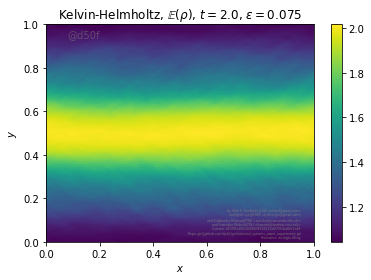

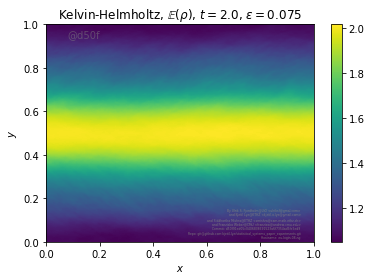

[0.13165552 0.07709429 0.04525899 0.03410788]


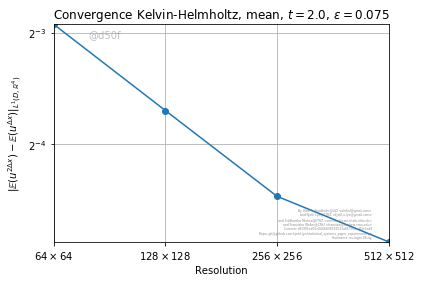

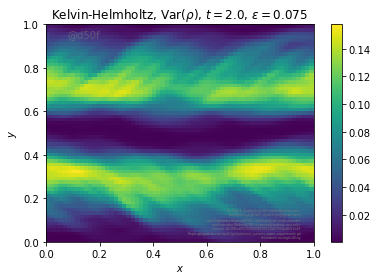

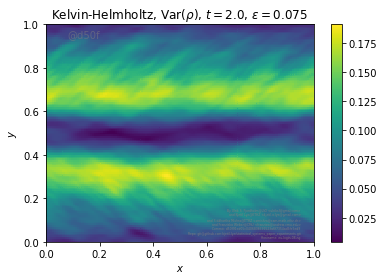

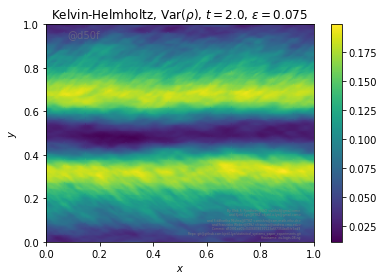

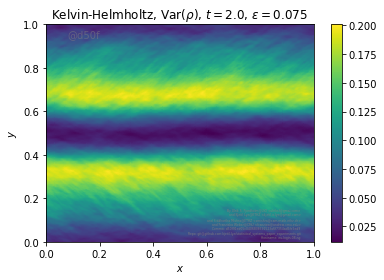

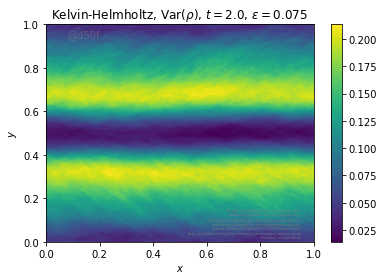

[0.14628686 0.06088628 0.03516656 0.0298345 ]


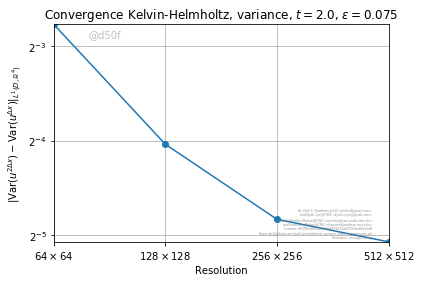

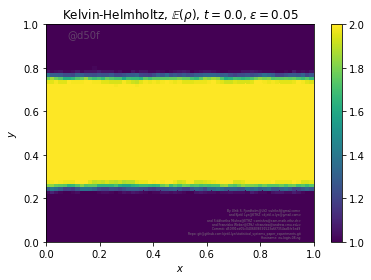

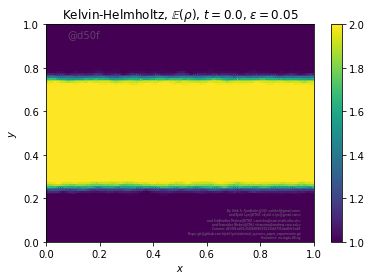

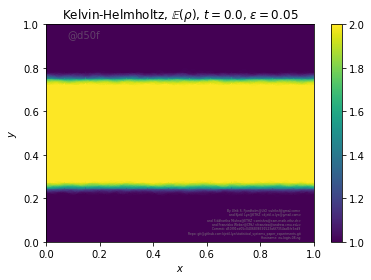

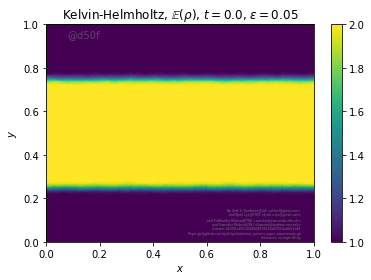

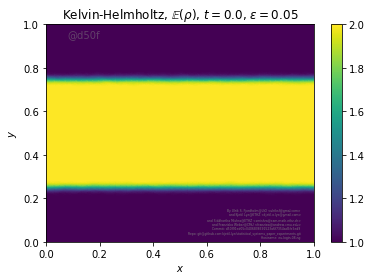

[0.02111989 0.01089258 0.00603874 0.00361577]


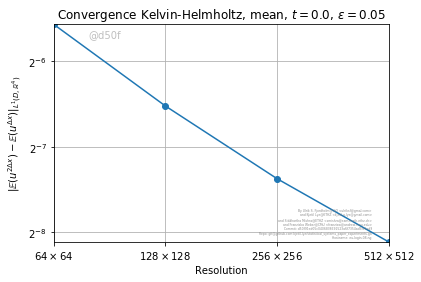

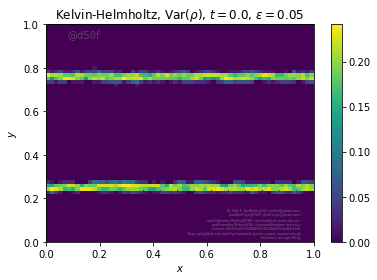

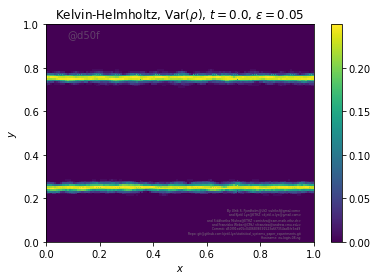

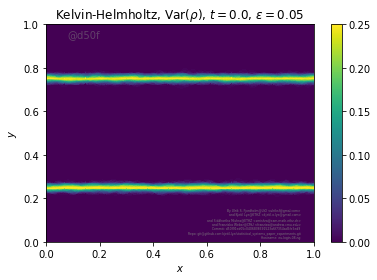

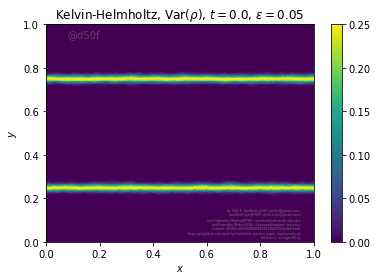

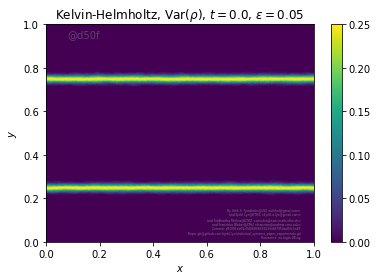

[0.01411833 0.00709374 0.00397151 0.00238933]


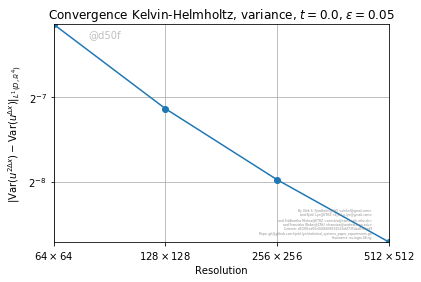

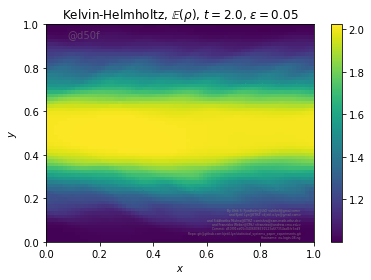

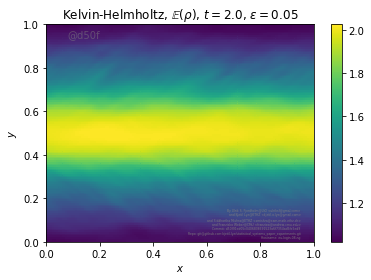

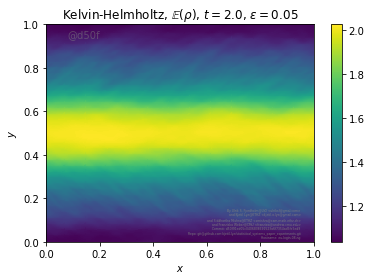

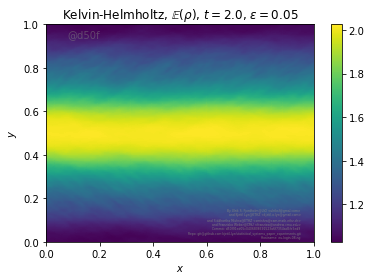

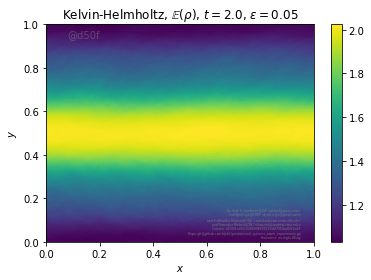

[0.15228143 0.07436931 0.04863297 0.03379244]


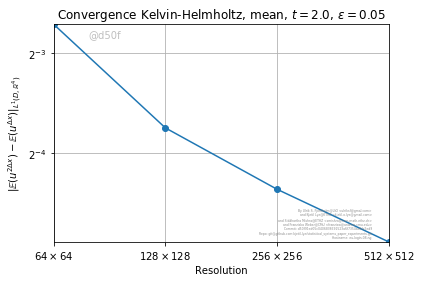

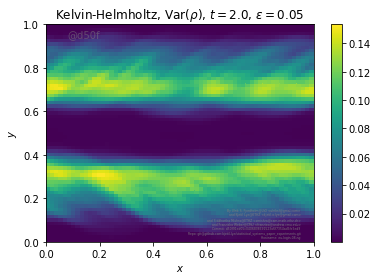

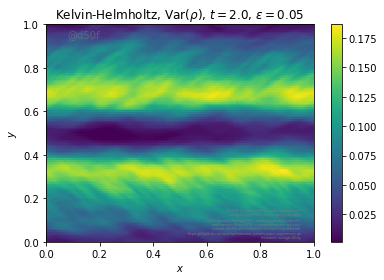

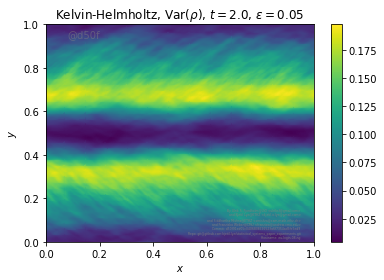

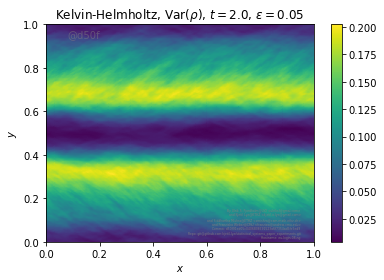

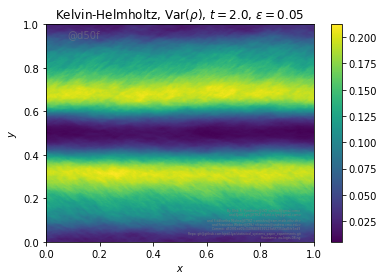

[0.16224751 0.06598912 0.03746549 0.03182585]


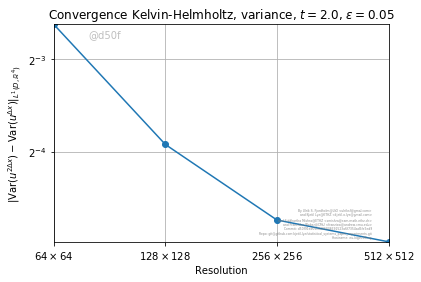

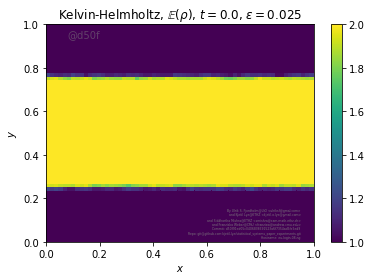

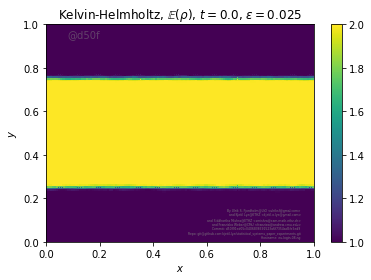

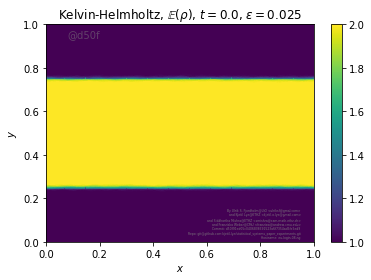

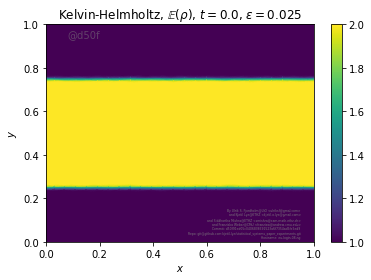

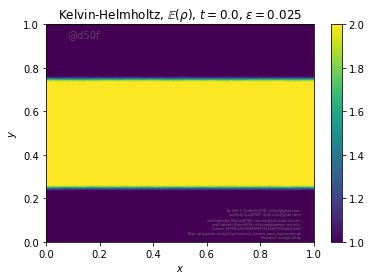

[0.02003843 0.01036468 0.00524297 0.00272614]


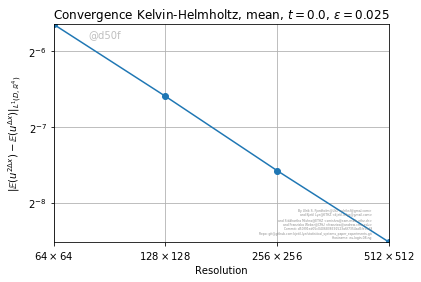

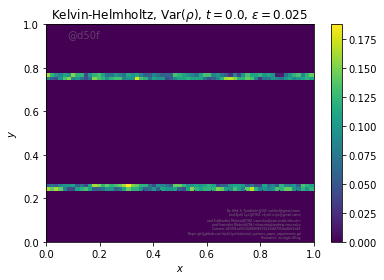

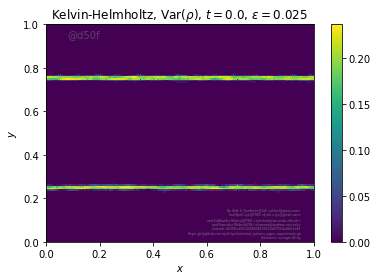

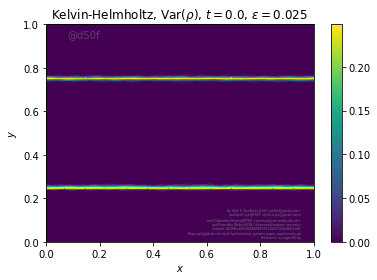

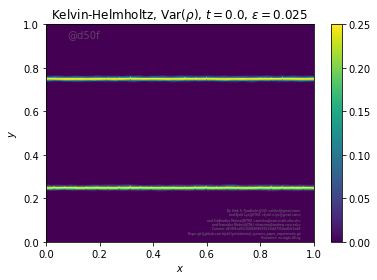

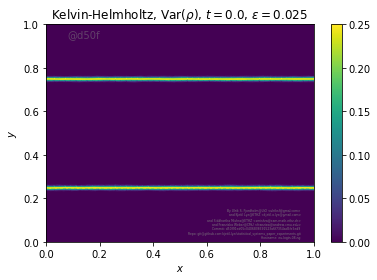

[0.01709552 0.00687277 0.0033513  0.00174828]


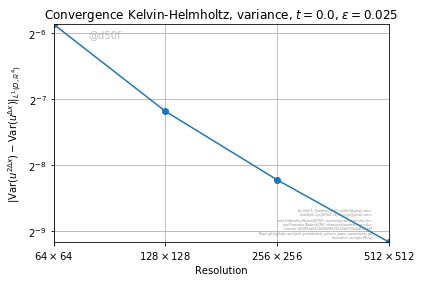

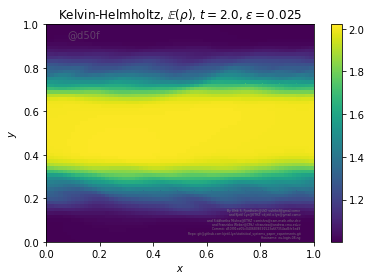

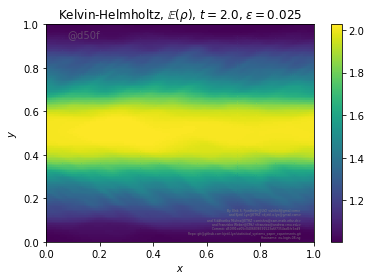

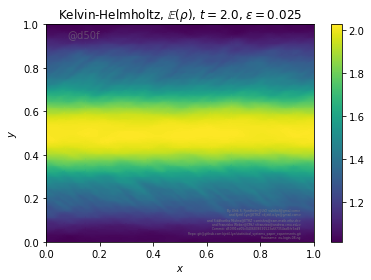

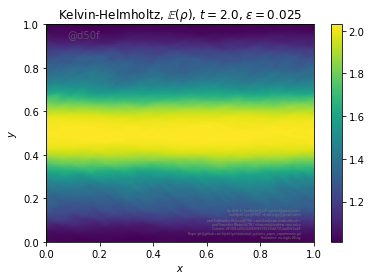

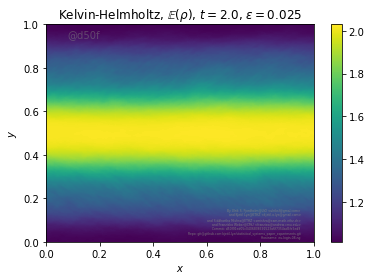

[0.15594747 0.09528972 0.05437225 0.03349851]


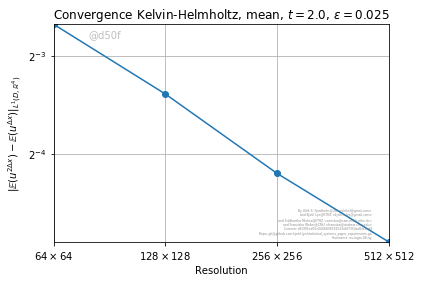

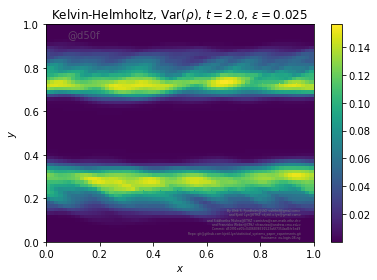

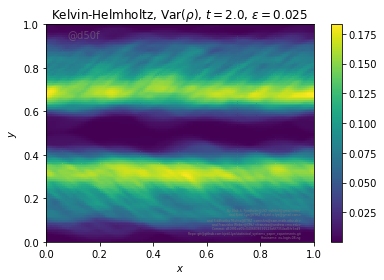

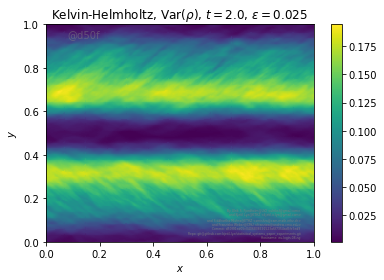

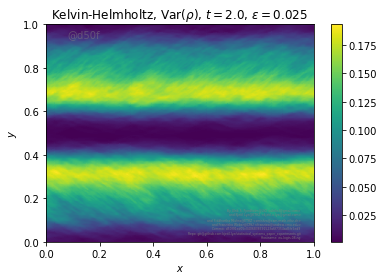

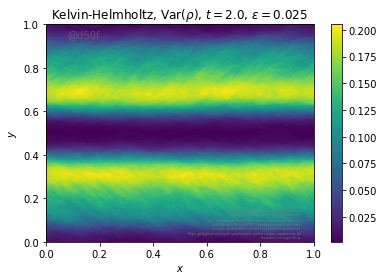

[0.15984159 0.09060686 0.0364728  0.03070783]


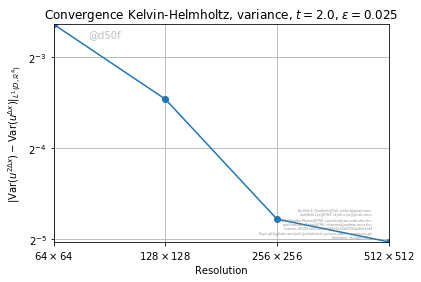

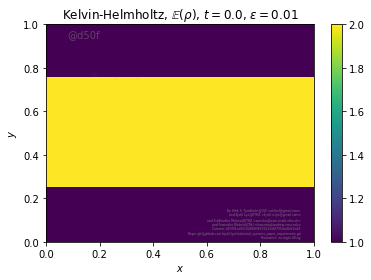

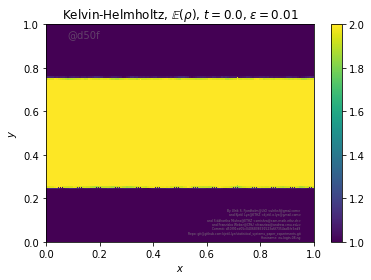

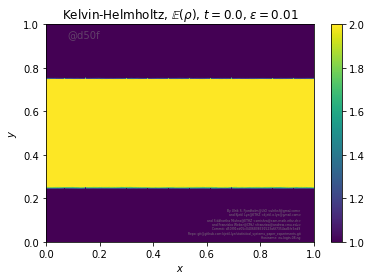

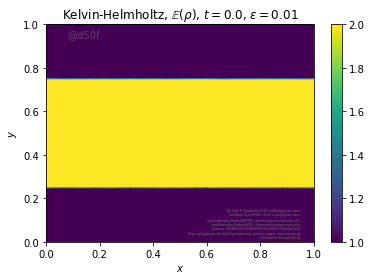

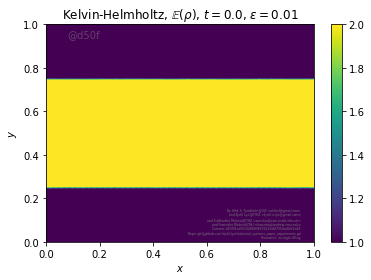

[0.00541985 0.00901081 0.00512883 0.00256245]


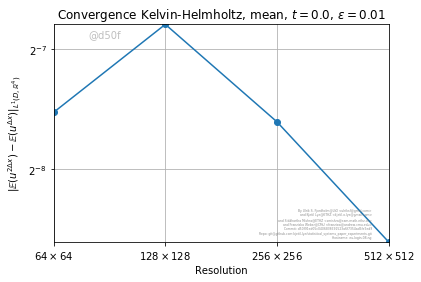

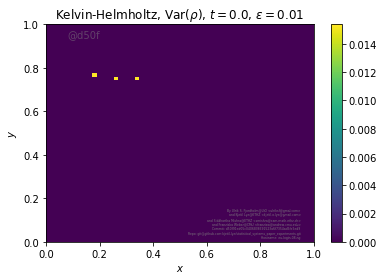

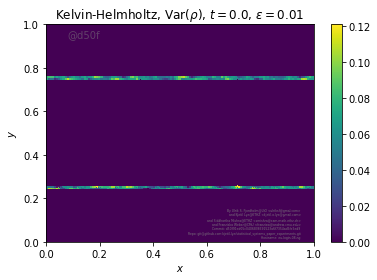

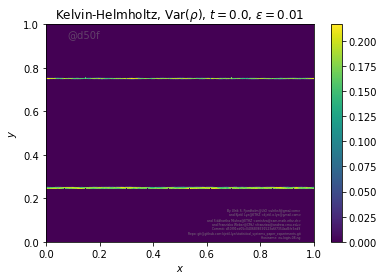

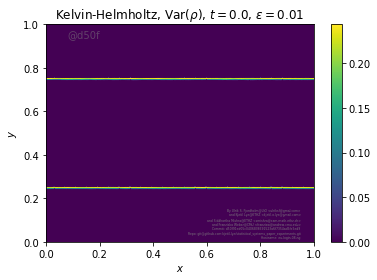

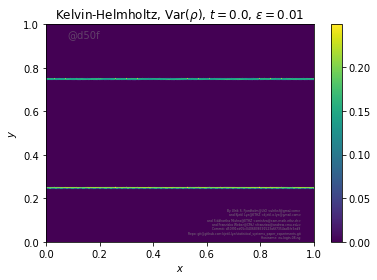

[0.00623881 0.00850155 0.00355981 0.00163244]


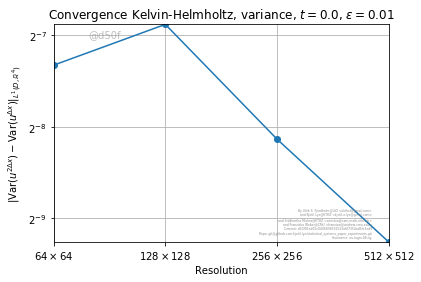

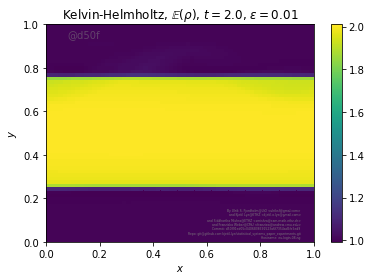

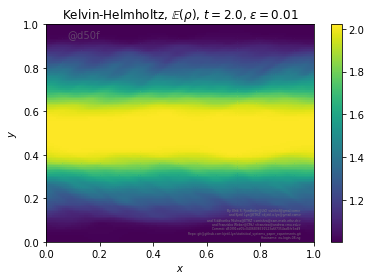

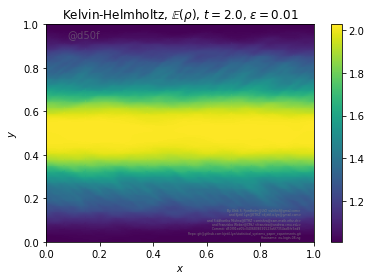

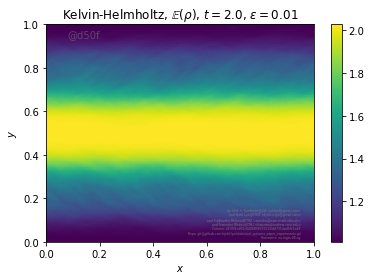

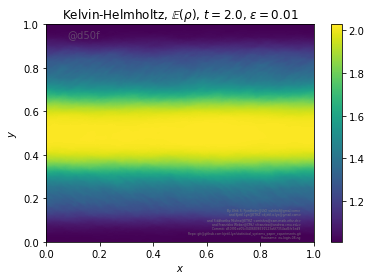

[0.26927946 0.08996162 0.05014102 0.03573032]


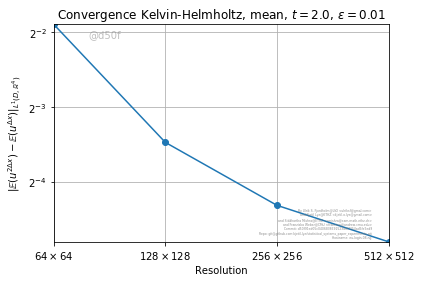

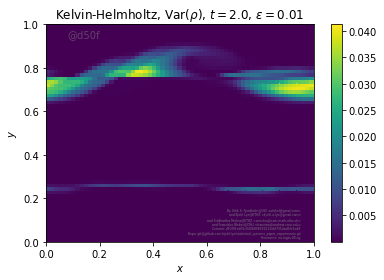

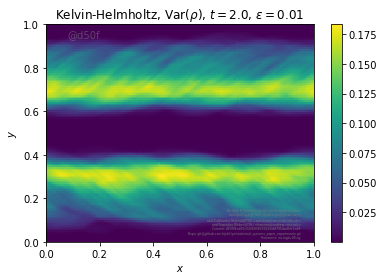

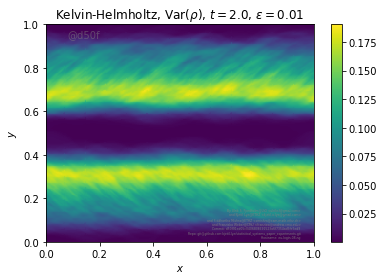

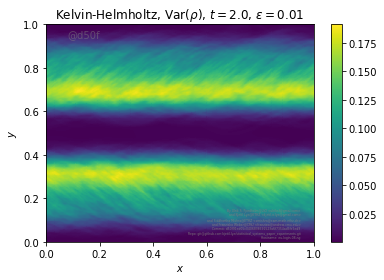

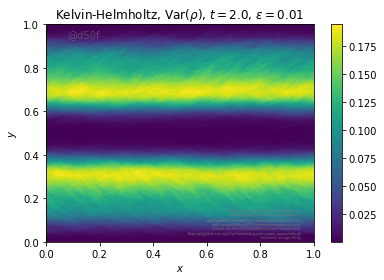

[0.191707   0.08646667 0.03701402 0.02689492]


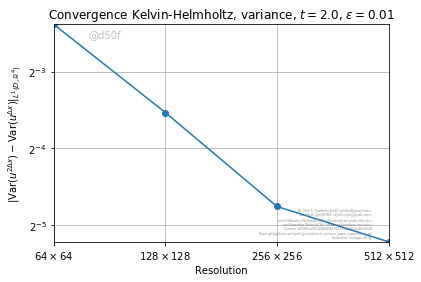

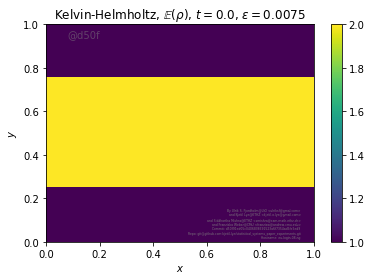

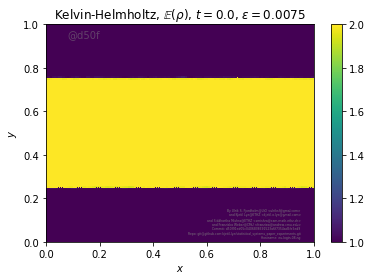

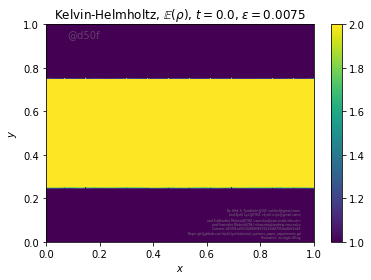

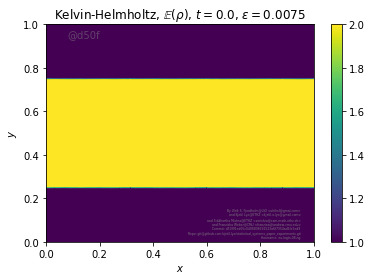

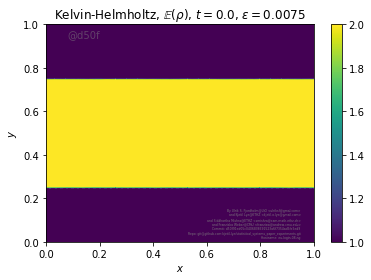

[0.00167853 0.00656813 0.00511428 0.00256867]


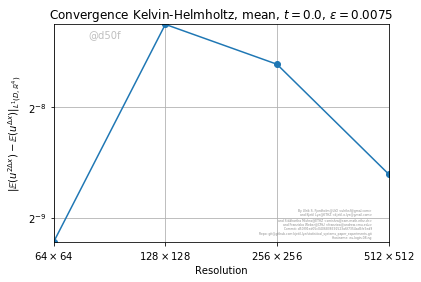

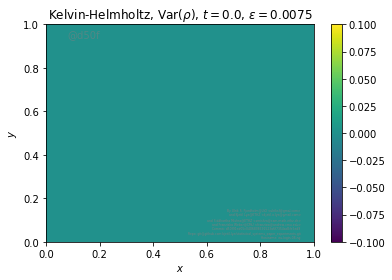

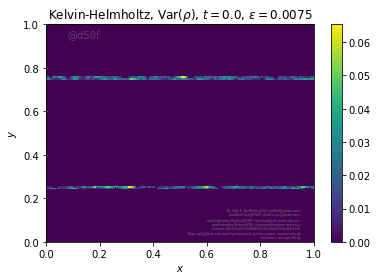

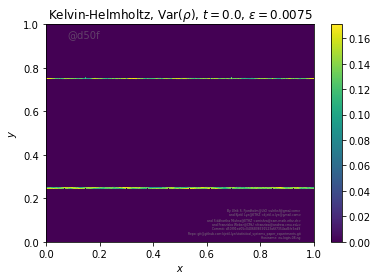

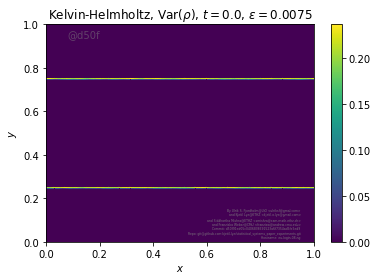

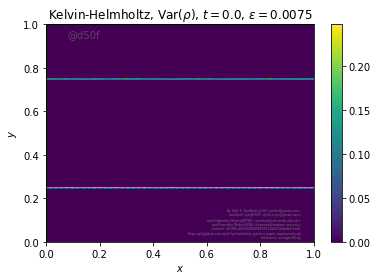

[0.00202815 0.0068306  0.00398817 0.00166949]


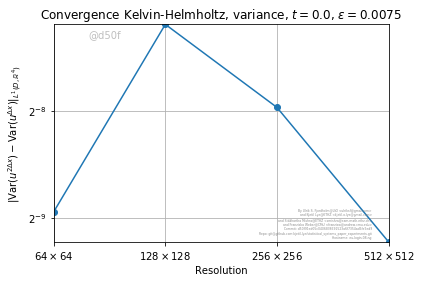

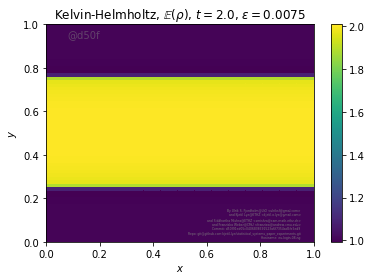

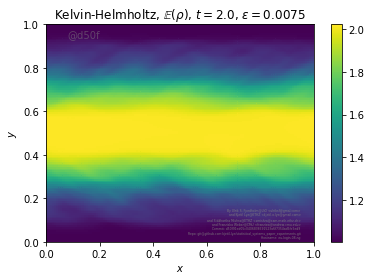

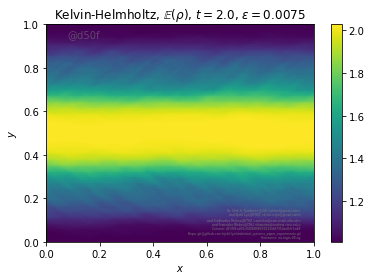

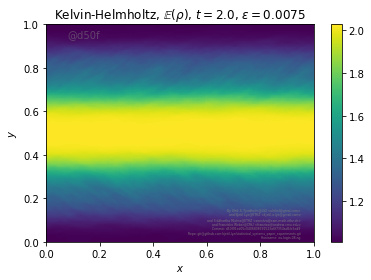

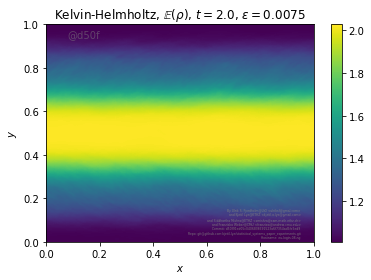

[0.25013048 0.11999131 0.04572302 0.0327651 ]


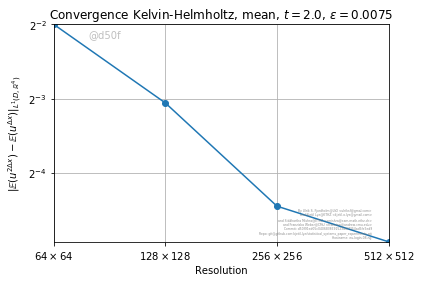

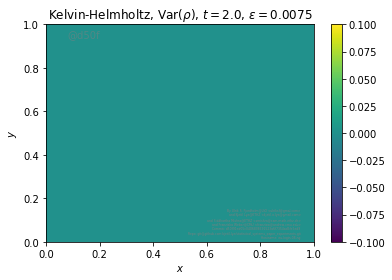

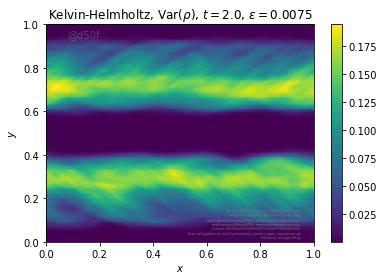

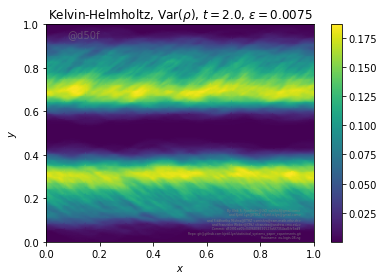

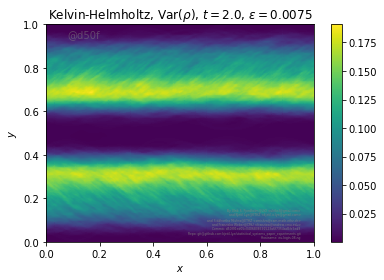

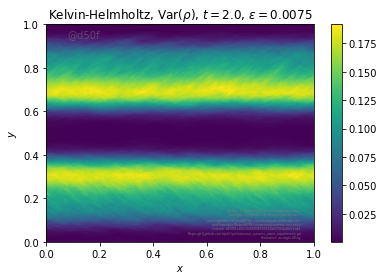

[0.18929456 0.08749071 0.03748554 0.02714233]


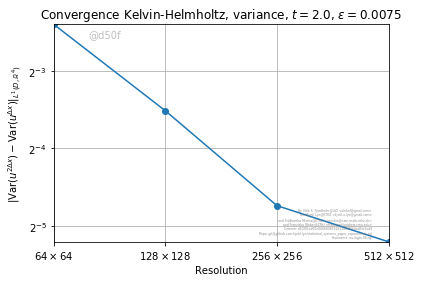

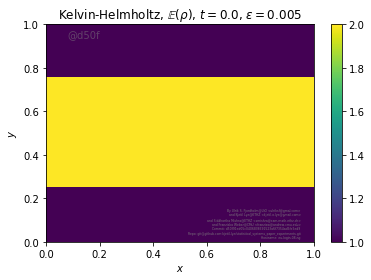

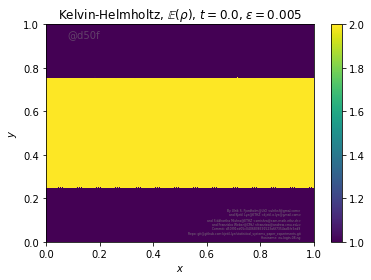

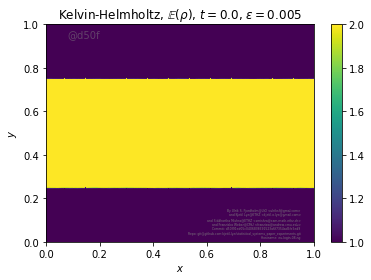

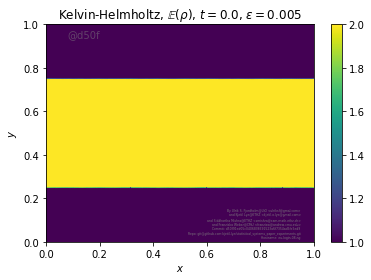

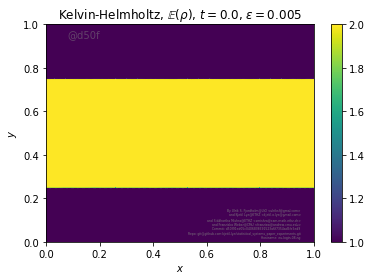

[2.62856483e-05 2.72119045e-03 4.51635942e-03 2.55668757e-03]


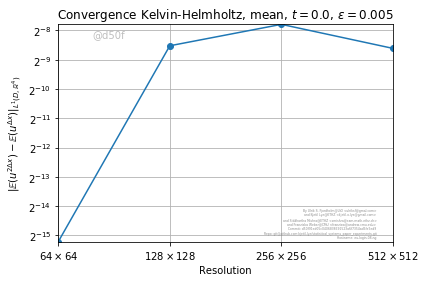

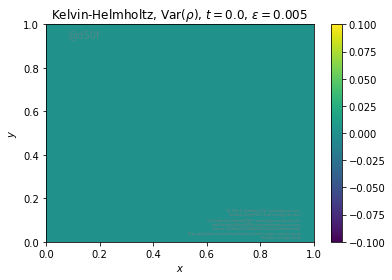

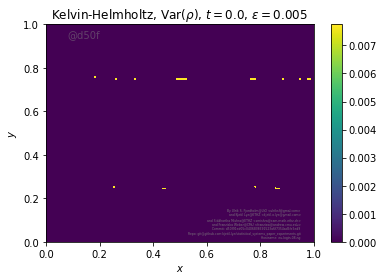

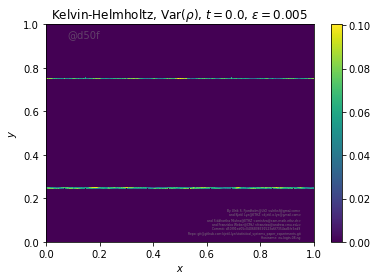

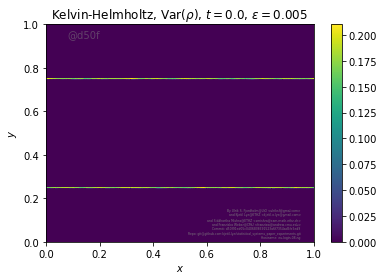

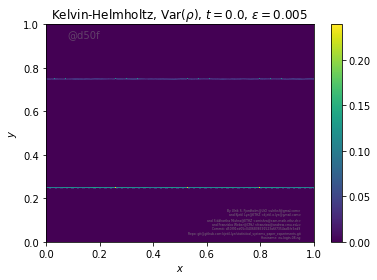

[3.24451248e-05 3.14886658e-03 4.26066240e-03 1.77350986e-03]


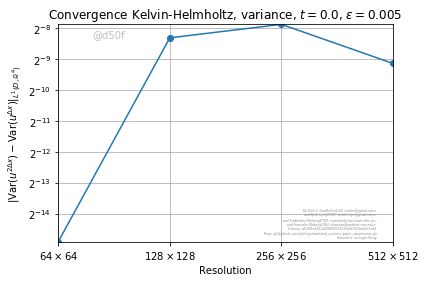

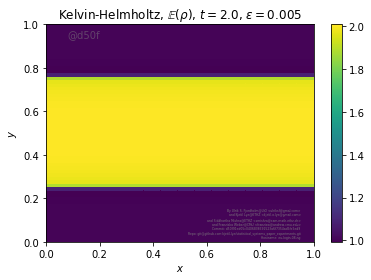

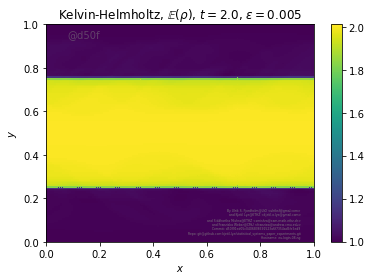

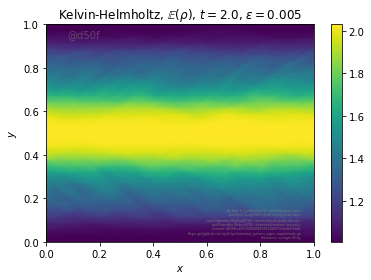

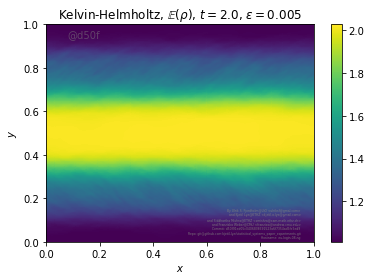

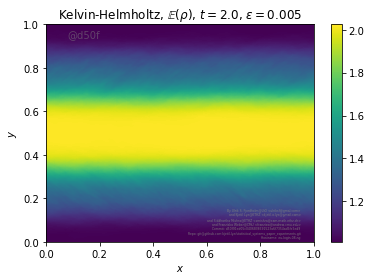

[0.06936775 0.38503801 0.08850824 0.03680141]


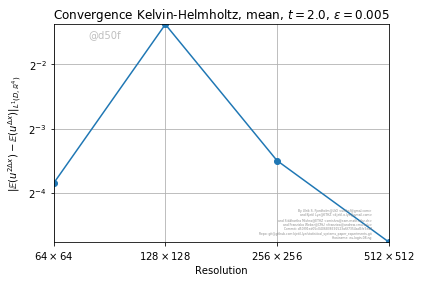

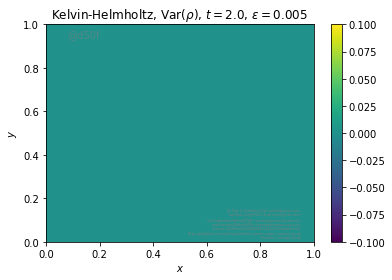

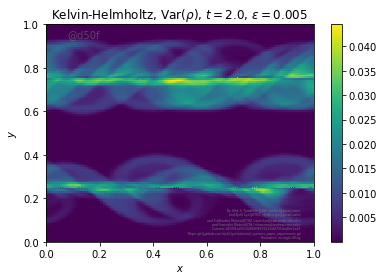

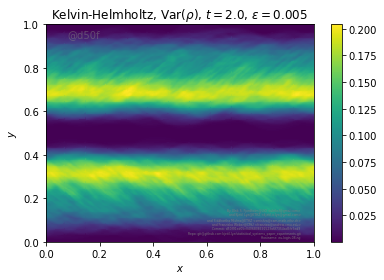

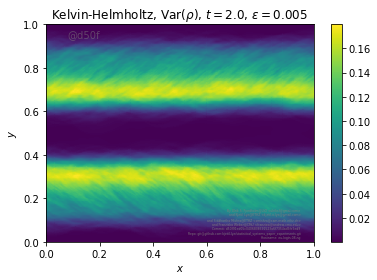

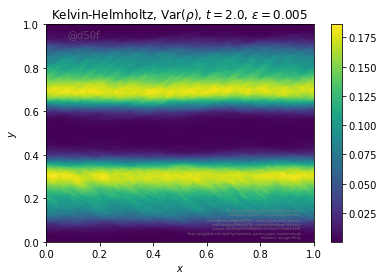

[0.01583439 0.27898952 0.05206208 0.02887841]


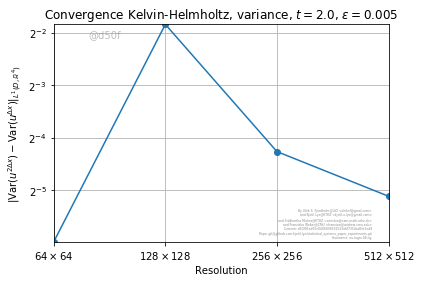

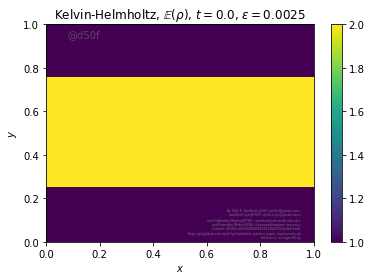

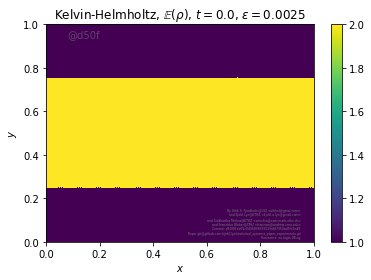

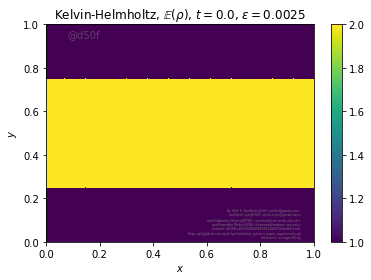

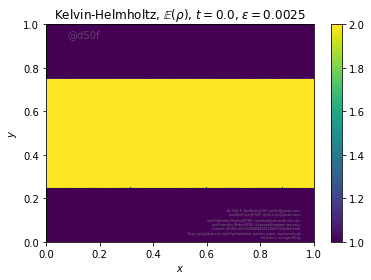

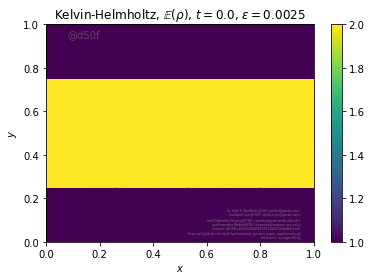

[0.00000000e+00 1.56462193e-05 1.36507396e-03 2.26551387e-03]


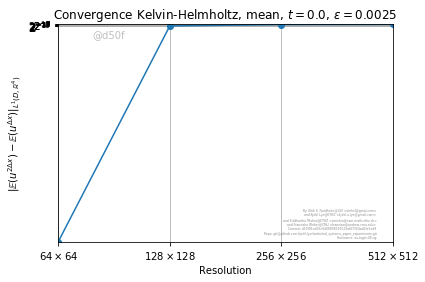

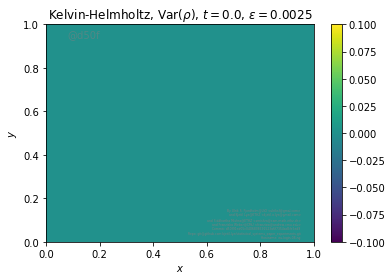

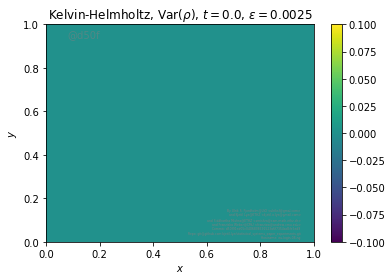

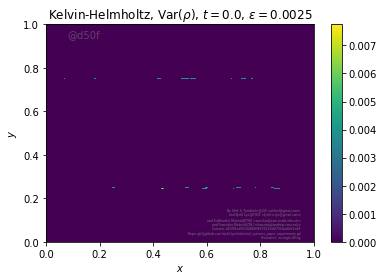

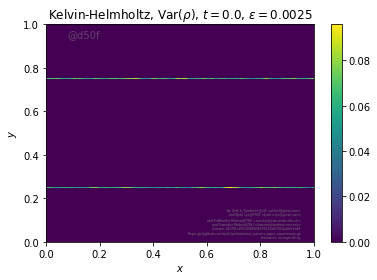

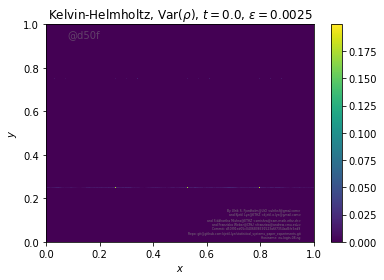

[0.00000000e+00 1.93870874e-05 1.58191705e-03 2.13833675e-03]


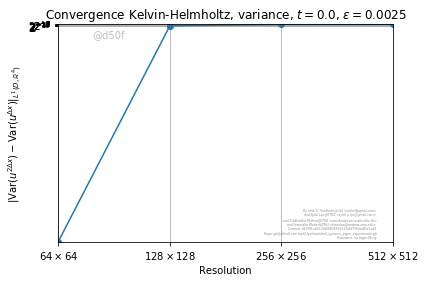

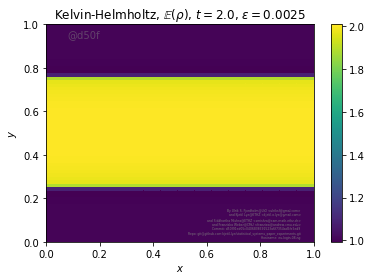

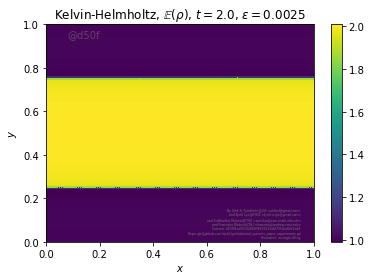

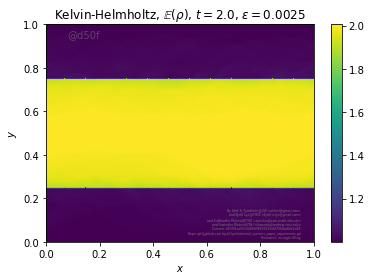

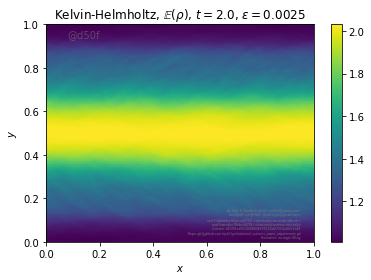

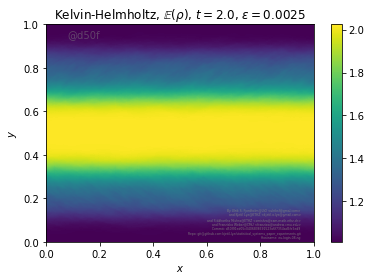

[0.07017981 0.04851341 0.43733011 0.12414379]


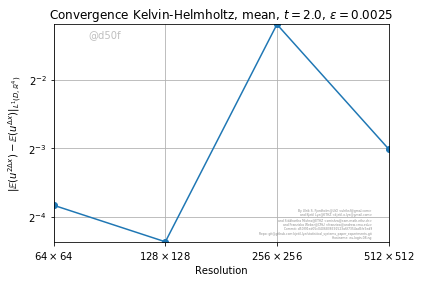

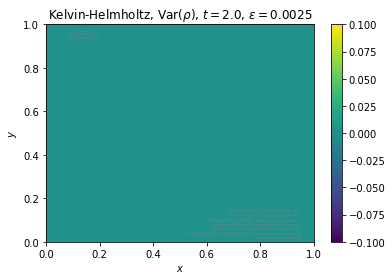

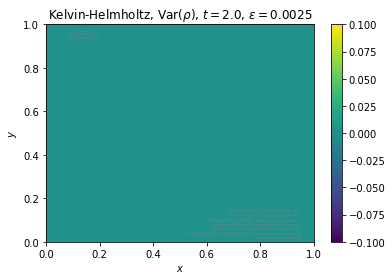

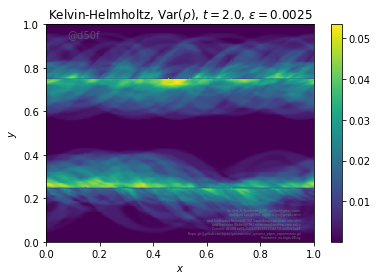

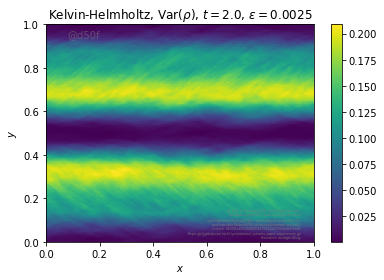

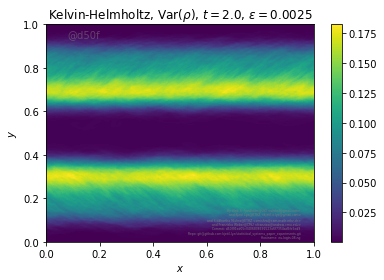

[0.         0.02795845 0.31293758 0.07378391]


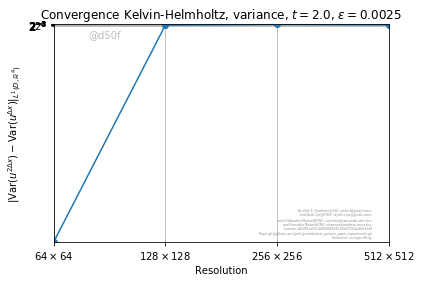

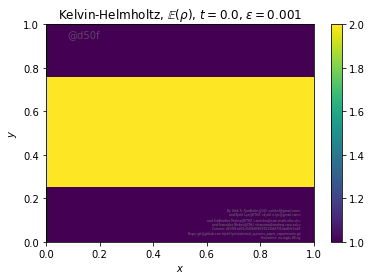

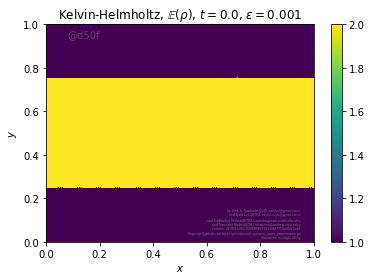

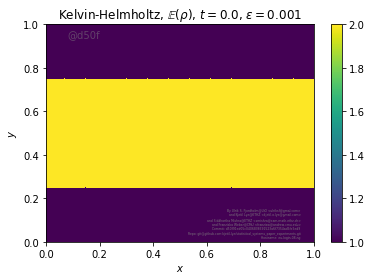

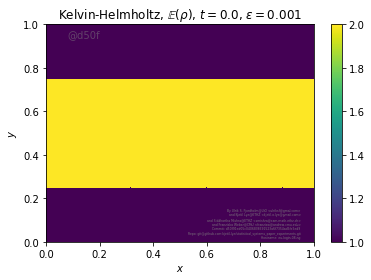

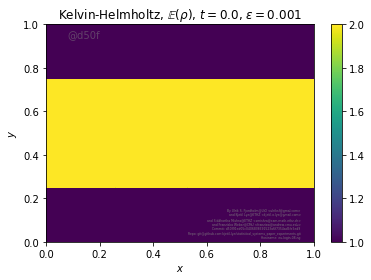

[0.0000000e+00 8.8817842e-16 0.0000000e+00 2.9078254e-04]


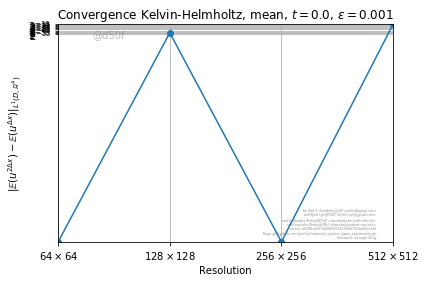

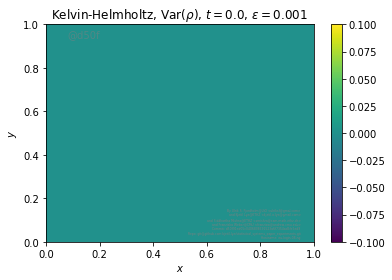

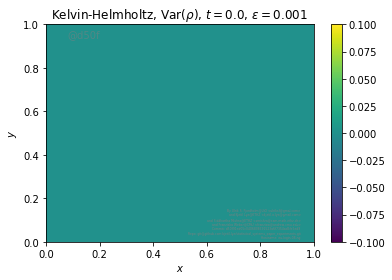

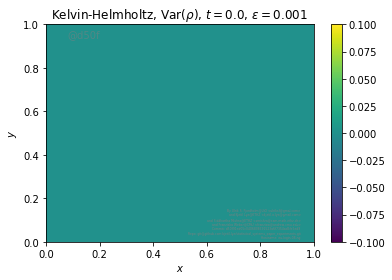

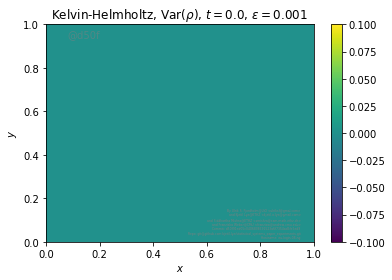

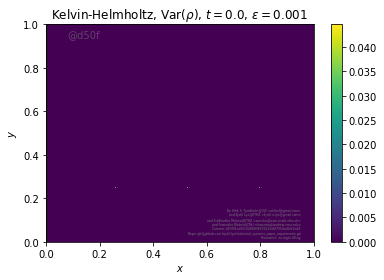

[0.00000000e+00 7.10542736e-15 0.00000000e+00 3.51117086e-04]


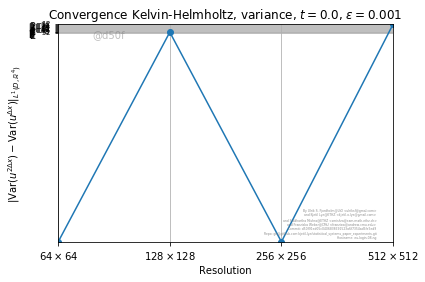

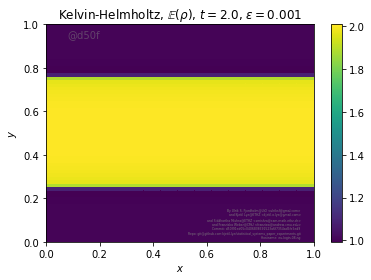

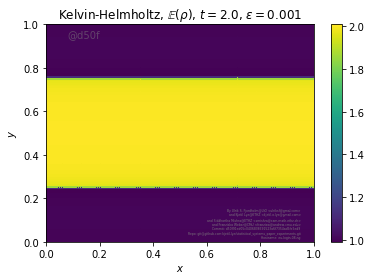

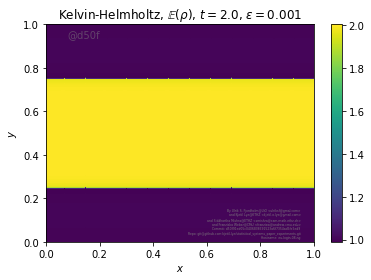

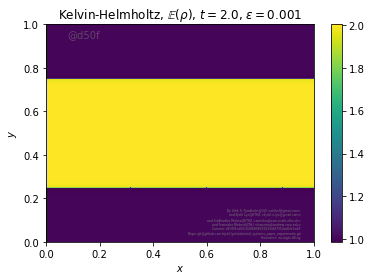

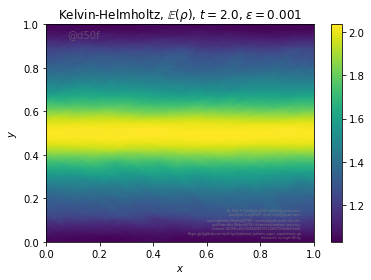

[0.07017981 0.04943691 0.0239348  0.55029494]


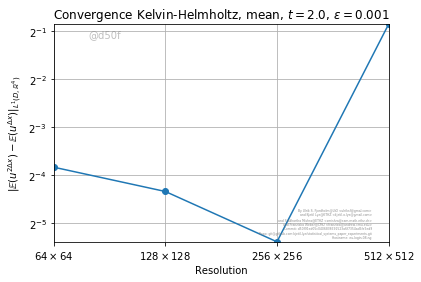

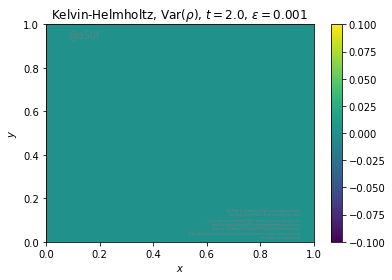

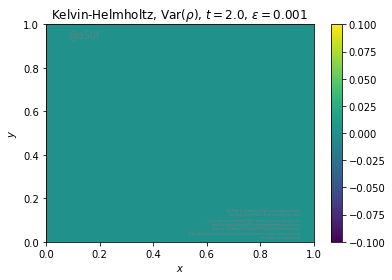

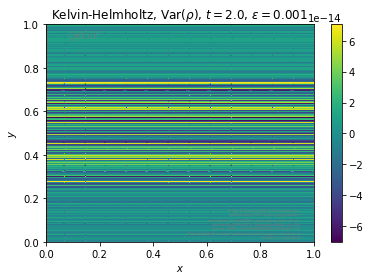

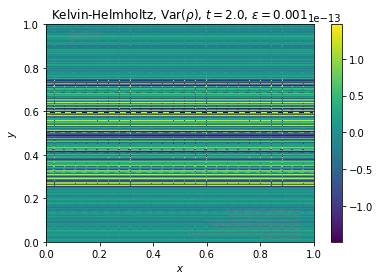

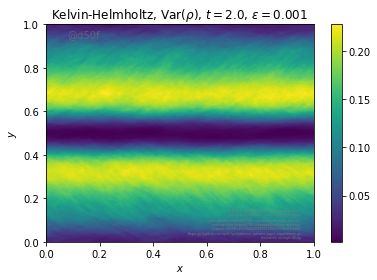

[0.00000000e+00 2.83759326e-13 6.17590654e-13 4.38048836e-01]


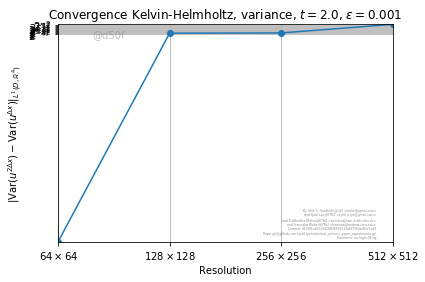

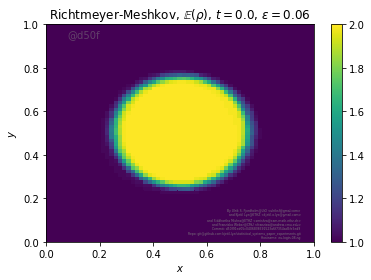

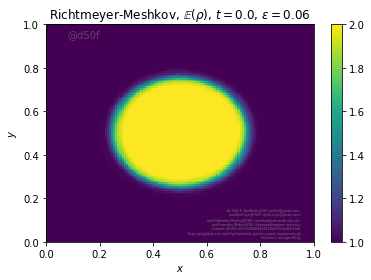

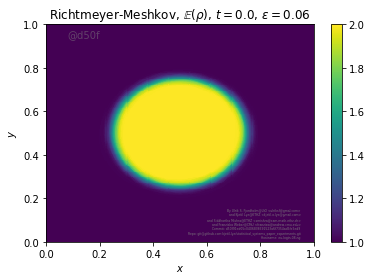

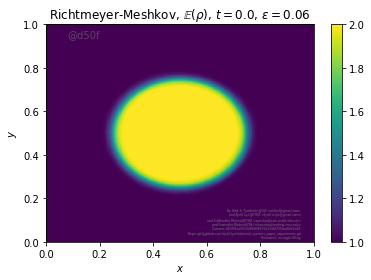

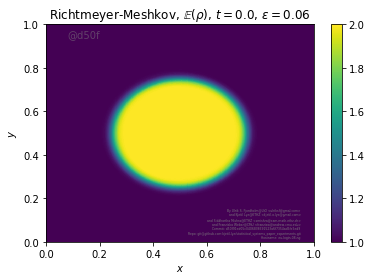

[0.11049652 0.05546999 0.03097419 0.01259892]


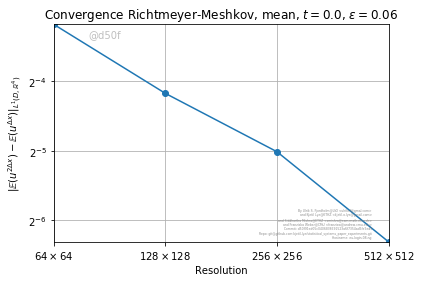

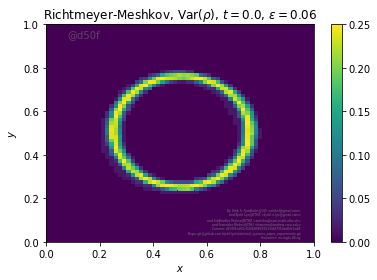

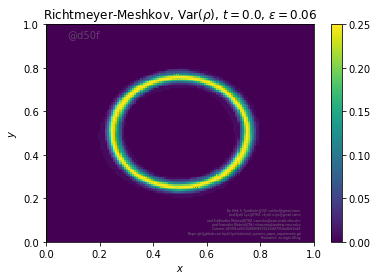

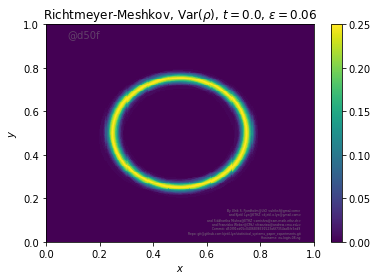

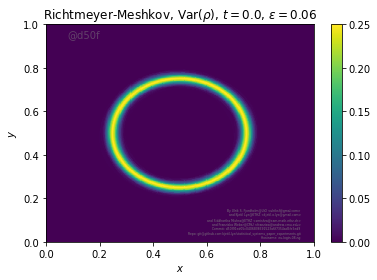

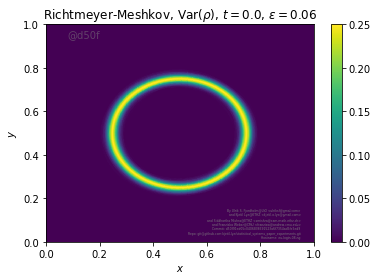

[0.00323374 0.00170469 0.00100335 0.00056004]


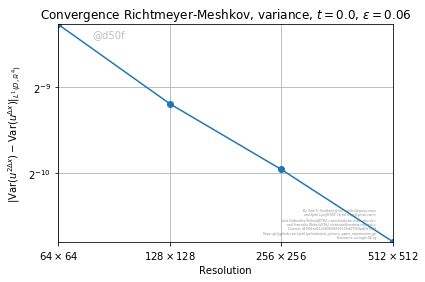

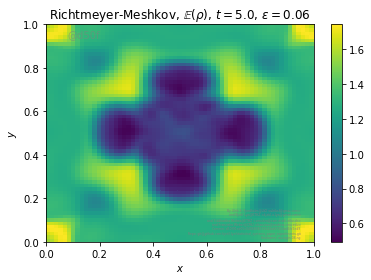

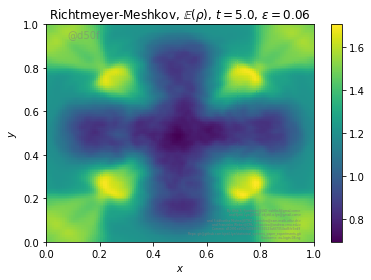

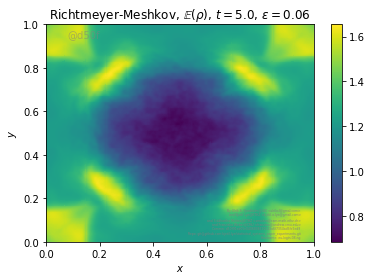

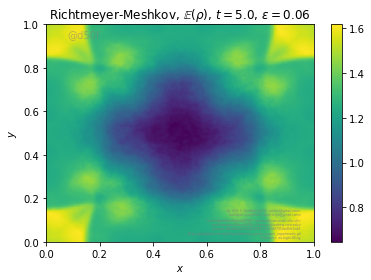

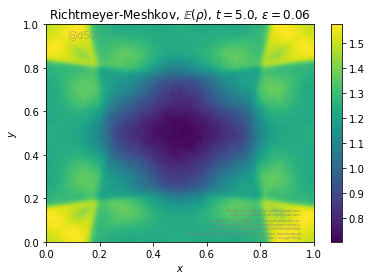

[0.66675913 0.32557386 0.11661378 0.12915784]


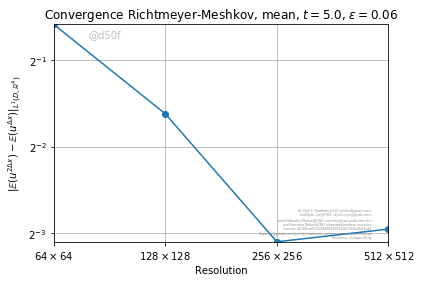

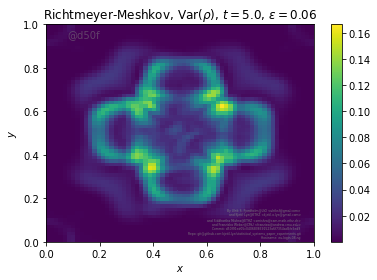

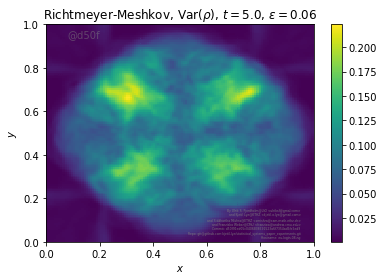

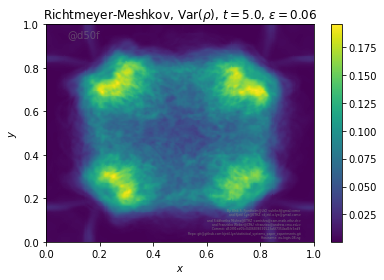

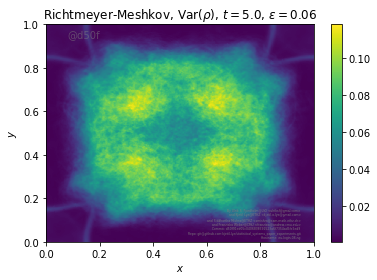

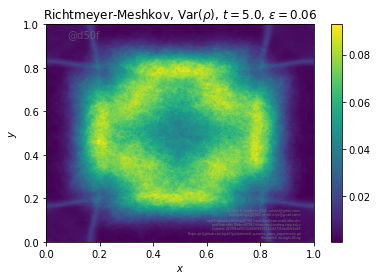

[0.09453454 0.06214285 0.02998009 0.0311235 ]


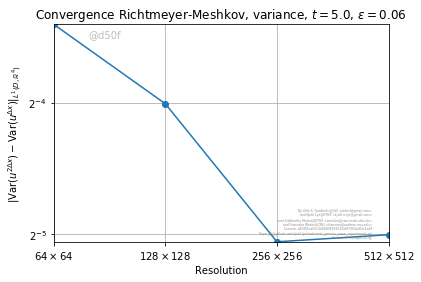

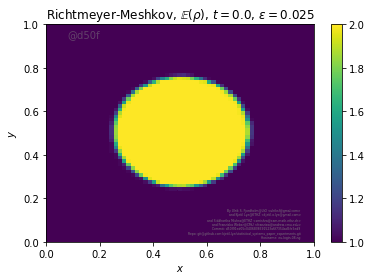

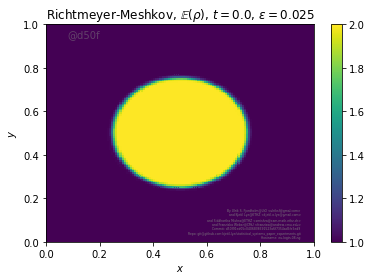

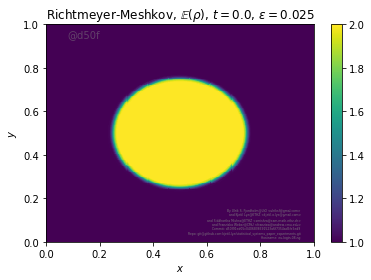

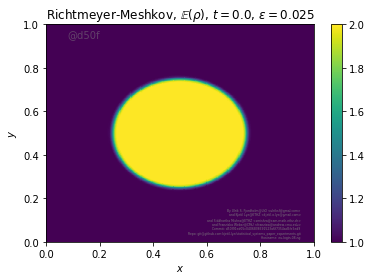

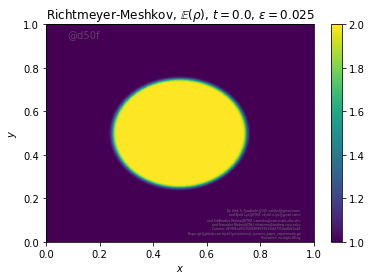

[0.10988855 0.05503732 0.03046701 0.01235186]


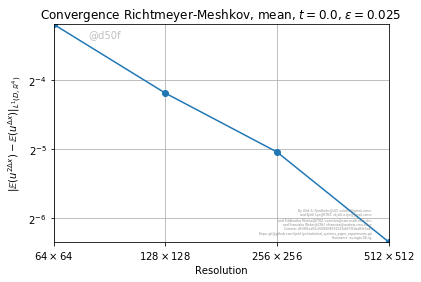

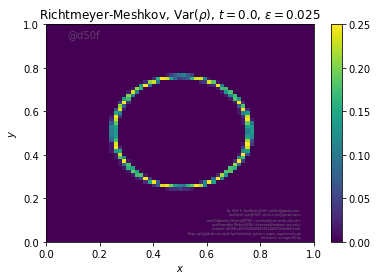

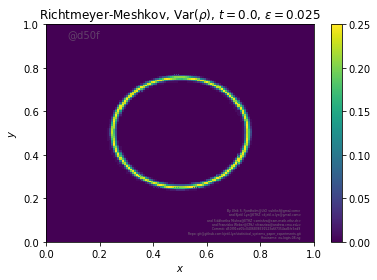

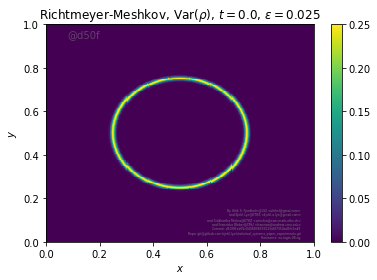

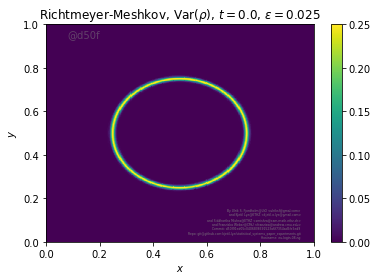

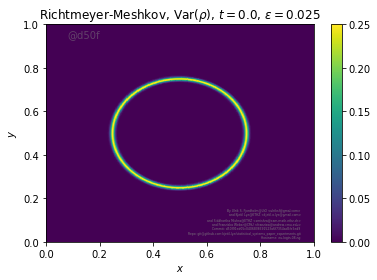

[0.00285063 0.00143681 0.00074106 0.00039311]


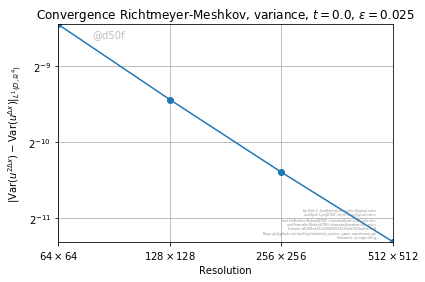

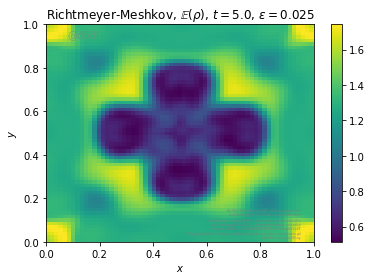

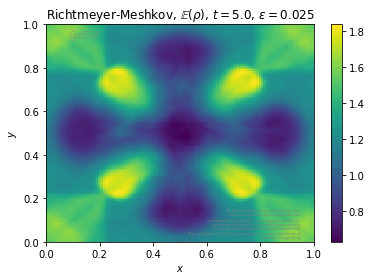

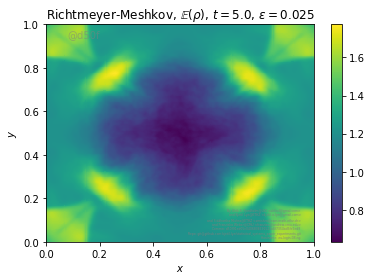

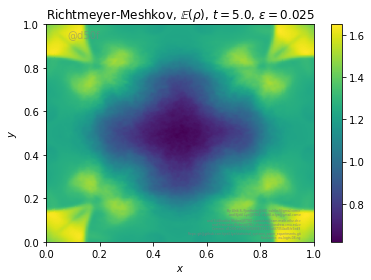

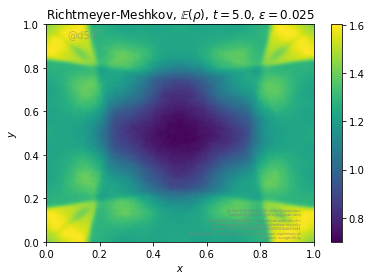

[0.76865951 0.47239835 0.14220564 0.14619185]


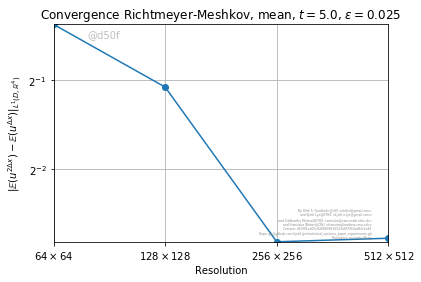

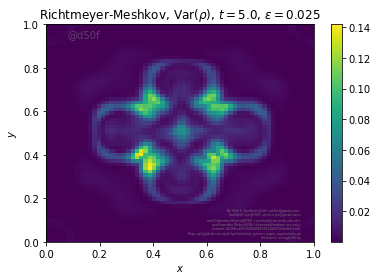

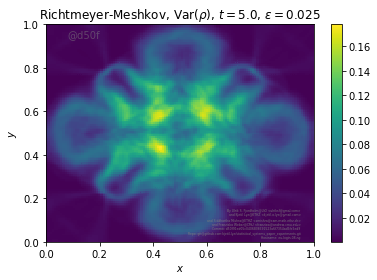

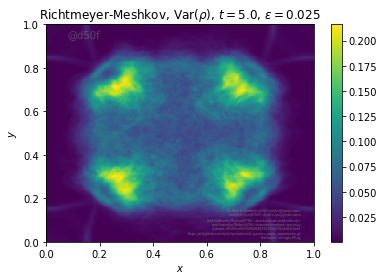

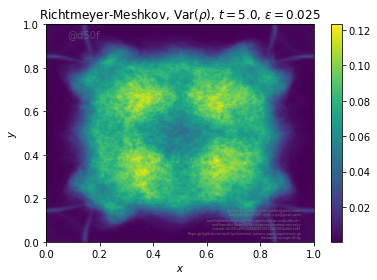

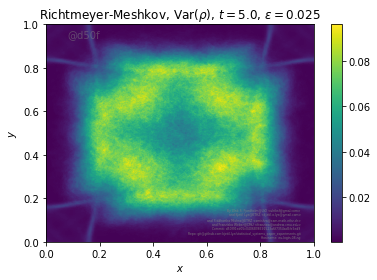

[0.06369076 0.05617368 0.02625984 0.03097048]


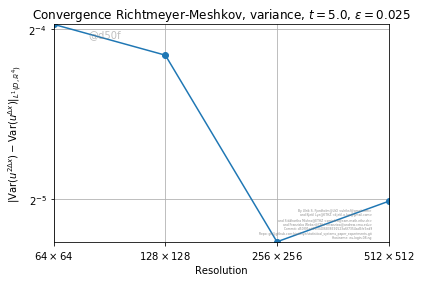

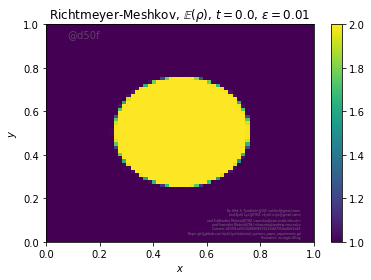

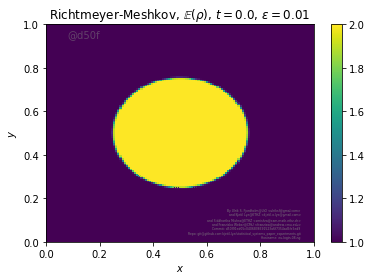

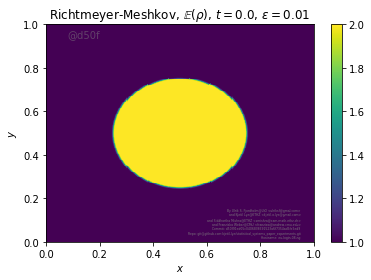

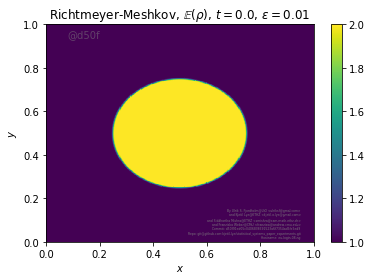

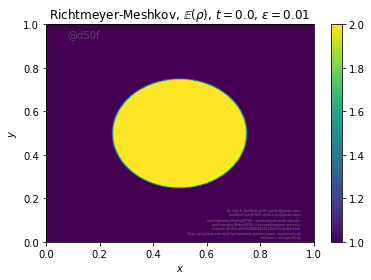

[0.10941601 0.05492932 0.03038658 0.01229735]


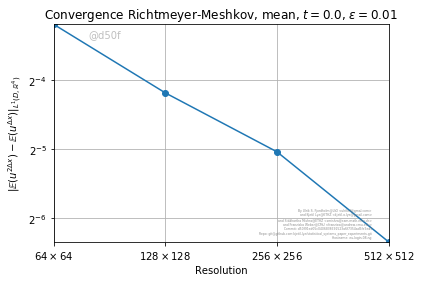

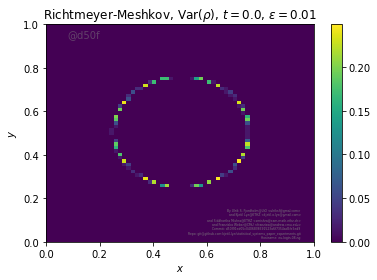

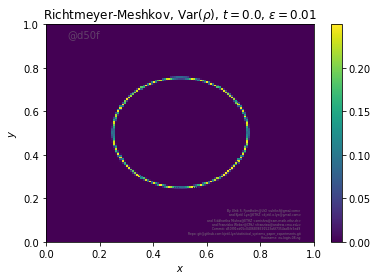

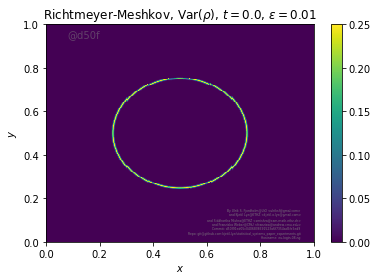

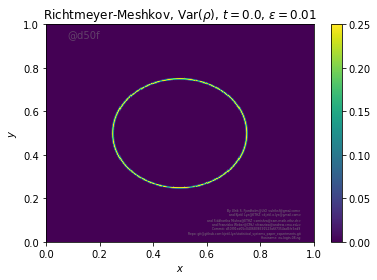

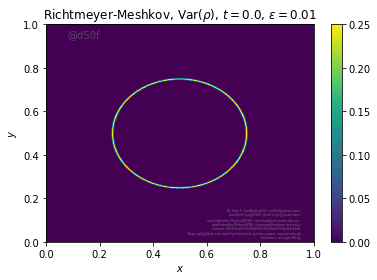

[0.00233359 0.00138458 0.00069587 0.00035299]


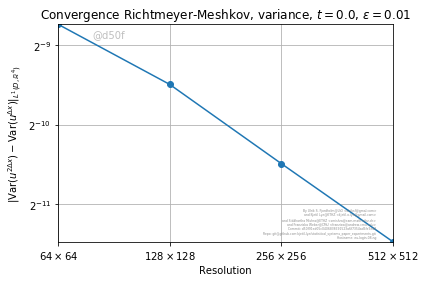

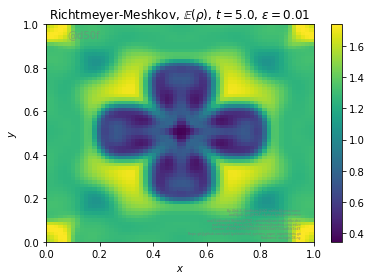

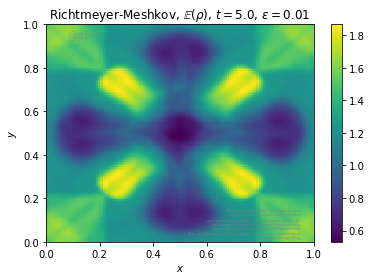

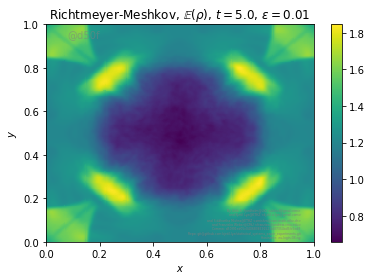

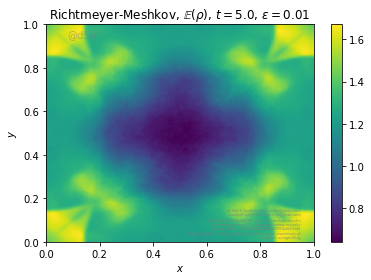

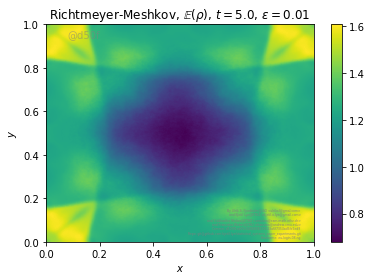

[0.81882651 0.53962904 0.18239556 0.16178222]


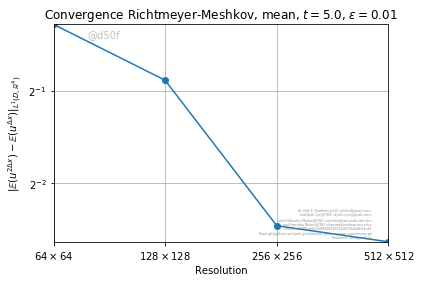

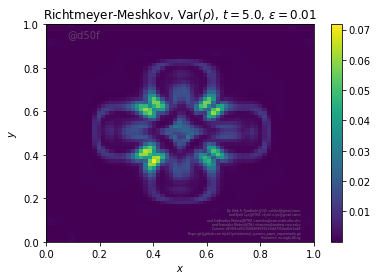

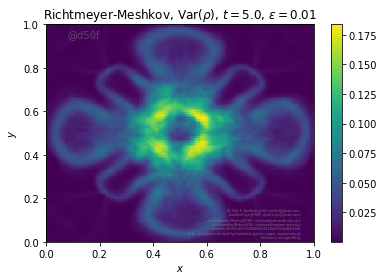

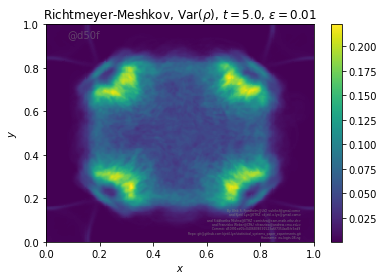

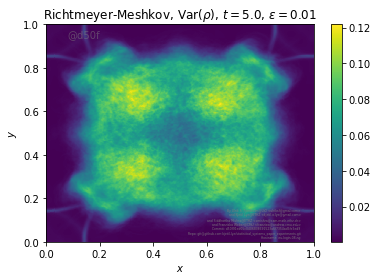

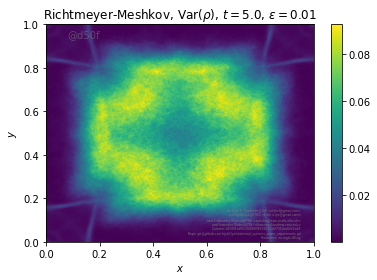

[0.04361571 0.05251141 0.03231864 0.03111663]


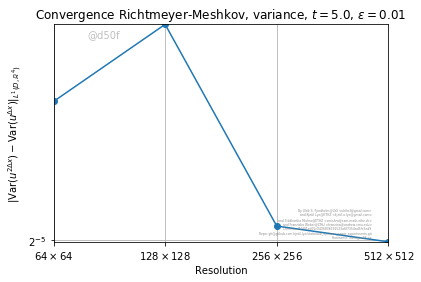

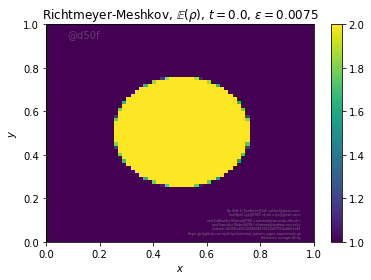

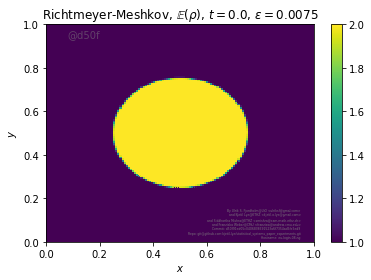

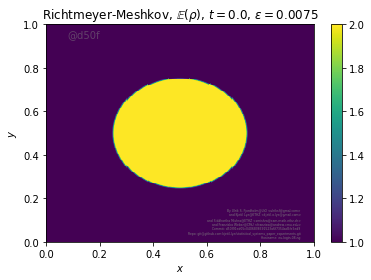

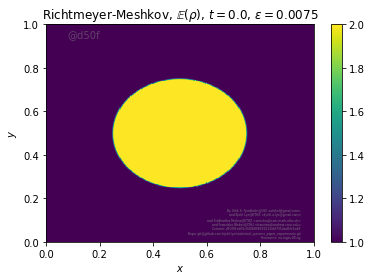

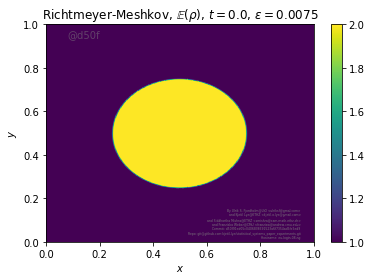

[0.10926437 0.05486912 0.03038138 0.01229246]


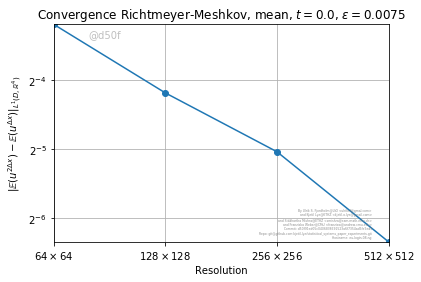

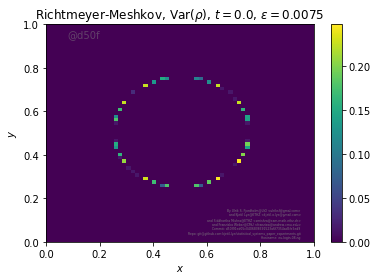

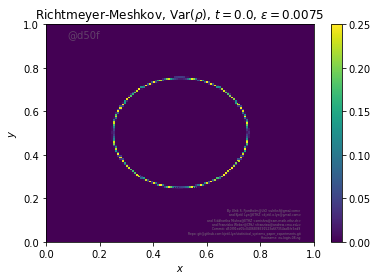

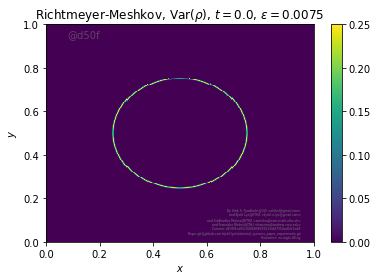

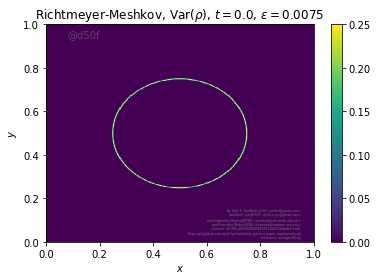

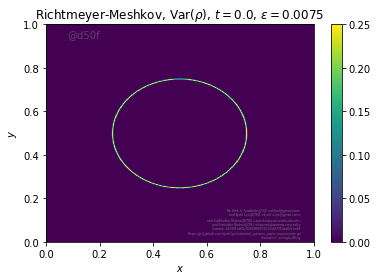

[0.0019917  0.00132421 0.0006935  0.00034894]


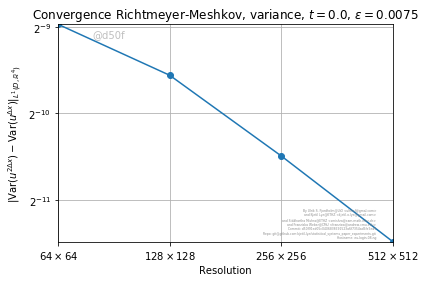

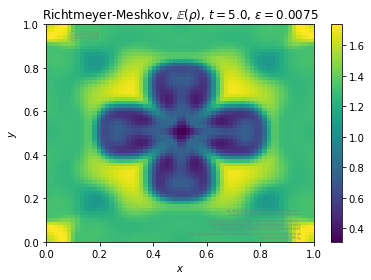

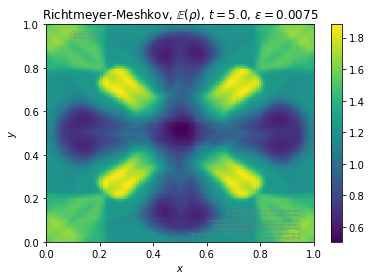

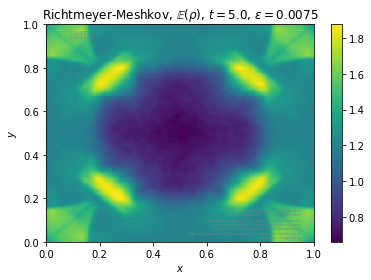

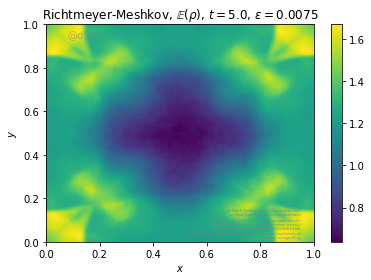

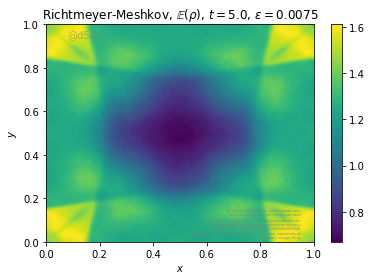

[0.82968714 0.55933839 0.19383964 0.16154493]


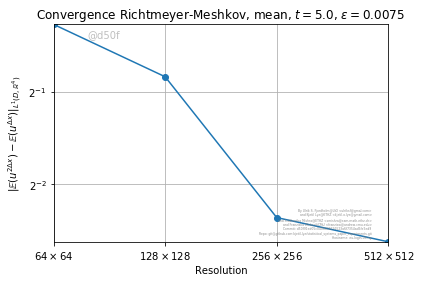

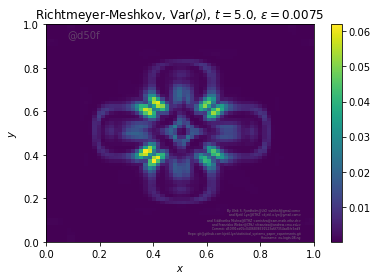

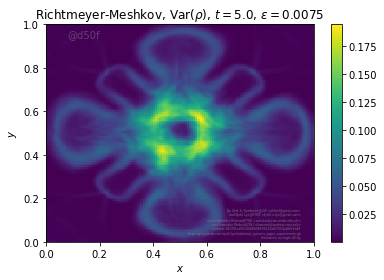

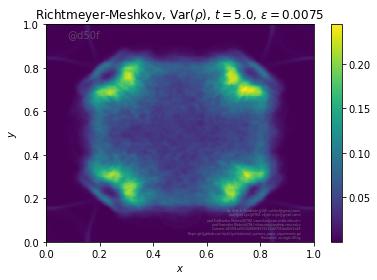

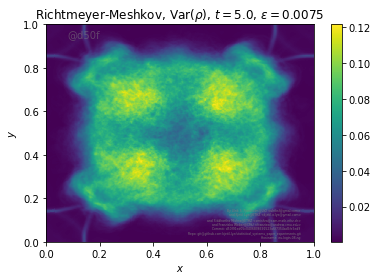

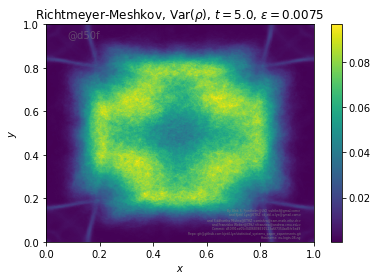

[0.03991342 0.05194424 0.03533798 0.03081829]


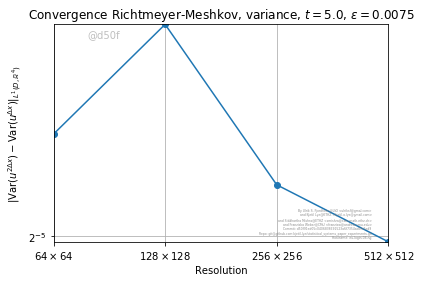

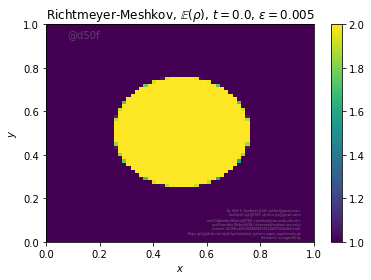

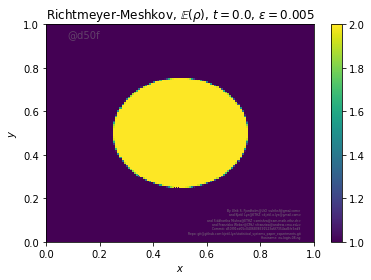

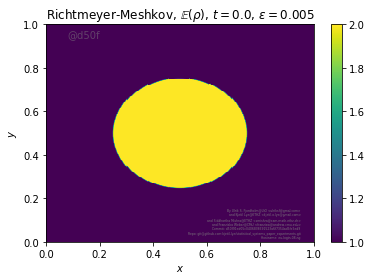

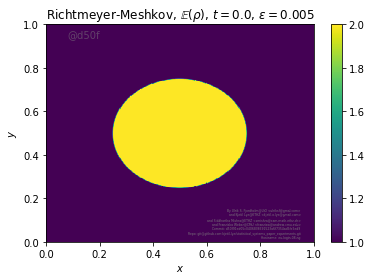

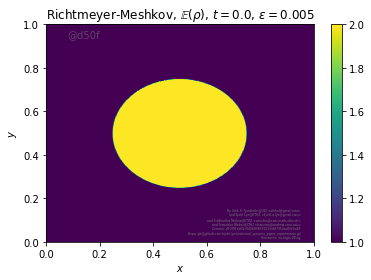

[0.10919714 0.05477983 0.03036477 0.01228883]


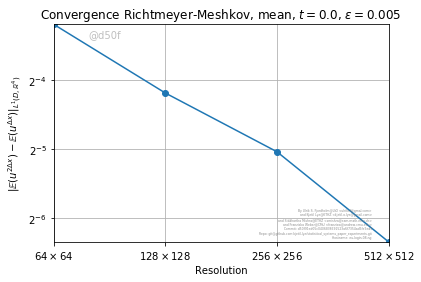

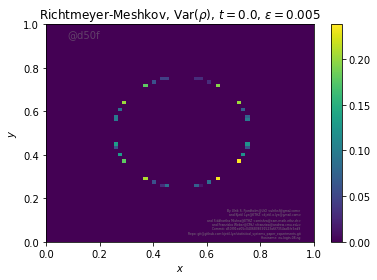

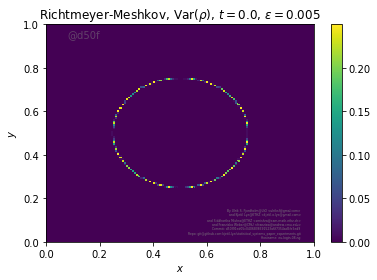

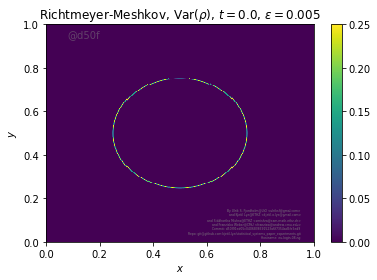

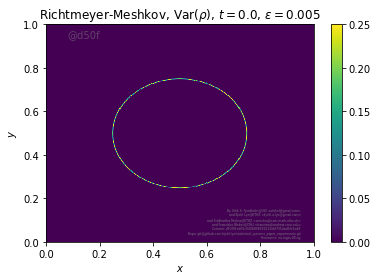

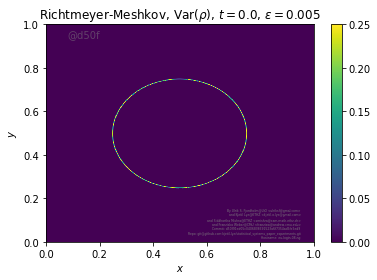

[0.00150027 0.00119527 0.00068158 0.00034561]


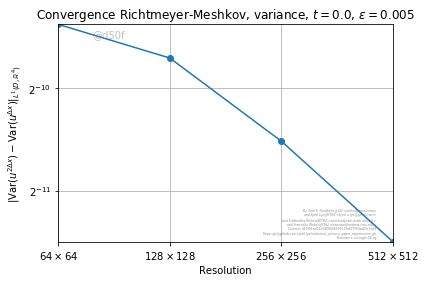

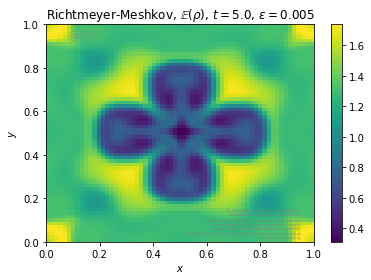

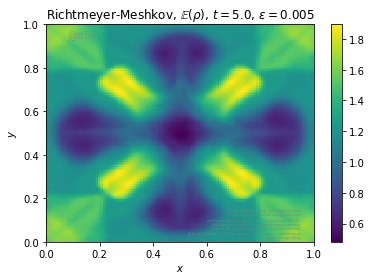

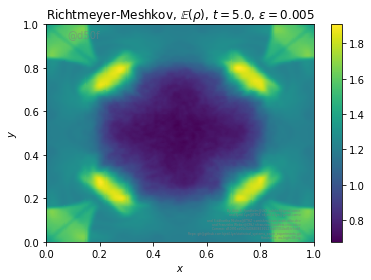

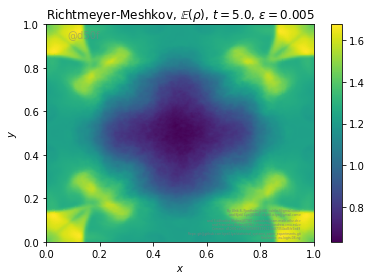

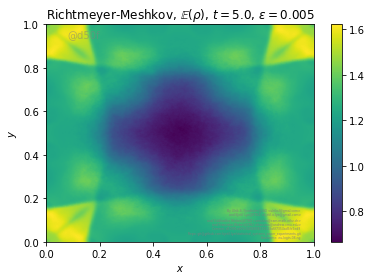

[0.83801996 0.5722457  0.2060504  0.16191642]


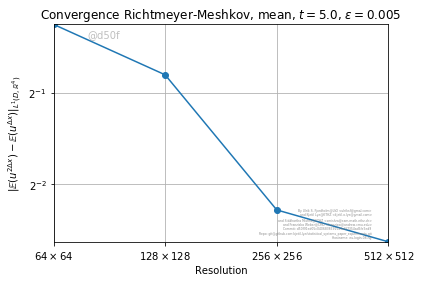

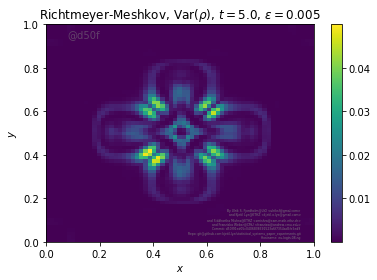

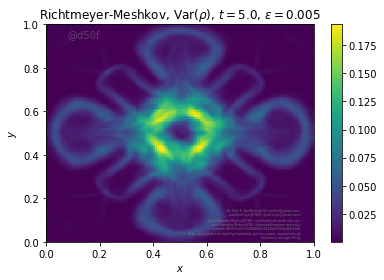

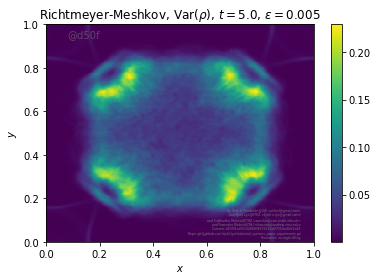

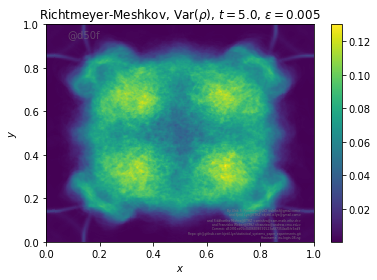

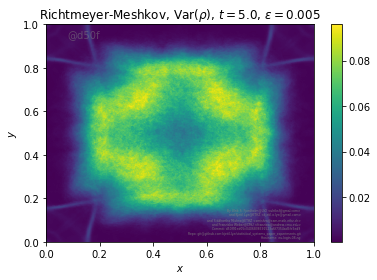

[0.03568132 0.0528921  0.03762386 0.03015493]


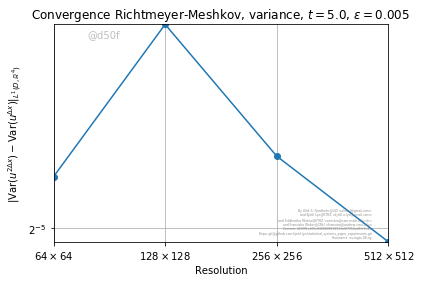

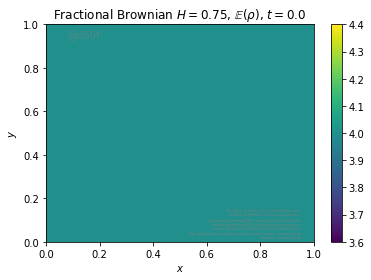

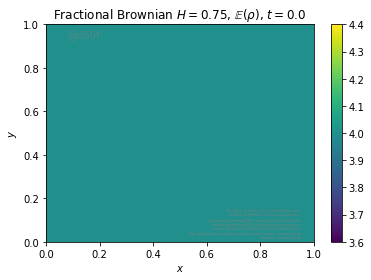

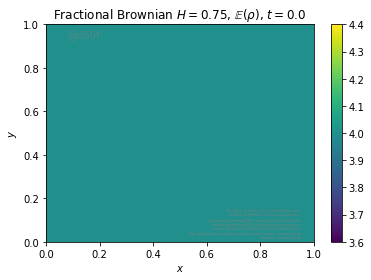

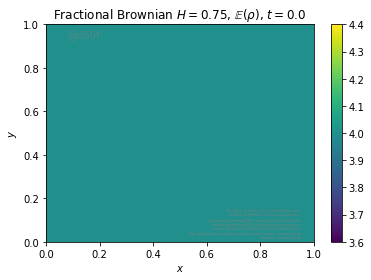

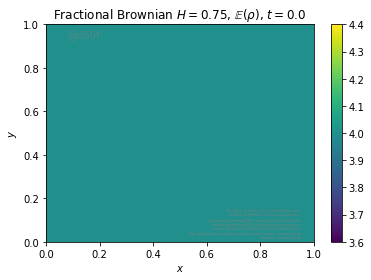

[0.13097301 0.11731223 0.05057558 0.04063707]


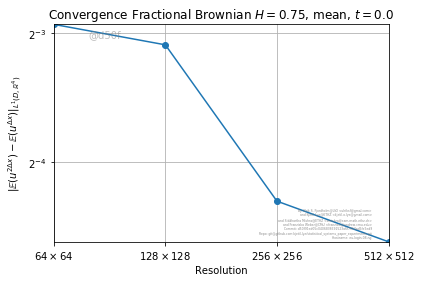

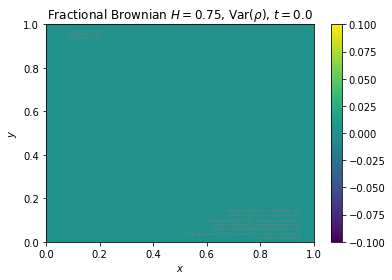

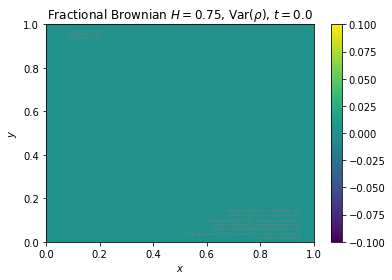

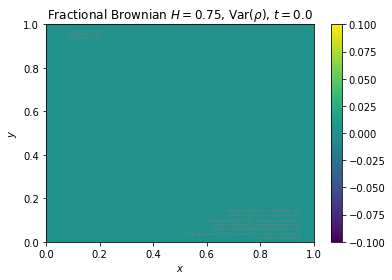

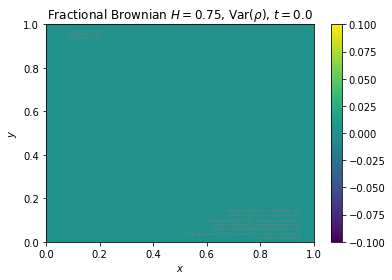

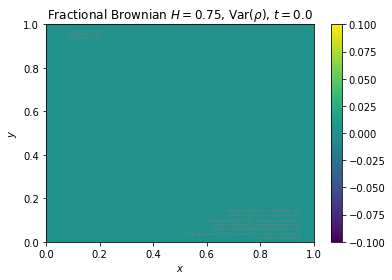

[0.17181406 0.11043055 0.07399399 0.04603022]


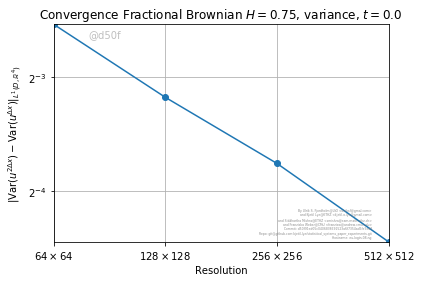

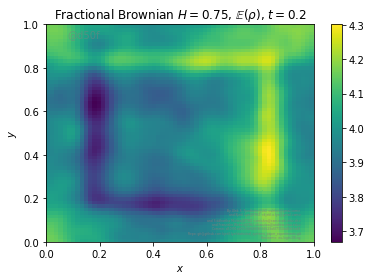

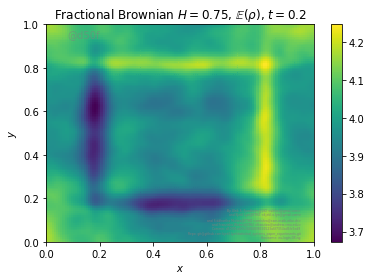

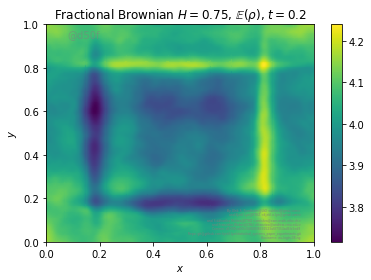

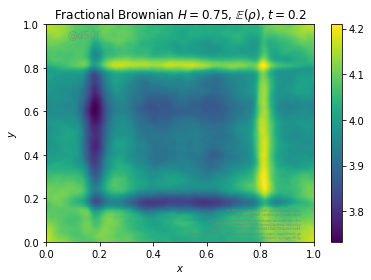

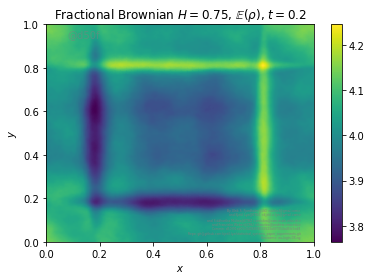

[0.22464659 0.21550878 0.08576141 0.08495637]


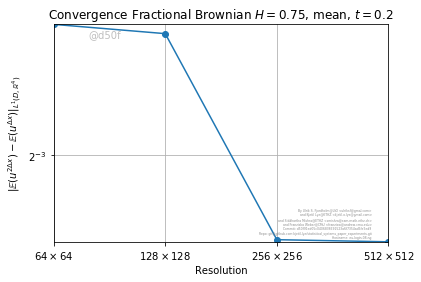

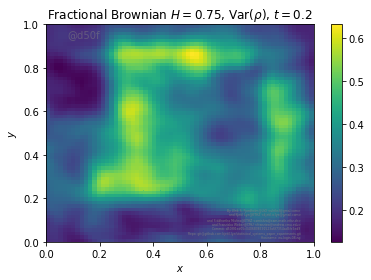

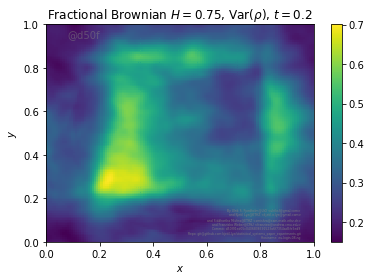

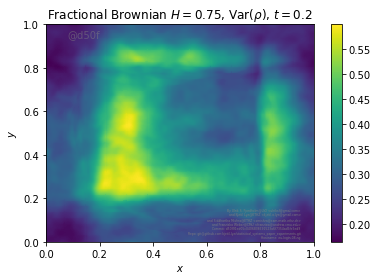

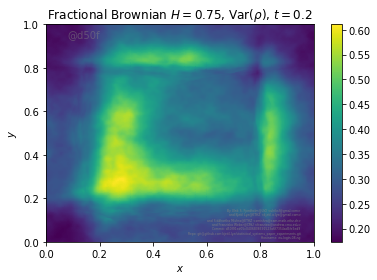

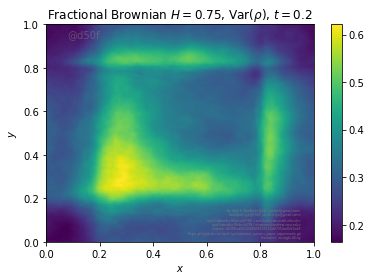

[0.35121174 0.28477555 0.15919689 0.11155375]


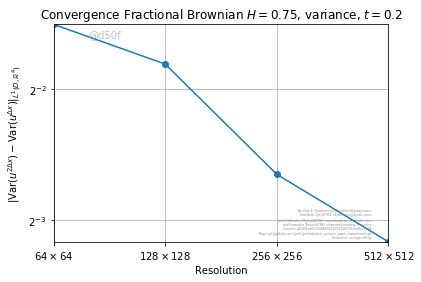

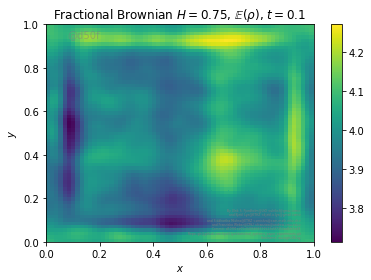

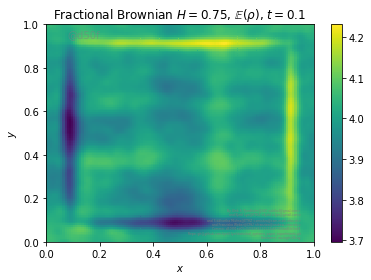

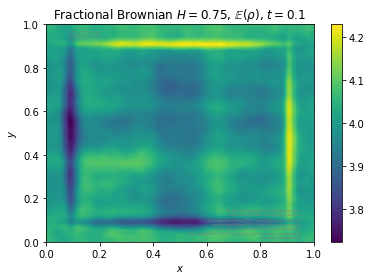

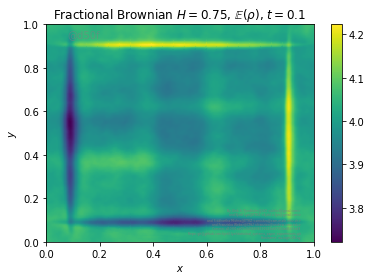

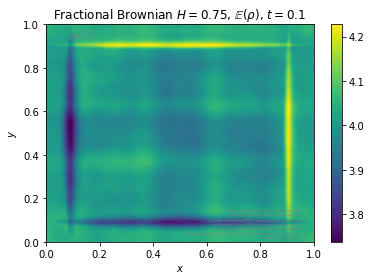

[0.23086614 0.1894589  0.09042126 0.07358248]


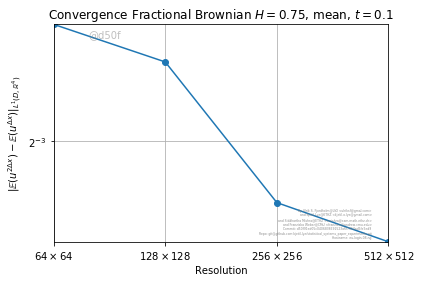

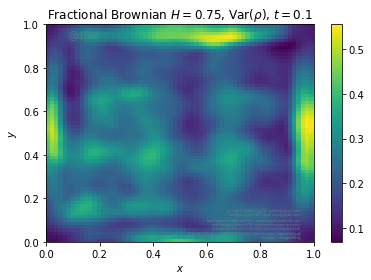

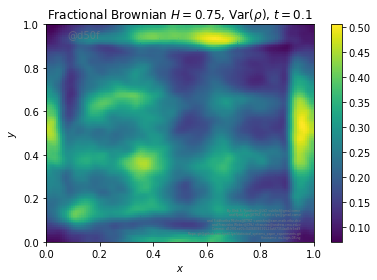

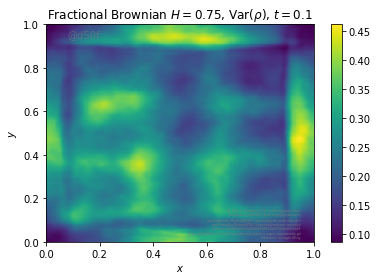

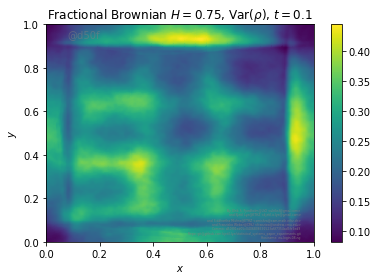

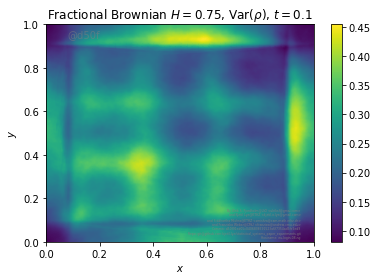

[0.30773592 0.21364036 0.16058429 0.10120566]


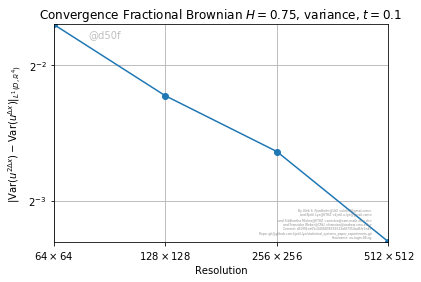

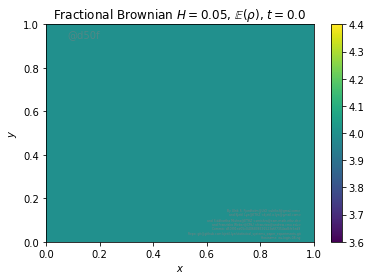

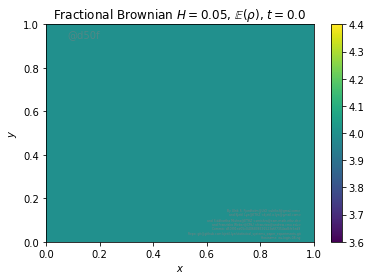

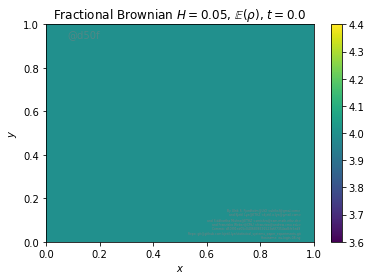

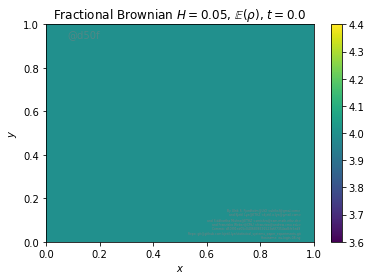

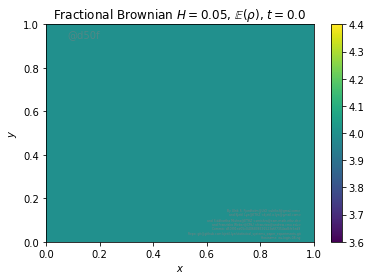

[1.51525041 1.26697864 0.94437285 0.78510068]


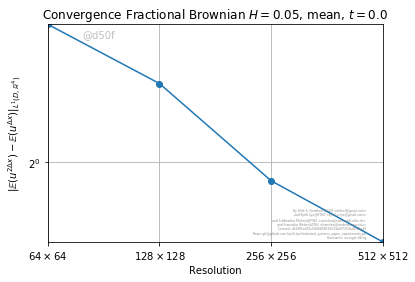

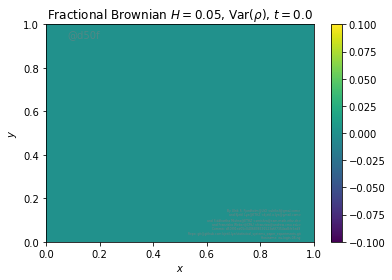

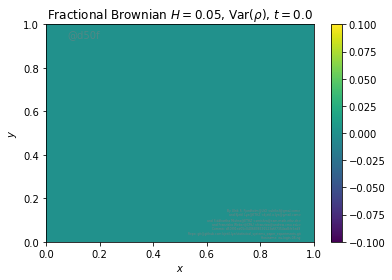

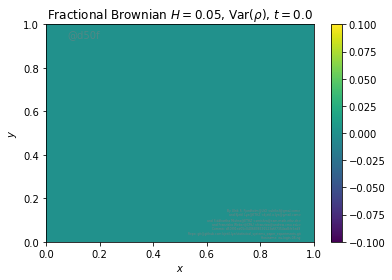

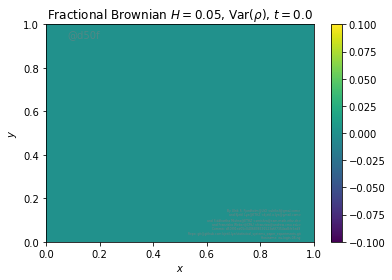

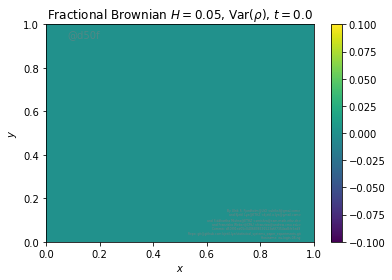

[17.43527146 15.71104272 13.31383396 11.93224083]


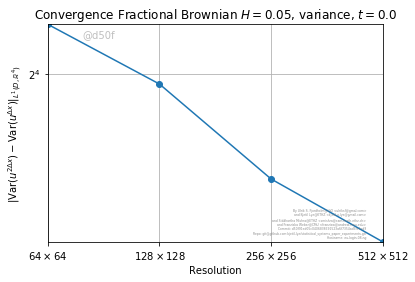

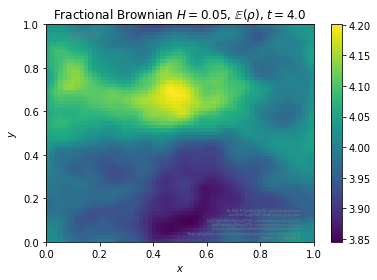

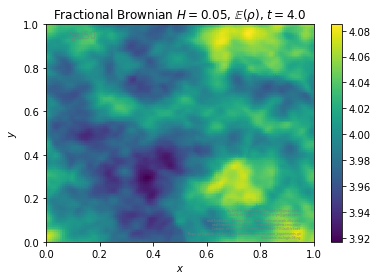

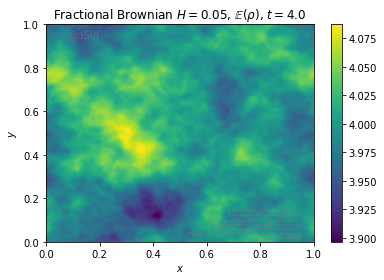

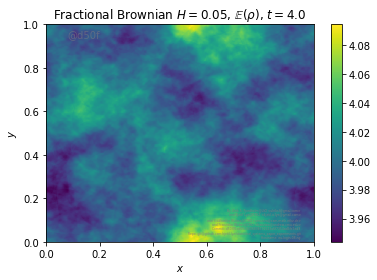

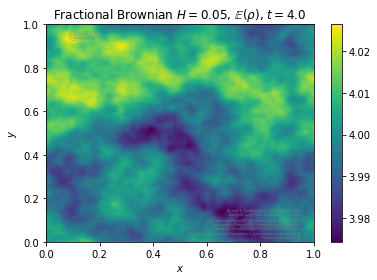

[0.94144664 0.87006937 0.60635601 0.55658244]


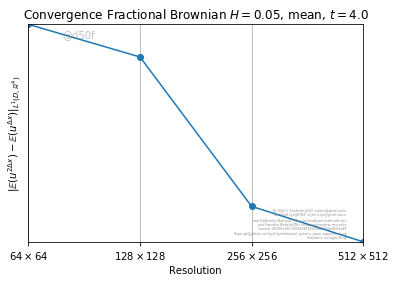

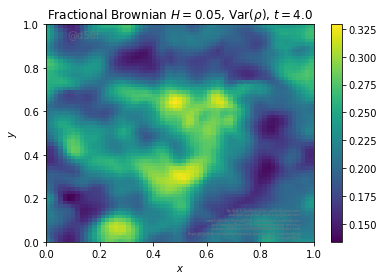

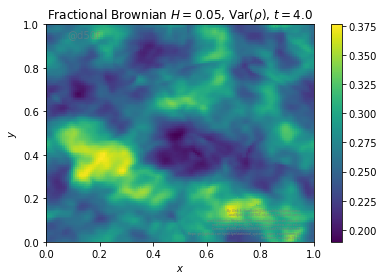

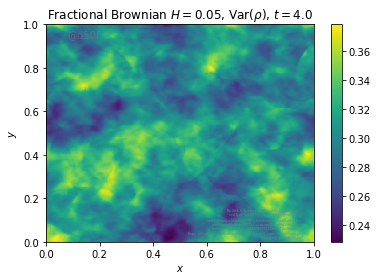

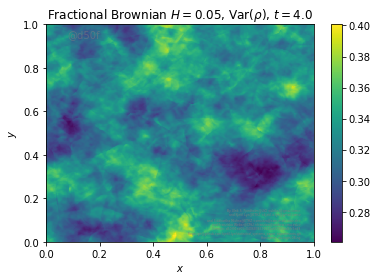

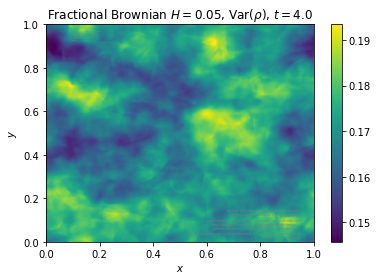

[2.33894439 2.31079038 1.58474898 5.03948553]


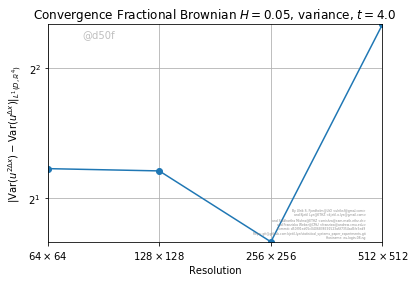

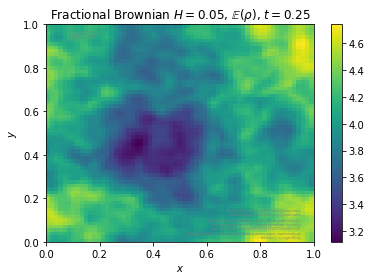

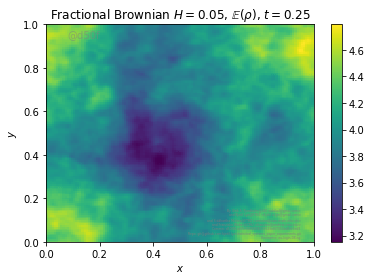

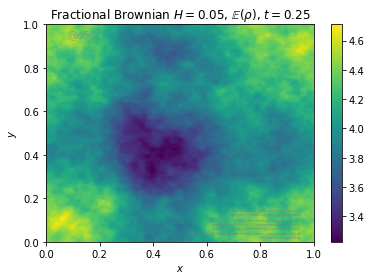

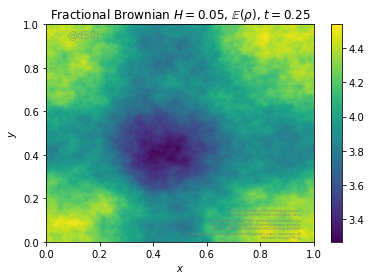

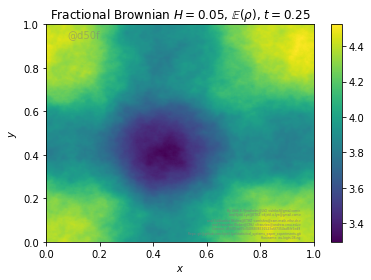

[1.06671919 0.99271142 0.70996198 0.5987324 ]


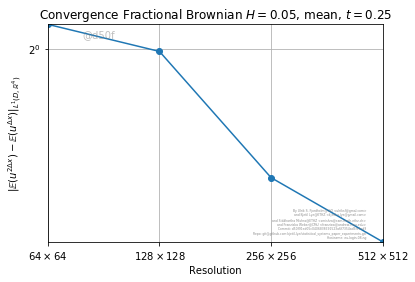

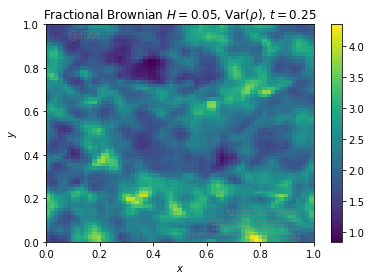

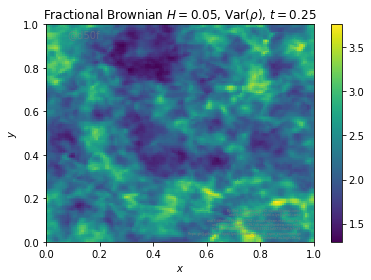

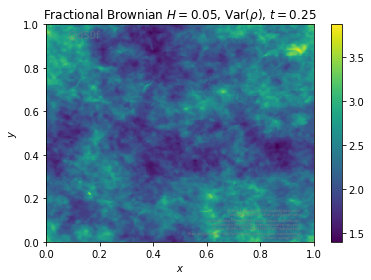

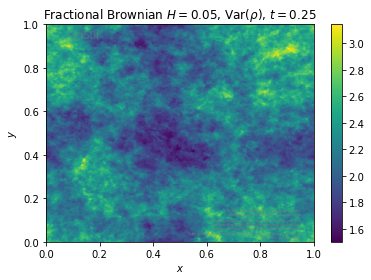

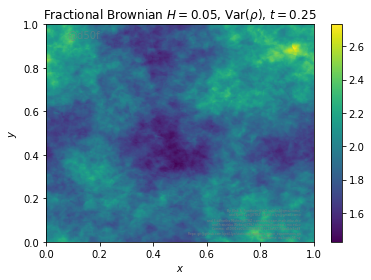

[9.61433338 8.07541114 5.64900636 7.78732899]


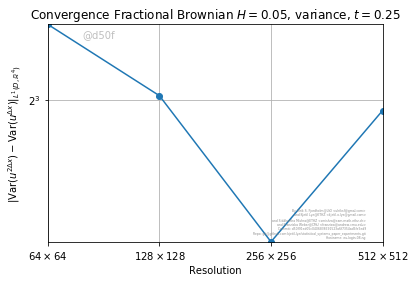

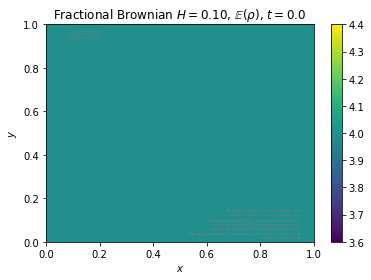

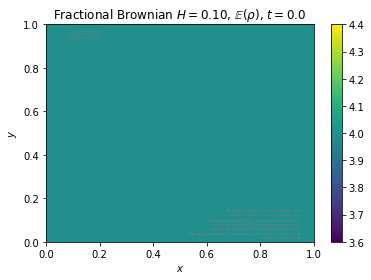

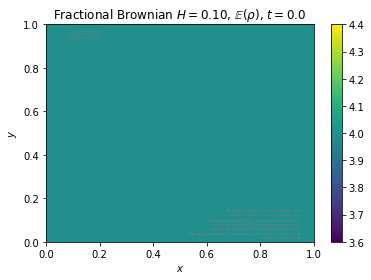

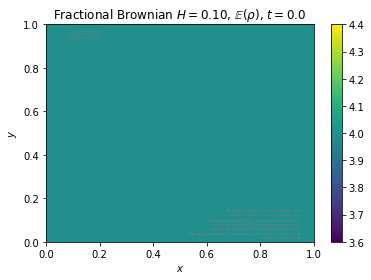

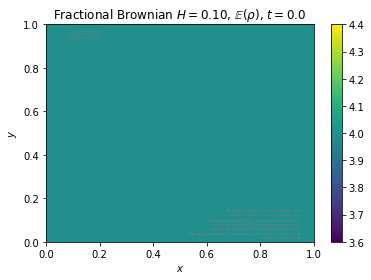

[1.11576787 0.89649959 0.60759998 0.4743031 ]


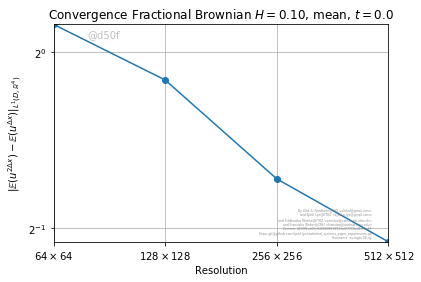

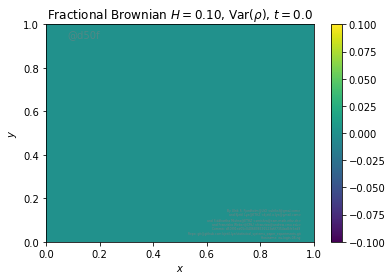

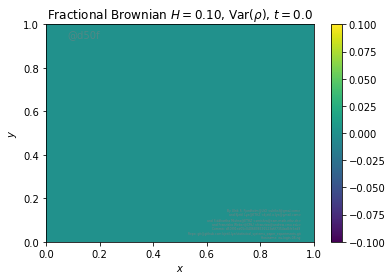

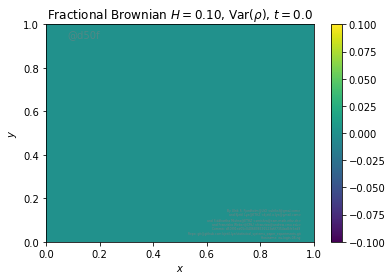

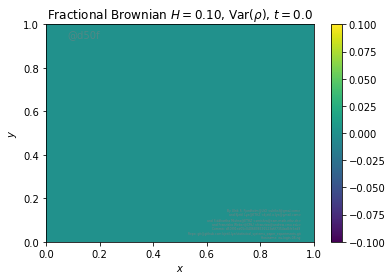

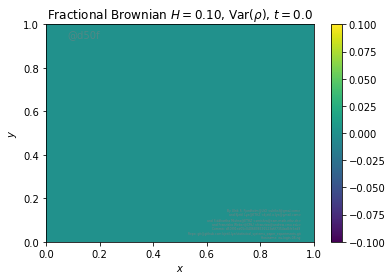

[9.73841793 8.04396344 6.11033668 4.91751335]


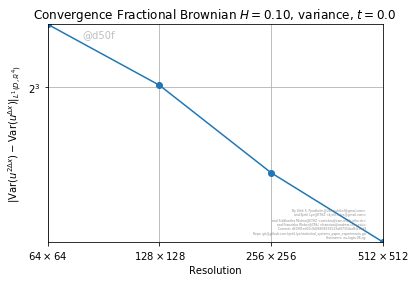

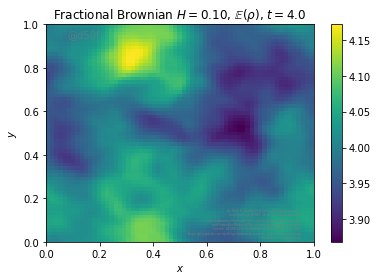

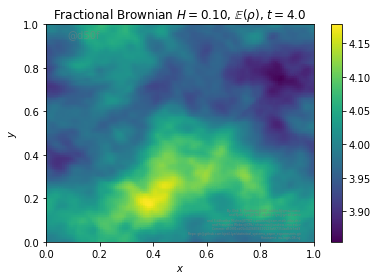

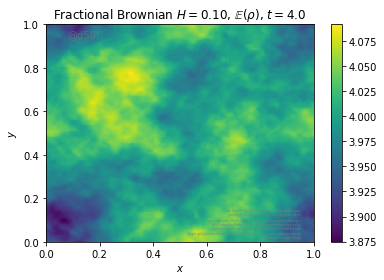

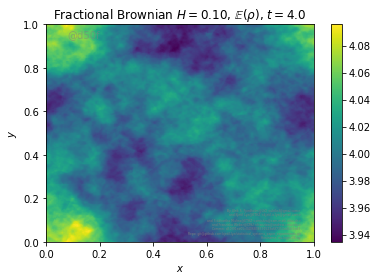

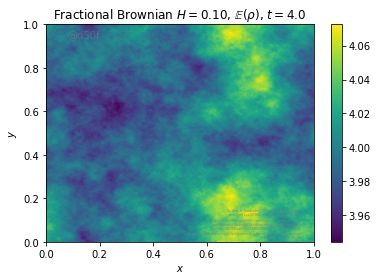

[0.67341877 0.68408058 0.41148833 0.33923441]


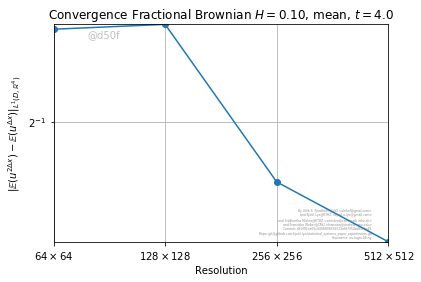

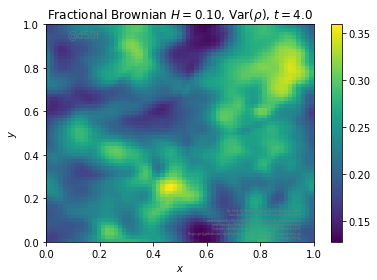

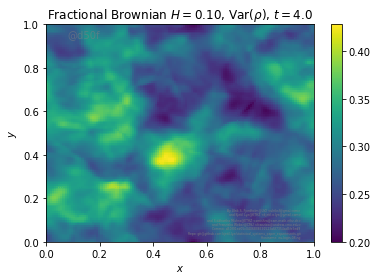

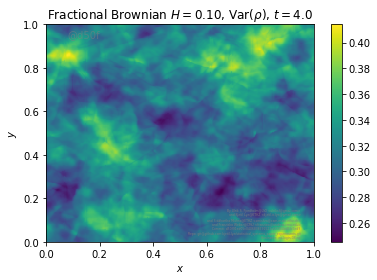

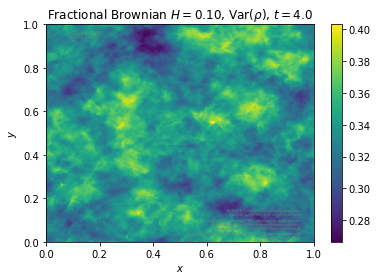

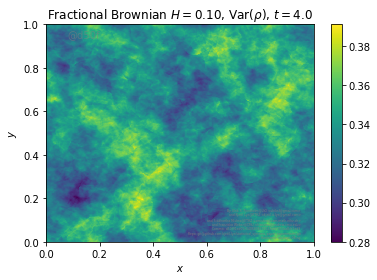

[1.7942975  1.48921174 0.97224309 0.65824201]


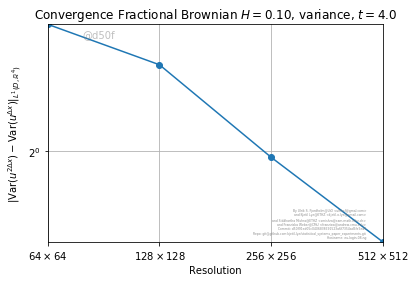

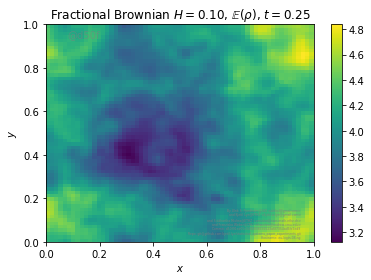

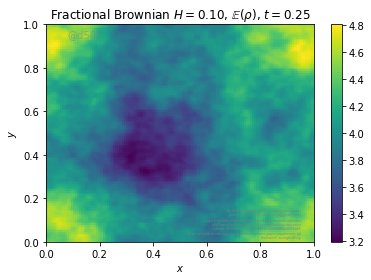

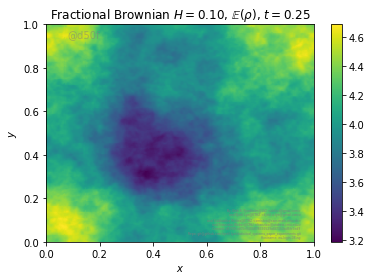

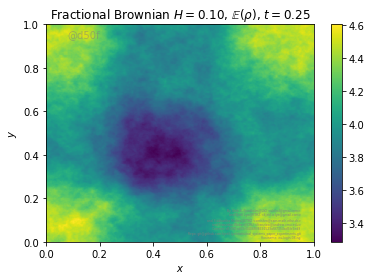

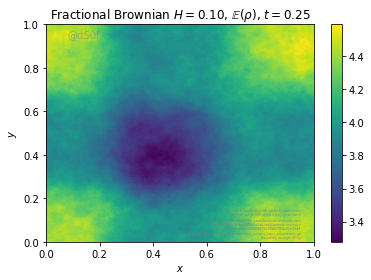

[0.84248879 0.76481656 0.48992951 0.38263045]


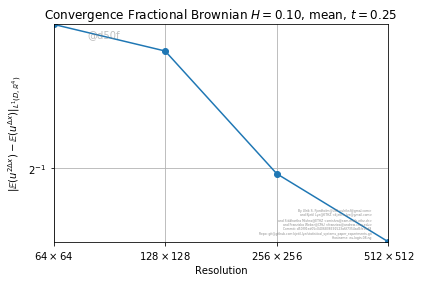

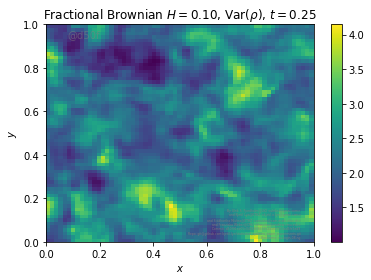

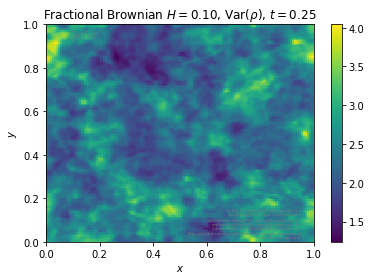

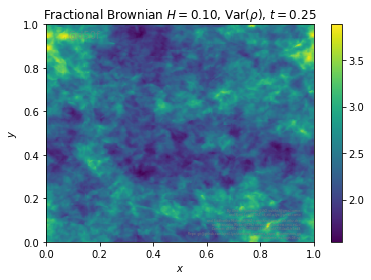

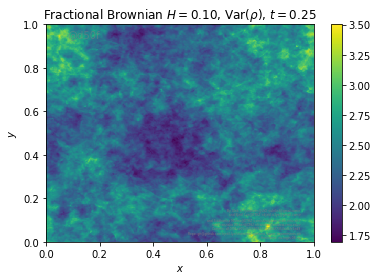

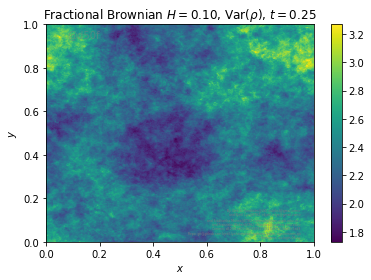

[7.9210951  6.36427091 4.27565428 3.16131407]


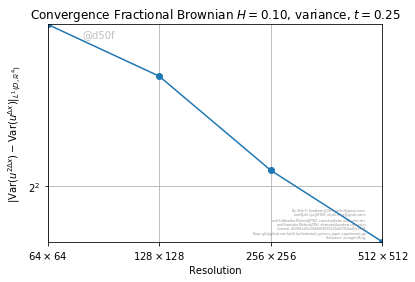

In [4]:
def plot_mean_var_convergence(configuration):
    perturbations = configuration['perturbations']
    Tarray = configuration['Tarray']
    resolutions = configuration['resolutions']
    stat_filename = configuration['stat_filename']
    name = configuration['name']
    maxT = configuration['maxT']
    
    # Here we only care about certain configurations (others not relevant)
    if 'richtmeyer' not in name.lower() and 'kelvin' not in name.lower() and 'brownian' not in name.lower():
        return
    for perturbation in perturbations:
        timeArray = [Tarray[0], Tarray[-1]]
        if 'kelvin' in name.lower():
            timeArray = Tarray
            
        if Tarray[1] not in timeArray:
            timeArray.append(Tarray[1])
        for time in timeArray:
            for stat in ['mean', 'variance']:
                errors = zeros(len(resolutions)-1)
                for var in ['rho','E','mx','my']:
                    for (nr, r) in enumerate(resolutions):
                        filename = stat_filename.format(stat=stat,t=time, perturbation=perturbation, resolution=r)
                        
                        basepath = plot_info.get_environment("STATISTICAL_STRUCTURE", [filename])
                        #print stat_filename.format(stat=stat,t=time, perturbation=perturbation, resolution=r)
                        with netCDF4.Dataset(os.path.join(basepath, filename)) as f:
                            d = f.variables[var][:,:,0].T
                            N = d.shape[0]


                            if r > resolutions[0]:
                                errors[nr-1] += (sum(abs(d-dPrev))/r**2)
                            dPrev = repeat(d,2,0)
                            dPrev = repeat(dPrev,2,1)
                            if var == 'rho':
                                if stat == 'variance':
                                    statName = '\\mathrm{Var}'
                                elif stat == 'mean':
                                    statName = '\\mathbb{E}'
                                x,y = mgrid[0:1:N*1j,0:1:N*1j]
                                plt.pcolormesh(x,y,d)
                                plt.colorbar()
                                if len(perturbations) > 1:
                                    plt.title('{name}, ${stat} (\\rho)$, $t={time}$, $\\varepsilon={perturbation}$'.format(name=name, time=maxT*time/(float(max(Tarray))), stat=statName, perturbation=perturbation))
                                else:
                                    plt.title('{name}, ${stat}(\\rho)$, $t={time}$'.format(name=name,time=maxT*time/(float(max(Tarray))), stat=statName, perturbation=perturbation))


                                plt.xlabel('$x$')
                                plt.ylabel('$y$')
                                showAndSave('%s_%s_%d_%.4f_%d' %(stat,name.replace('$','').replace(' ','_').replace('=',''), r,perturbation,time))
                print (errors )
                plt.xlim(resolutions[0], resolutions[-2])  
                plt.ylim(min(errors),max(errors))
                plt.loglog(resolutions[:-1], errors, '-o', basex=2, basey=2)
                plt.xlabel('Resolution')
                if stat == 'mean':
                    plt.ylabel('$\|\\mathbb{E}(u^{2\Delta x})-\\mathbb{E}(u^{\Delta x})\|_{L^1(D,\\mathbb{R}^4)}$')
                elif stat == 'variance':
                    plt.ylabel('$\|\\mathrm{Var}(u^{2\Delta x})-\\mathrm{Var}(u^{\Delta x})\|_{L^1(D,\\mathbb{R}^4)}$')

                if len(perturbations)>1:
                    plt.title('Convergence {name}, {stat}, $t={time}$, $\\varepsilon={perturbation}$'.format(name=name,time=maxT*time/(float(max(Tarray))), stat=stat, perturbation=perturbation))
                else:
                    plt.title('Convergence {name}, {stat}, $t={time}$'.format(name=name, time=maxT*time/(float(max(Tarray))), stat=stat, perturbation=perturbation))
                plt.xticks(resolutions[:-1], ['${r} \\times {r}$'.format(r=r) for r in resolutions[:-1]])

                plt.grid(True)
                showAndSave('convergence_%s_%s_%.4f_%d' %(stat,name.replace('$','').replace(' ','_').replace('=','') ,perturbation,time))
                
for_each_config(plot_mean_var_convergence)

/cluster/home/klye/.local/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


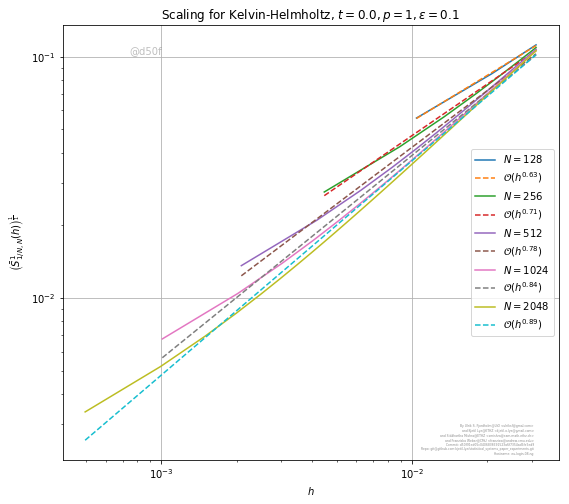

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


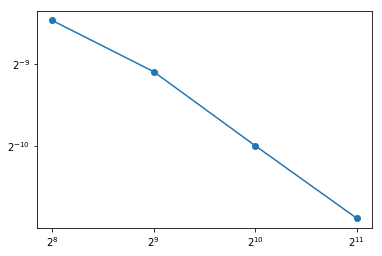

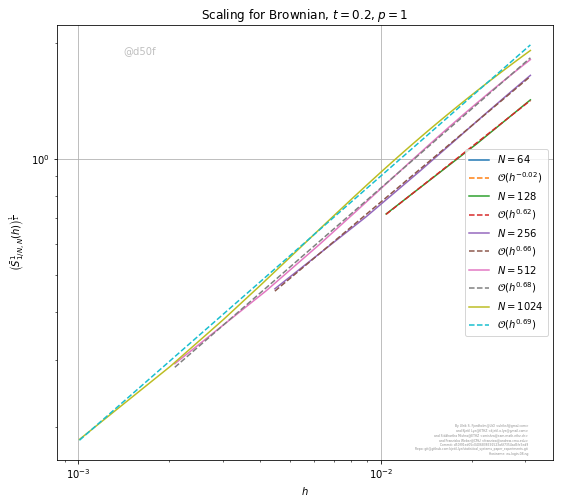

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


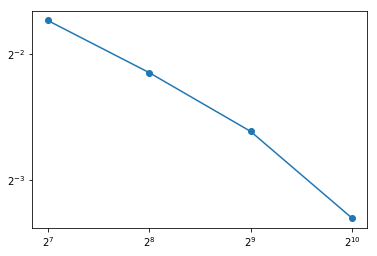

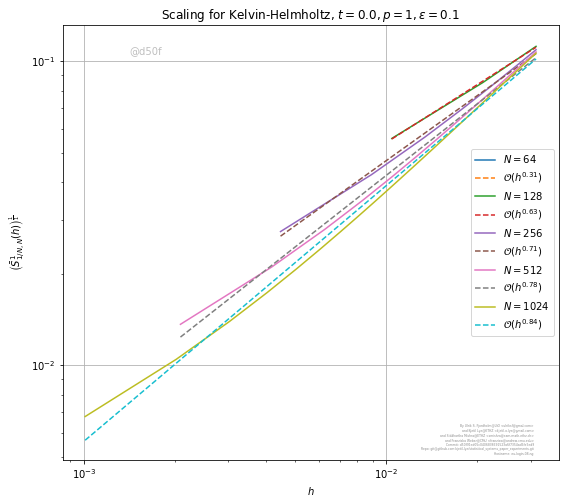

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


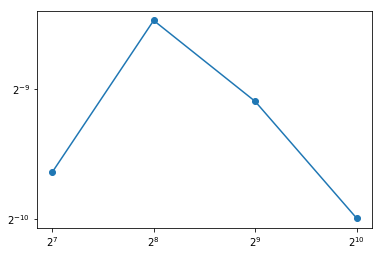

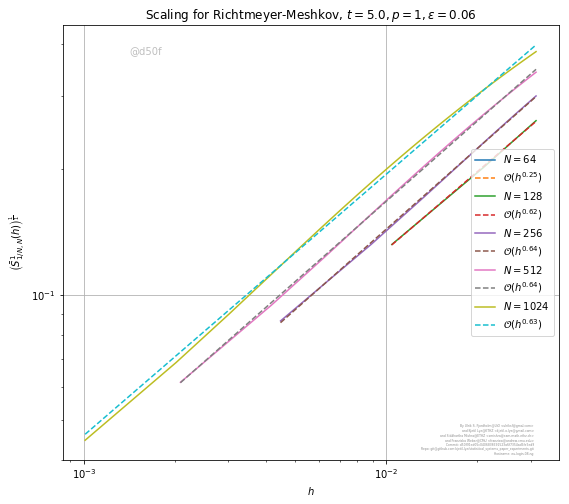

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


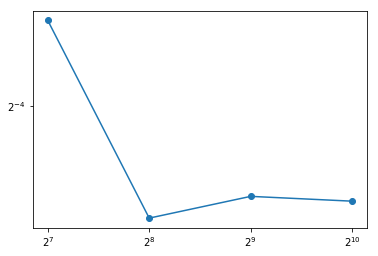

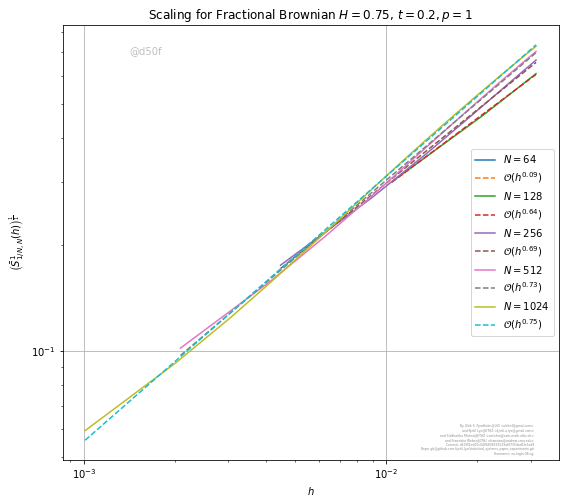

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


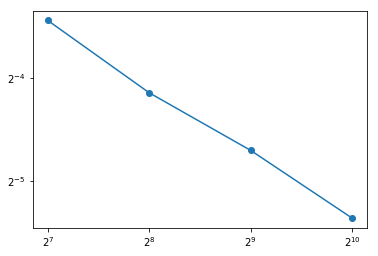

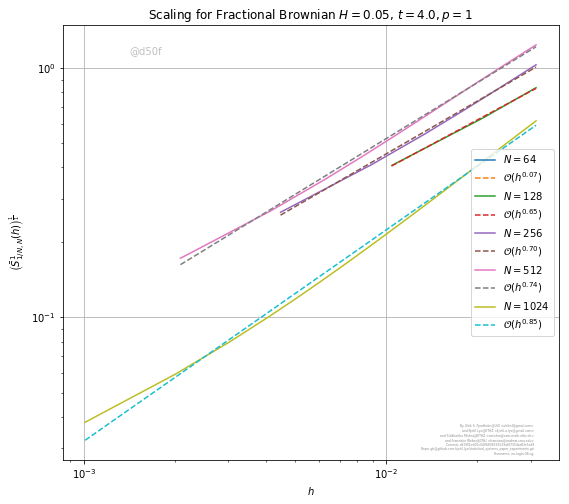

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


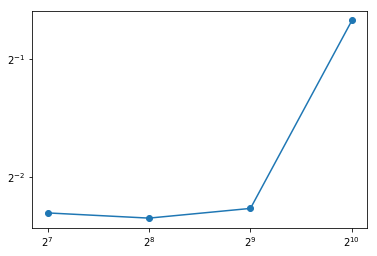

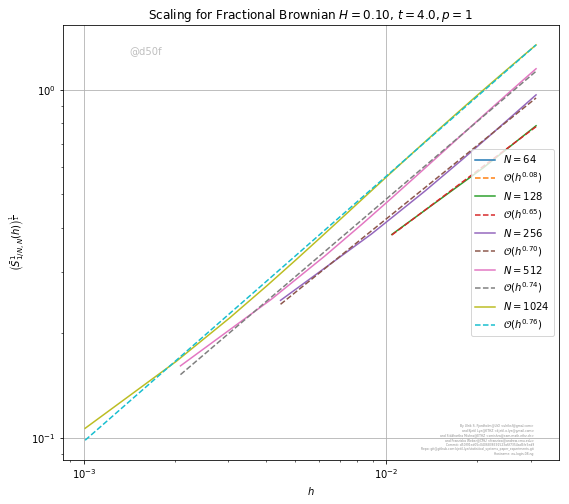

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


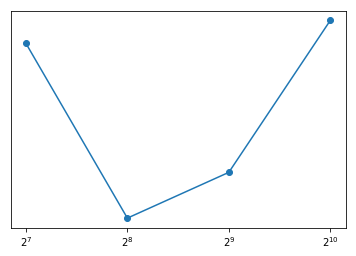

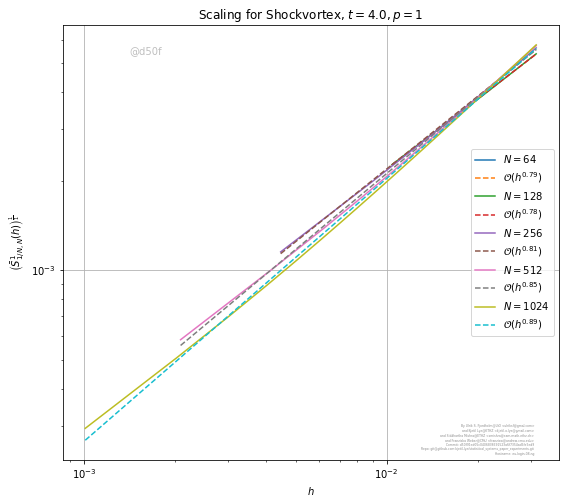

/cluster/home/klye/.local/lib/python3.6/site-packages/ipykernel_launcher.py:42: RankWarning: Polyfit may be poorly conditioned


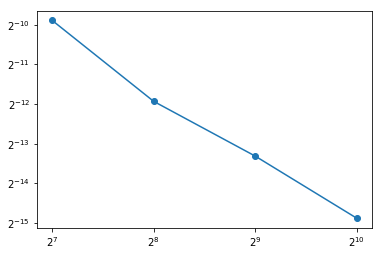

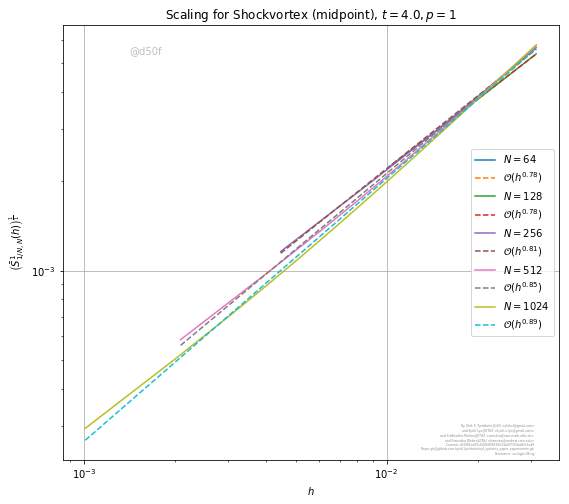

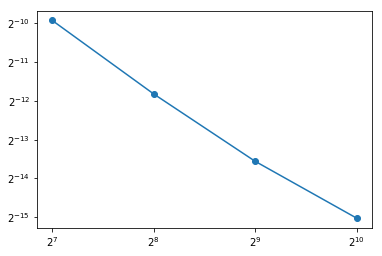

In [5]:
def convergence_structure_functions(config):
    headline("Component convergence Box averaged structure functions")
    variables = ['rho', 'mx','my','E']
    perturbations = config['perturbations']
    Tarray = config['Tarray']
    resolutions = config['resolutions']
    cube_filename = config['cube_filename']
    name = config['name']
    maxT = config['maxT']
    for perturbation in perturbations:
        h2("perturbation = %.2f" % perturbation)
        for p in [1,2,3]:
            h3("p = %d" % p)
            timeArray = [Tarray[-1]]
            if 'kelvin' in name.lower():
                timeArray = Tarray
            if Tarray[1] not in timeArray:
                timeArray.append(Tarray[1])
            for t in timeArray:
                h4("t = %d" % (0.2*t))

                errors = zeros(len(resolutions)-1)


                for (nr, resolution) in enumerate(resolutions):
                    dVar = zeros((64*resolution)//2048)
                    for variable in variables:

                        filename = cube_filename.format(perturbation = perturbation, p=p,t=t,resolution=resolution)

                        d = getlineintegral(filename, variable, resolution)


                        dVar += d
                    dVar = dVar**(1.0/p)
                    if resolution > resolutions[0]:
                        errors[nr-1] = abs(dVar[-1]-dPrev[-1])
                    dPrev = repeat(dVar,2,0)
                    if len(perturbations) > 1:
                        title = 'Scaling for {name}, $t={time},p={p},\\varepsilon={perturbation}$'.format(name=name,time=t*maxT/float(len(Tarray)-1),p=p,perturbation=perturbation)
                    else:
                        title = 'Scaling for {name}, $t={time},p={p}$'.format(name=name,time=t*maxT/float(max(Tarray)),p=p,perturbation=perturbation)

                    plotscalings(dVar, resolution, title, False)
                    plt.xlabel('$h$')
                    plt.ylabel('$\\left(\\bar{S}^{%d}_{1/N,N}(h)\\right)^{\\frac{1}{%d}}$' % (p,p))
                for nr in range(len(resolutions)-1):
                    errors[nr] = abs(errors[nr])

                showAndSave('scaling_{name}_{p}_{perturbation}_{time}'.format(name=name.replace('$','').replace(' ',"_").replace('=',''), p=p, perturbation=perturbation, time=t))
                plt.loglog(resolutions[1:],errors,'-o',label='%s' % variable, basex=2, basey=2)
                
                plt.ylim([2.0**(np.floor(np.log2(min(error))))/1.1, 1.1*2.0**(np.ceil(np.log2(max(error))))])
                if len(perturbations)>1:
                    title = '{name}, $p={p}, t={t}, \\varepsilon={perturbation}$'.format(name=name, perturbation=perturbation, p=p,t=t*maxT/float(max(Tarray)))
                else:
                    title = '{name}, $p={p}, t={t}$'.format(name=name, perturbation=perturbation, p=p,t=t*maxT/float(max(Tarray)))

                #plt.title('{name}, $p={p}, t={t}, \\varepsilon={perturbation}$'.format(name=name, perturbation=perturbation, p=p,t=t*maxT/float(max(Tarray))))

                plt.title(title)
                plt.xlabel('Resolution')
                plt.ylabel('$||S^{%d}_{\Delta x,M}(h_{\\max})-S^{%d}_{2\Delta x,M}(h_{\\max})||$' % (p,p) )
                plt.grid('on')
                plt.xticks(resolutions[1:], ['${r} \\times {r}$'.format(r=r) for r in resolutions[1:]])
                showAndSave('convergence_{name}_{p}_{perturbation}_{time}'.format(name=name.replace('$','').replace(' ',"_").replace('=',''), p=p, perturbation=perturbation, time=t))
                
for_each_config(convergence_structure_functions)

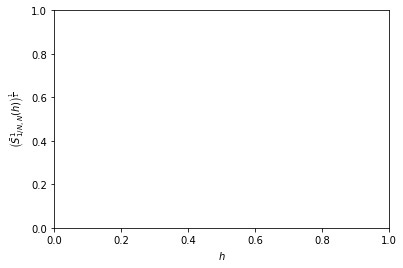

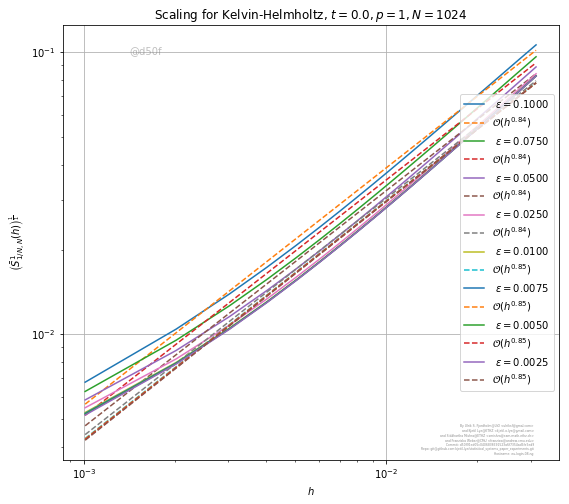

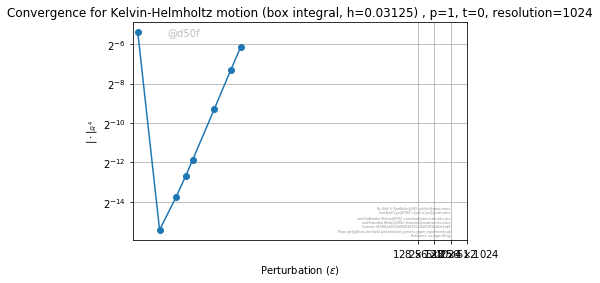

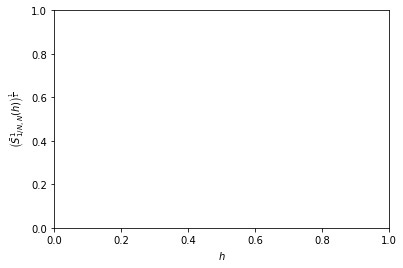

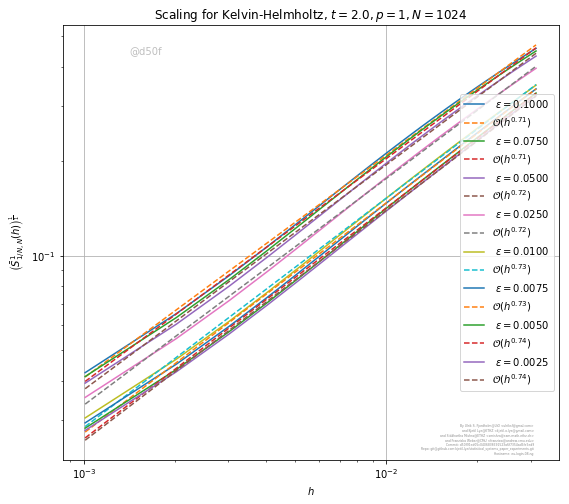

...

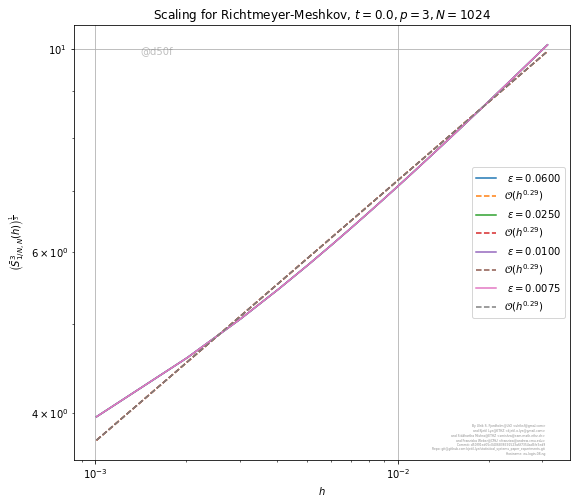

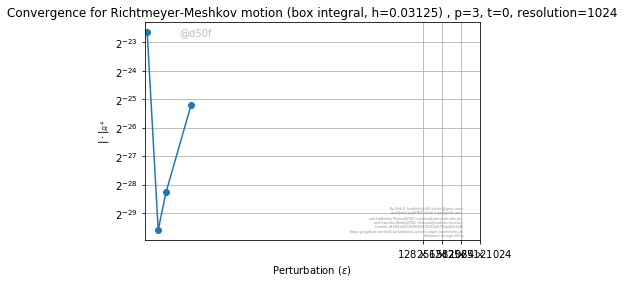

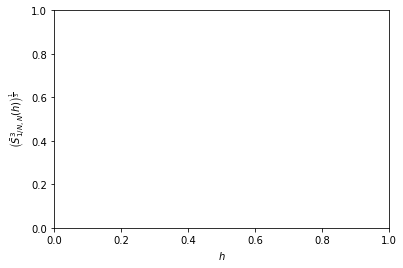

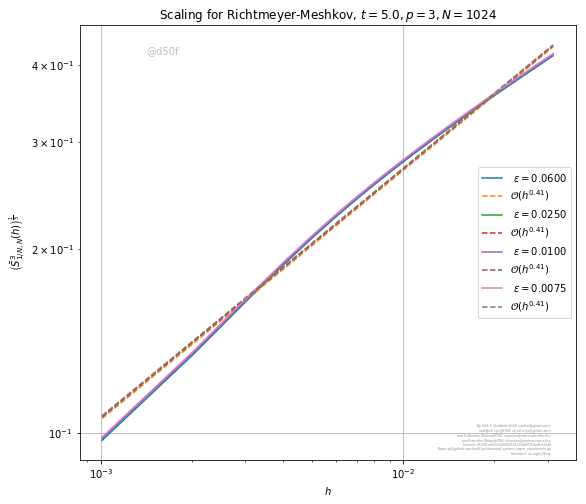

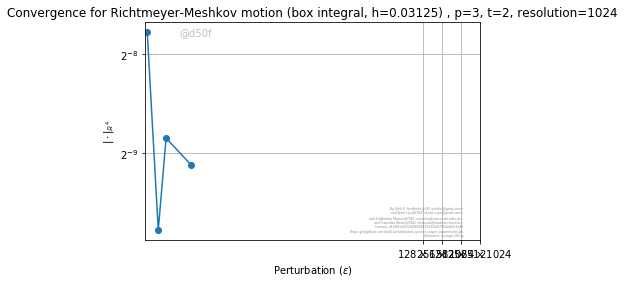

In [6]:
def convergence_structure_functions_perturbation(config):
    resolutions = config['resolutions']
    name = config['name']
    cube_filename = config['cube_filename']
    Tarray = config['Tarray']
    perturbations = config['perturbations']
    maxT = config['maxT']
    
    headline("Component convergence Box averaged structure functions(perturbation convergence)")
    resolution = resolutions[len(resolutions)-1]
    variables = ['rho', 'mx','my','E']

    for p in [1,2,3]:
        h3("p = %d" % p)
        for t in [Tarray[0], Tarray[1]]:
            h4("t = %d" % (0.2*t))

            errors = zeros(len(perturbations)-1)

            dVarRef = zeros((64*resolution)//2048)
            for variable in variables:

                filename = cube_filename.format(perturbation = perturbations[-1], p=p,t=t,resolution=resolution)

                d = getlineintegral(filename, variable, resolution)


                dVarRef += d
            dVarRef = dVarRef**(1.0/p)
            for (nr,perturbation) in enumerate(array(perturbations)[:-1]):
                dVar = zeros((64*resolution)//2048)
                for variable in variables:

                    filename = cube_filename.format(perturbation = perturbation, p=p,t=t,resolution=resolution)

                    d = getlineintegral(filename, variable, resolution)


                    dVar += d
                dVar = dVar**(1.0/p)
                
                errors[nr-1] = abs(dVar[-1]-dVarRef[-1])


                title = 'Scaling for {name}, $t={time},p={p}, N={N}$'.format(N=resolution, name=name,time=t*maxT/float(len(Tarray)-1),p=p)



                plt.xlabel('$h$')
                plt.ylabel('$\\left(\\bar{S}^{%d}_{1/N,N}(h)\\right)^{\\frac{1}{%d}}$' % (p,p))
                for nr in range(len(resolutions)-1):
                    errors[nr] = abs(errors[nr])



                plotscalings_perturbation(dVar, perturbation, title, False)
            for nr in range(len(resolutions)-1):
                errors[nr] = abs(errors[nr])
            showAndSave('scaling_perturbation_{name}_{p}_{resolution}_{time}'.format(resolution=resolution, name=name.replace('$','').replace(' ',"_").replace('=',''), p=p, time=t))   

            plt.loglog(perturbations[1:],errors,'-o',label='%s' % variable, basex=2, basey=2)
            plt.title('Convergence for {name} motion (box integral, h=0.03125) , p={p}, t={t}, resolution={resolution}'.format(name=name,resolution=resolution, p=p,t=2*t))
            plt.xlabel('Perturbation ($\\epsilon$)')
            plt.ylabel('$|\\cdot|_{\\mathbb{R}^{%d}}$' % len(variables))
            plt.grid('on')
            plt.xticks(resolutions[1:], ['${r} \\times {r}$'.format(r=r) for r in resolutions[1:]])
            showAndSave('convergence_scaling_perturbation_{name}_{p}_{resolution}_{time}'.format(resolution=resolution, name=name.replace('$','').replace(' ',"_").replace('=',''), p=p, time=t))   
for_each_config(convergence_structure_functions_perturbation)

# Comparison Gaussian with uniform

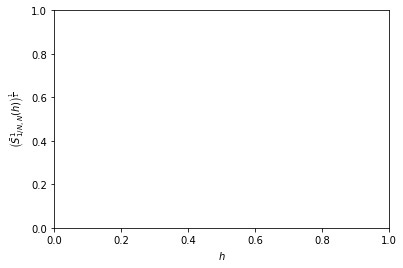

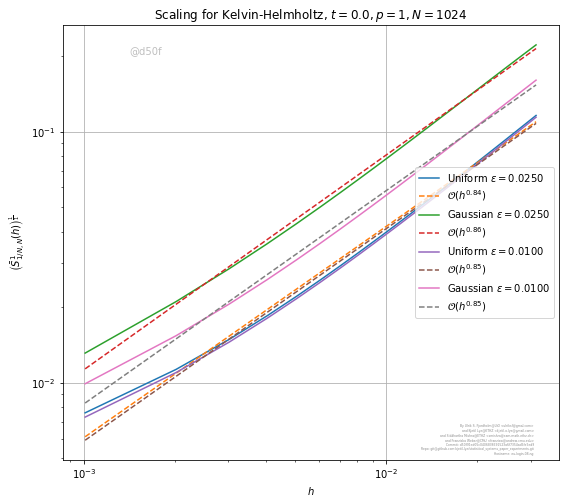

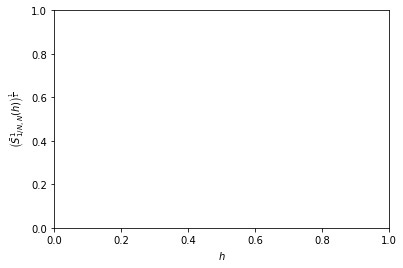

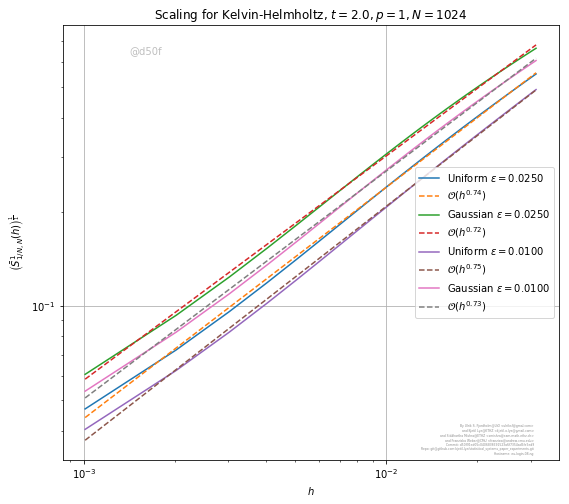

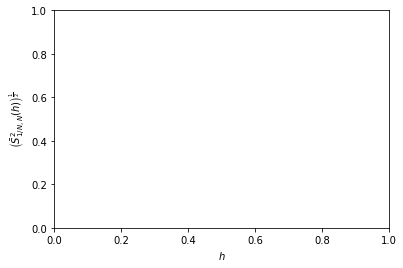

...

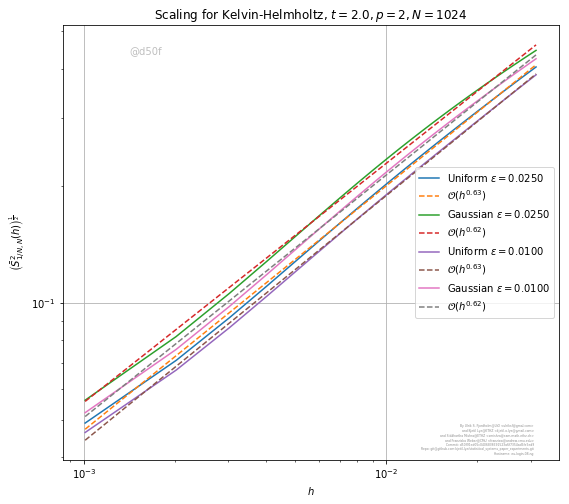

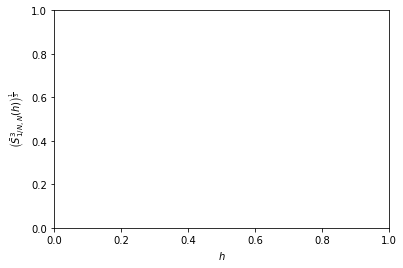

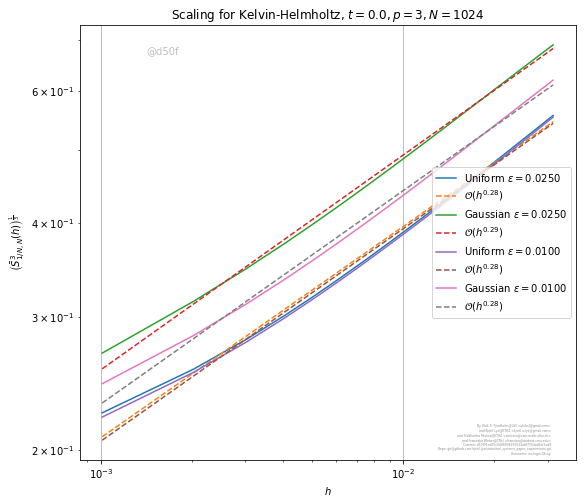

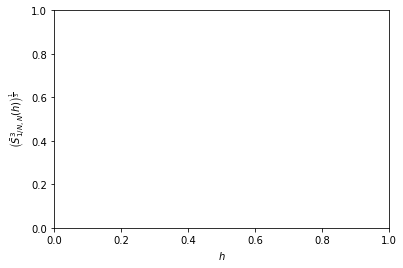

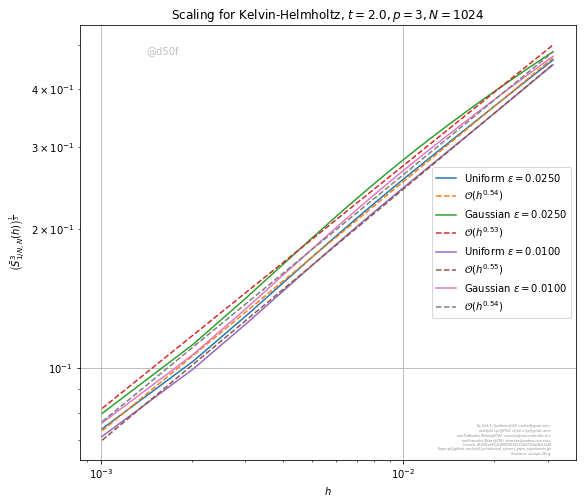

In [7]:
def compare_gaussian_uniform():
    headline("Comparison Gaussian with uniform")
    resolution = 1024
    variables = ['rho', 'mx','my','E']
    maxT=2.
    name='Kelvin-Helmholtz'
    names=['Uniform', 'Gaussian']
    Tarray=[0,1]
    resolutions = [64, 128,256,512,1024]

    perturbations = [ 0.025,0.01 ]
    variables = ['rho','mx','my','E','p','ux','uy']
    cube_filenames = ['kh_euler/kelvinhelmholtz_{perturbation}_{resolution}/kh_cube_structure_cube_{p}.000000_{t}.nc',
                      'kh_gaussian/kelvinhelmholtz_{perturbation}_{resolution}/kh_cube_structure_cube_{p}.000000_{t}.nc']

    for p in [1,2,3]:
        h3("p = %d" % p)
        for t in Tarray:
            h4("t = %d" % (0.2*t))



            for (nr,perturbation) in enumerate(array(perturbations)[:]):
                for n in range(len(cube_filenames)):
                    dVar = zeros((64*resolution)//2048)
                    for variable in variables:
                        cube_filename = cube_filenames[n]
                        filename = cube_filename.format(perturbation = perturbation, p=p,t=t,resolution=resolution)

                        d = getlineintegral(filename, variable, resolution)


                        dVar += d
                    dVar = dVar**(1.0/p)
                   


                    title = 'Scaling for {name}, $t={time},p={p}, N={N}$'.format(N=resolution, name=name,time=t*maxT/float(len(Tarray)-1),p=p)



                    plt.xlabel('$h$')
                    plt.ylabel('$\\left(\\bar{S}^{%d}_{1/N,N}(h)\\right)^{\\frac{1}{%d}}$' % (p,p))



                    plotscalings_perturbation(dVar, perturbation, title, False,name=names[n])
                
            showAndSave('scaling_compare_perturbation_{name}_{p}_{resolution}_{time}'.format(resolution=resolution, name=name.replace('$','').replace(' ',"_").replace('=',''), p=p, time=t))   
compare_gaussian_uniform()

# Comparison WENO, ENO, MC

In [8]:
def compare_weno_eno_mc():
    headline("Comparison WENO, ENO, MC")
    resolutions = [64, 128,256,512,1024]
    resolution = resolutions[len(resolutions)-1]
    variables = ['rho', 'mx','my','E']
    maxT=2.
    name='Kelvin-Helmholtz'
    names=['ENO2', 'WENO2', 'MC']
    Tarray=[0,1]
    

    perturbation =0.05
    variables = ['rho','mx','my','E','p','ux','uy']
    cube_filenames = ['kh_euler/kelvinhelmholtz_0.05_{resolution}/kh_cube_structure_cube_{p}.000000_{t}.nc',
                      'kh_mc/n{resolution}/kh_cube_structure_cube_{p}.000000_{t}.nc',
                     'kh_eno/n{resolution}/kh_cube_structure_cube_{p}.000000_{t}.nc']

    for p in [1,2,3]:
        h3("p = %d" % p)
        for t in Tarray:
            h4("t = %d" % (0.2*t))




            for n in range(len(cube_filenames)):
                dVar = zeros((64*resolution)//2048)
                for variable in variables:
                    cube_filename = cube_filenames[n]
                    filename = cube_filename.format(perturbation = perturbation, p=p,t=t,resolution=resolution)

                    d = getlineintegral(filename, variable, resolution)


                    dVar += d
                dVar = dVar**(1.0/p)
                if perturbation < perturbations[0]:
                    errors[nr-1] = abs(dVar[-1]-dPrev[-1])
                dPrev = dVar


                title = 'Scaling for {name}, $t={time},p={p}, N={N}, \\epsilon={perturbation}$'.format(perturbation=perturbation, N=resolution, name=name,time=t*maxT/float(len(Tarray)-1),p=p)



                plt.xlabel('$h$')
                plt.ylabel('$\\left(\\bar{S}^{%d}_{1/N,N}(h)\\right)^{\\frac{1}{%d}}$' % (p,p))



                plotscalings_perturbation(dVar, perturbation, title, False,name=names[n])

            showAndSave('scaling_compare_schemes_{name}_{p}_{resolution}_{time}'.format(resolution=resolution, name=name.replace('$','').replace(' ',"_").replace('=',''), p=p, time=t))   


# Time Evolution

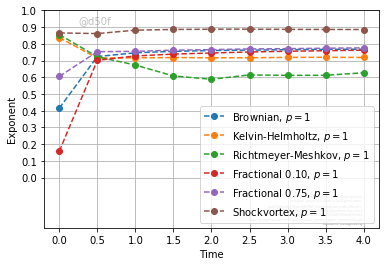

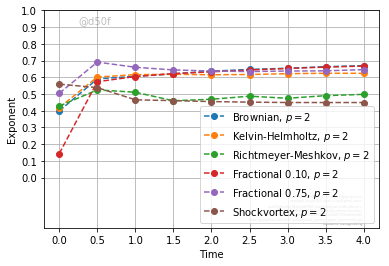

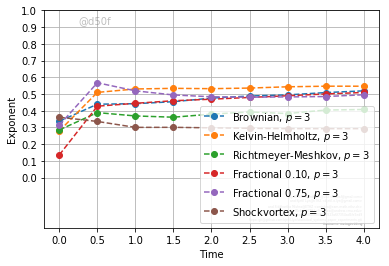

In [9]:
evolutionDatasets = {'Brownian' : {'filename' : 'evolution/brownian/brownianeuler_cube_structure_cube_{p}.000000_{t}.nc',
                                  'nSaves' : 16,
                                  'maxT' : 4},
                    'Kelvin-Helmholtz' : {'filename' : 'evolution/kh/kh_cube_structure_cube_{p}.000000_{t}.nc',
                                  'nSaves' : 8,
                                  'maxT' : 4},
                     'Richtmeyer-Meshkov' : {'filename' : 'evolution/rm/rm_cube_structure_cube_{p}.000000_{t}.nc',
                                  'nSaves' : 8,
                                  'maxT' : 4},
                     'Fractional 0.10' :  {'filename' : 'euler_brownian_010/euler_brownian_1024/brownianeuler_cube_structure_cube_{p}.000000_{t}.nc',
                                  'nSaves' : 16,
                                  'maxT' : 4},
                     'Fractional 0.75' :  {'filename' : 'euler_brownian_075_time/euler_brownian_1024/brownianeuler_cube_structure_cube_{p}.000000_{t}.nc',
                                  'nSaves' : 16,
                                  'maxT' : 4},
                     'Shockvortex' : {'filename' : 'shockvortex/shockvortex_1024/shockvortex_cube_structure_cube_{p}.000000_{t}.nc',
                                  'nSaves' : 16,
                                  'maxT' : 4},
                     
                    }

variables = ['rho','mx','my','E']

P = [1,2,3]
for p in P:
    for name in evolutionDatasets.keys():
    
        exponents = []
        times = []
        nSaves = evolutionDatasets[name]['nSaves']
        for t in range(0, nSaves+1, nSaves//8):
            dVar = zeros(32)
            H = linspace(0,32./1024.,32)
            for variable in variables:
            
                filename = evolutionDatasets[name]['filename'].format(p=p,t=t)
                
                d = getlineintegral(filename, variable, 1024)
                
                
                dVar += d
            dVar = dVar**(1.0/p)
            
            poly = polyfit(log(H[1:]), log(dVar[1:]),1)
            exponents.append(poly[0])
            times.append(t*evolutionDatasets[name]['maxT']/float(nSaves))
            
            
            
        plt.plot(times,exponents, '--o',label='%s, $p=%d$' % (name, p))
    plt.legend()
    plt.grid('on')
    plt.xlabel('Time')
    plt.ylabel('Exponent')
    plt.ylim([-0.3,1])
    plt.yticks(linspace(0,1,11))
    showAndSave('exponent_evolution_%d' % p)
    